In [1]:
from paths import models_folder, metadata_folder

In [2]:
from pyobsbox import ObsBoxGenerator

In [3]:
import logging
import keras
import json
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from tqdm.auto import tqdm

In [4]:
logging.getLogger("pyobsbox").setLevel(logging.INFO)

# List models

In [5]:
list(models_folder.glob('model_*'))

[PosixPath('/afs/cern.ch/work/l/lcoyle/public/obsbox_analysis/models/model_B1H_Inst_20756'),
 PosixPath('/afs/cern.ch/work/l/lcoyle/public/obsbox_analysis/models/model_B1H_Inst_1024'),
 PosixPath('/afs/cern.ch/work/l/lcoyle/public/obsbox_analysis/models/model_B1H_Inst_1'),
 PosixPath('/afs/cern.ch/work/l/lcoyle/public/obsbox_analysis/models/model_B1H_Inst_20608'),
 PosixPath('/afs/cern.ch/work/l/lcoyle/public/obsbox_analysis/models/model_time_dist_32_16_B1H_Inst_500'),
 PosixPath('/afs/cern.ch/work/l/lcoyle/public/obsbox_analysis/models/model_conv_64_8_B1H_Inst_252'),
 PosixPath('/afs/cern.ch/work/l/lcoyle/public/obsbox_analysis/models/model_conv_64_16_8_stride_4_B1H_Inst_253')]

In [6]:
model_path = models_folder / "model_conv_64_16_8_stride_4_B1H_Inst_253"
# For this model I use multiprocessing to train and it broke my "seen indices" 
# I'll be using the train/validation split

# Load model and associated generators

In [7]:
model = keras.models.load_model(model_path)
model.summary()
model_metadata = json.load((model_path / "metadata.json").open('r'))
data_metadata_path = model_metadata["generator"]["metadata_path"]

# load the data metadata
data_metadata_df = pd.read_hdf(data_metadata_path)

# load the indices of the data seen by the model
# train_seen_indices = np.load(model_path / "train_seen_indices.npy")
# validation_seen_indices = np.load(model_path / "validation_seen_indices.npy")

# train/validation split
train_split_indices = np.load(model_path / "train_split_indices.npy")
validation_split_indices = np.load(model_path / "validation_split_indices.npy")

# load the data seen by the model
train_metadata = data_metadata_df.iloc[train_split_indices]
validation_metadata = data_metadata_df.iloc[validation_split_indices]

# the training loss history
hist = model_metadata["history"]

# remove shuffling
model_metadata["generator"]["shuffle"] = True  # True because I don't have the seen values indices
# create the generators
train_generator = ObsBoxGenerator(train_metadata,
                                  **model_metadata["generator"])
validation_generator = ObsBoxGenerator(validation_metadata,
                                       **model_metadata["generator"])

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv1d (Conv1D)              (None, 512, 64)           512       
_________________________________________________________________
dropout (Dropout)            (None, 512, 64)           0         
_________________________________________________________________
conv1d_1 (Conv1D)            (None, 128, 16)           7184      
_________________________________________________________________
dropout_1 (Dropout)          (None, 128, 16)           0         
_________________________________________________________________
conv1d_2 (Conv1D)            (None, 32, 8)             904       
_________________________________________________________________
conv1d_transpose (Conv1DTran (None, 128, 8)            456       
_________________________________________________________________
dropout_2 (Dropout)          (None, 128, 8)            0

Dec/11 15:18:32 pyobsbox.generator INFO: metadata_path: /afs/cern.ch/work/l/lcoyle/public/obsbox_analysis/metadata/metadata_B1H_Inst_34994.h5
Dec/11 15:18:32 pyobsbox.generator INFO: batch_size: 8192
Dec/11 15:18:32 pyobsbox.generator INFO: sequence_length: 2048
Dec/11 15:18:32 pyobsbox.generator INFO: n_bunches: 256
Dec/11 15:18:32 pyobsbox.generator INFO: __len__: 41222
Dec/11 15:18:32 pyobsbox.generator INFO: metadata_path: /afs/cern.ch/work/l/lcoyle/public/obsbox_analysis/metadata/metadata_B1H_Inst_34994.h5
Dec/11 15:18:32 pyobsbox.generator INFO: batch_size: 8192
Dec/11 15:18:32 pyobsbox.generator INFO: sequence_length: 2048
Dec/11 15:18:32 pyobsbox.generator INFO: n_bunches: 256
Dec/11 15:18:32 pyobsbox.generator INFO: __len__: 4581


In [8]:
print(train_metadata.shape)
train_metadata.head()

(10552772, 11)


,type,fill,beam,plane,q,date_time,file,n_bunches,bunch_index,bunch_number,ts_length
1,Inst,7478,1,h,7,2018-11-27 14:49:16,/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7478/...,20,0.0,0.0,65536
2,Inst,7478,1,h,7,2018-11-27 14:49:16,/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7478/...,20,4.0,1.0,65536
3,Inst,7478,1,h,7,2018-11-27 14:49:16,/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7478/...,20,8.0,2.0,65536
4,Inst,7478,1,h,7,2018-11-27 14:49:16,/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7478/...,20,12.0,3.0,65536
5,Inst,7478,1,h,7,2018-11-27 14:49:16,/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7478/...,20,894.0,4.0,65536


In [16]:
# print(validation_metadata.shape)
# validation_metadata.head()

(1172530, 11)


,type,fill,beam,plane,q,date_time,file,n_bunches,bunch_index,bunch_number,ts_length
9798719,Inst,6654,1,h,7,2018-05-07 23:42:13,/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6654/...,2556,861.0,609.0,65536
4498831,Inst,7031,1,h,7,2018-08-06 20:13:15,/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7031/...,2556,935.0,671.0,65536
6435289,Inst,6706,1,h,7,2018-05-20 09:55:14,/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6706/...,987,2943.0,825.0,65536
8040237,Inst,7488,1,h,7,2018-12-01 06:14:17,/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7488/...,271,112.0,20.0,65536
10958736,Inst,6961,1,h,7,2018-07-23 04:45:22,/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6961/...,2556,2826.0,2104.0,65536


# Loss functions

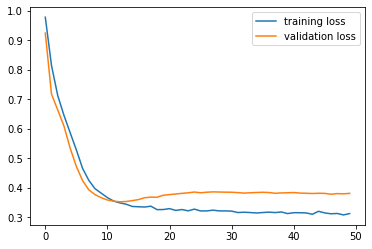

In [9]:
plt.plot(hist['loss'], label='training loss')
plt.plot(hist['val_loss'], label='validation loss')
plt.legend()

# Datasets

Load the first few batches

In [10]:
train_dataset = np.vstack([train_generator[i][0] for i in tqdm(range(50))])
train_dataset.shape

(409600, 2048, 1)

In [19]:
# validation_dataset = np.vstack([validation_generator[i][0] for i in tqdm(range(5))])
# validation_dataset.shape

(81920, 2048, 1)

# Predictions

In [11]:
train_pred = model.predict(train_dataset, verbose=1, batch_size=train_generator.batch_size)
train_pred.shape

50/50 [==============================] - 67s 1s/step


(409600, 2048, 1)

In [21]:
# validation_pred = model.predict(validation_dataset, verbose=1, batch_size=validation_generator.batch_size)
# validation_pred.shape

5/5 [==============================] - 6s 1s/step


(81920, 2048, 1)

In [12]:
MAE_train = abs(train_pred - train_dataset).mean(axis=1).squeeze()
MAE_train.shape

(409600,)

In [13]:
# MAE_validation = abs(validation_pred - validation_dataset).mean(axis=1).squeeze()
# MAE_validation.shape

NameError: name 'validation_pred' is not defined

Text(0.5, 1.0, 'train dataset')

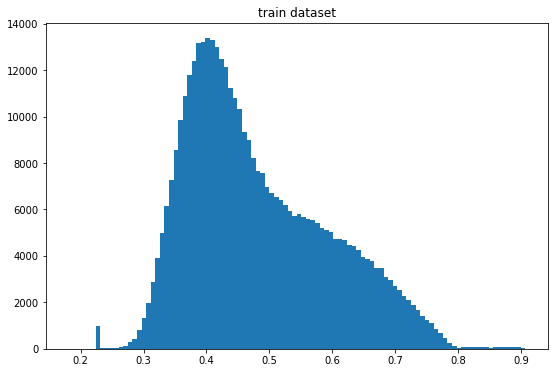

In [14]:
plt.figure(figsize=(9, 6))
n, bins, _ = plt.hist(MAE_train, bins=100)
plt.title("train dataset")
# plt.yscale('log')

rough peak

In [15]:
hist_peak_train = bins[n.argmax()]
hist_peak_train

0.39841095119924386

In [ ]:
# plt.figure(figsize=(9, 6))
# n, bins, _ = plt.hist(MAE_validation, bins=100)
# plt.title("validation dataset")

In [31]:
# hist_peak_validation = bins[n.argmax()]
# hist_peak_validation

0.02259999751852111

In [16]:
max_MAE_indices = np.argsort(MAE_train)[::-1]

In [17]:
max_MAE_indices

array([108673, 382214, 113935, ...,  91872,  12298, 190484])

In [18]:
def plot_true_pred(true_signal, pred_signal):
    fig, axes = plt.subplots(2, figsize=(16, 6))
    axes[0].plot(true_signal)
    axes[0].plot(pred_signal)

    axes[1].plot(np.abs(np.diff(true_signal)))
    axes[1].plot(np.abs(np.diff(pred_signal)))
    return fig, axes

index:  108673
MAE:  0.9060536405529371
n_bunches       324
bunch_index     962
bunch_number    138
Name: 3748, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7229/instability_data/07229_Inst_B1H_Q7_20180928_08h38m14s.h5


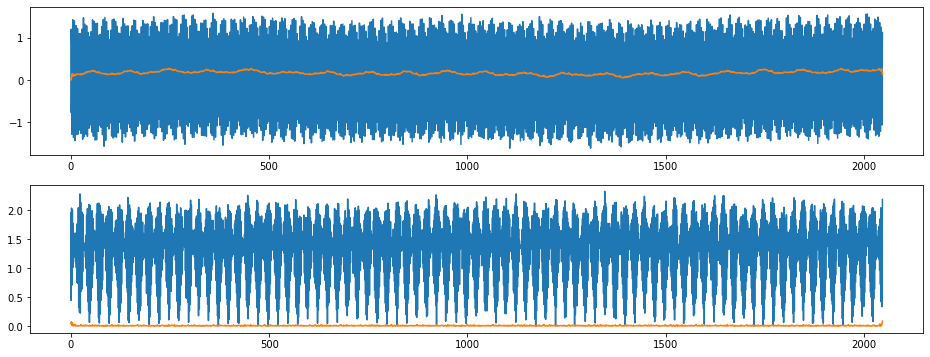

In [19]:
anomalous = 0
anomalous_index = max_MAE_indices[anomalous]

print('index: ', anomalous_index)
print("MAE: ", MAE_train[anomalous_index])
# I'm not sure this row is correct
metadata_row = train_generator.metadata.iloc[anomalous_index // 32]
print(metadata_row[['n_bunches', 'bunch_index', 'bunch_number']])
print(metadata_row['file'])

true_signal = train_dataset[anomalous_index].squeeze()
pred_signal = train_pred[anomalous_index].squeeze()

plot_true_pred(true_signal, pred_signal);

# Top rightmost signals

index:  108673
MAE:  0.9060536405529371
n_bunches       324
bunch_index     962
bunch_number    138
Name: 3748, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7229/instability_data/07229_Inst_B1H_Q7_20180928_08h38m14s.h5


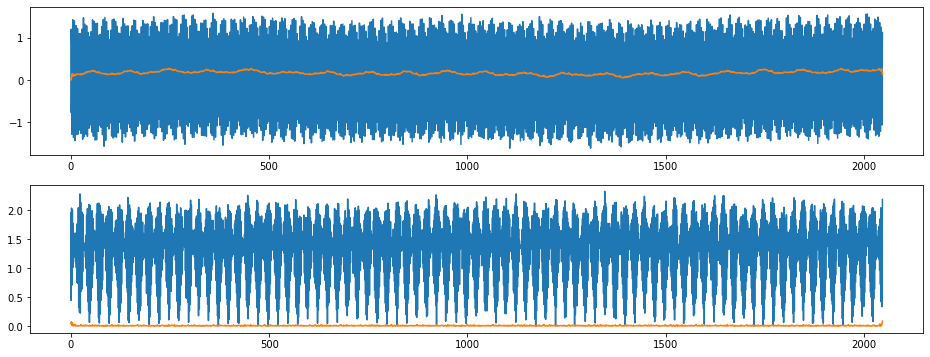

index:  382214
MAE:  0.9050993678200548
n_bunches       636
bunch_index     529
bunch_number    383
Name: 13257, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7037/instability_data/07037_Inst_B1H_Q7_20180808_02h43m34s.h5


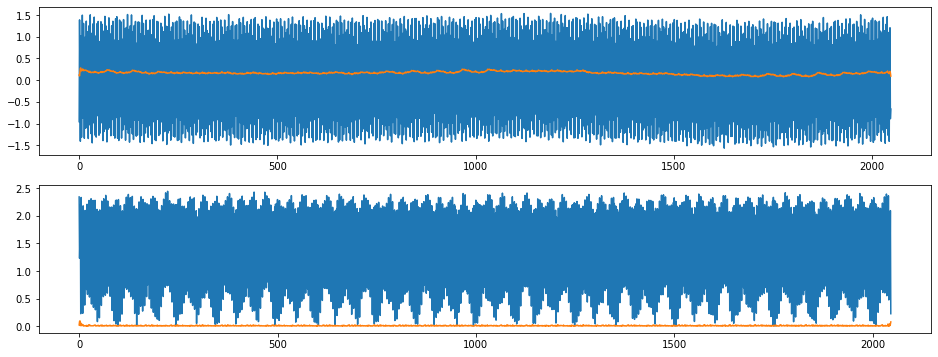

index:  113935
MAE:  0.9048940985846093
n_bunches        324
bunch_index     2485
bunch_number     320
Name: 3930, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7229/instability_data/07229_Inst_B1H_Q7_20180928_08h38m14s.h5


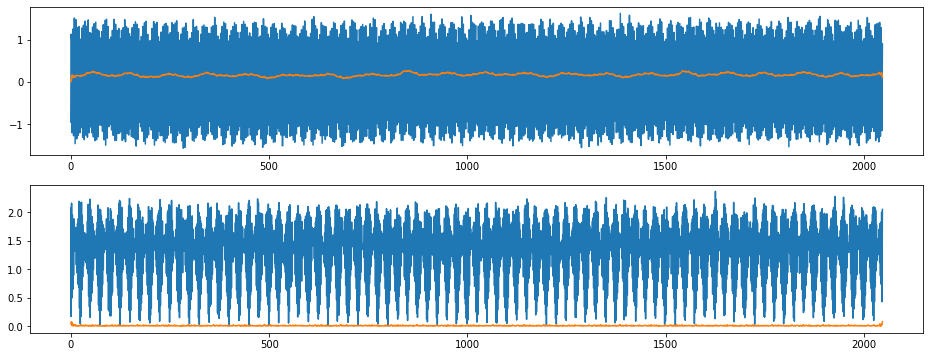

index:  37160
MAE:  0.904780332957093
n_bunches       733
bunch_index     443
bunch_number     90
Name: 1275, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


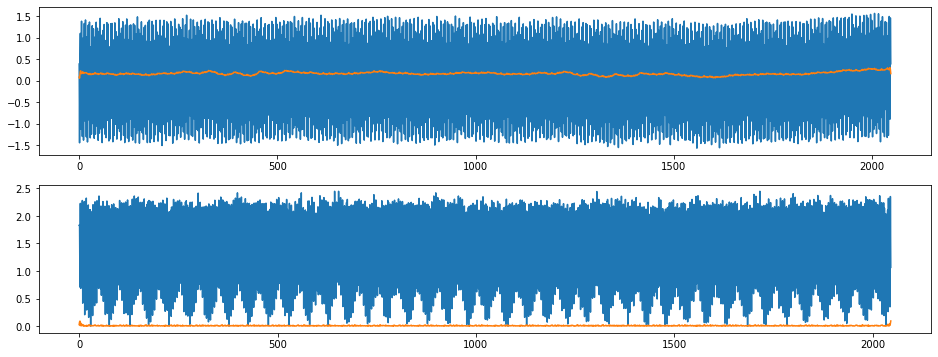

index:  380168
MAE:  0.904574424645753
n_bunches       636
bunch_index     452
bunch_number    313
Name: 13187, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7037/instability_data/07037_Inst_B1H_Q7_20180808_02h43m34s.h5


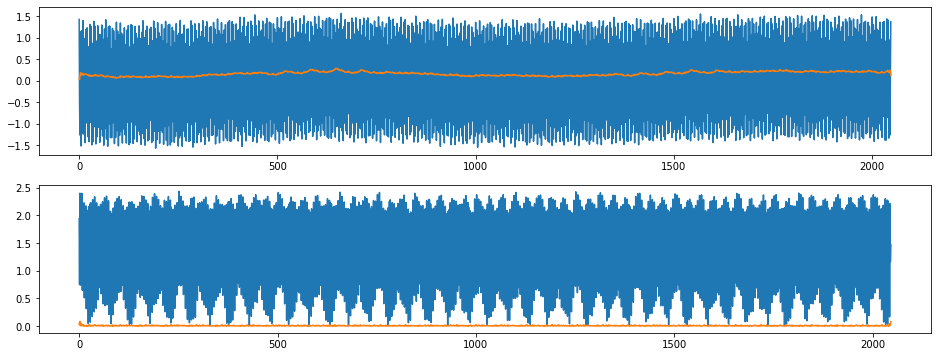

index:  281208
MAE:  0.9042079083698784
n_bunches       648
bunch_index     495
bunch_number     89
Name: 9758, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7446/instability_data/07446_Inst_B1H_Q7_20181116_02h46m18s.h5


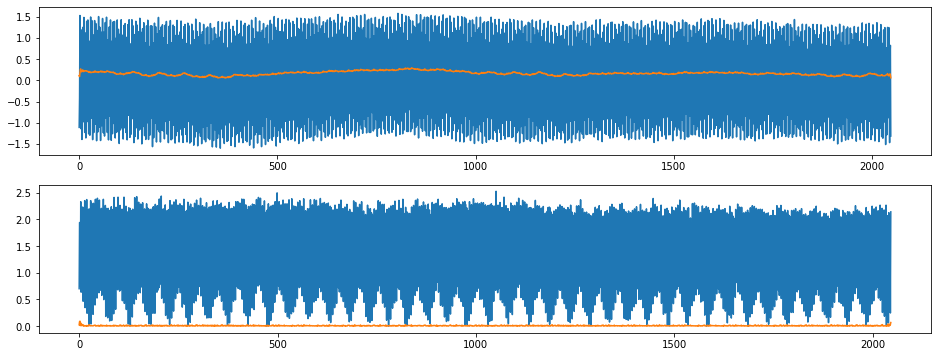

index:  107199
MAE:  0.9038818794441554
n_bunches       324
bunch_index     433
bunch_number     83
Name: 3693, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7229/instability_data/07229_Inst_B1H_Q7_20180928_08h38m14s.h5


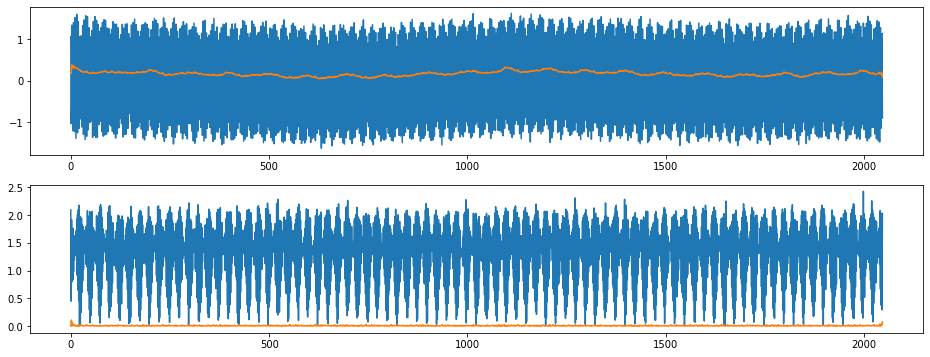

index:  377992
MAE:  0.9038137501626677
n_bunches       636
bunch_index     341
bunch_number    240
Name: 13114, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7037/instability_data/07037_Inst_B1H_Q7_20180808_02h43m34s.h5


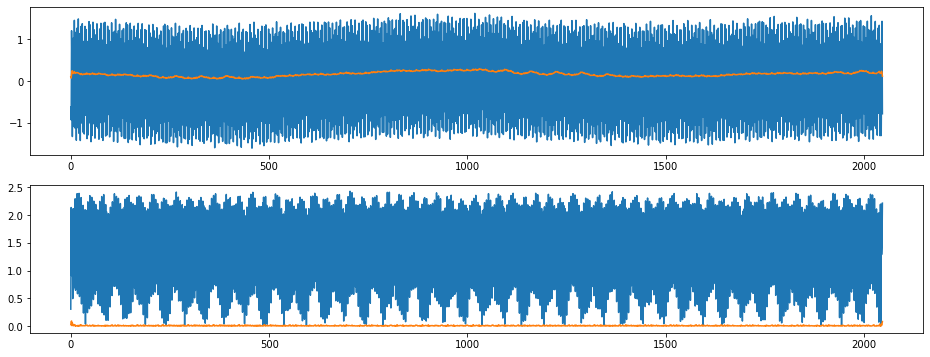

index:  98025
MAE:  0.90220767218443
n_bunches        418
bunch_index     1466
bunch_number     312
Name: 3382, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7481/instability_data/07481_Inst_B1H_Q7_20181128_09h48m56s.h5


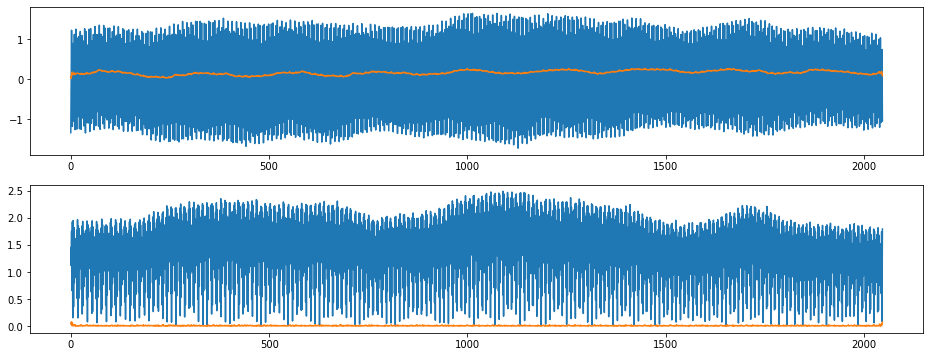

index:  50434
MAE:  0.9015336099439465
n_bunches        733
bunch_index     2639
bunch_number     557
Name: 1742, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


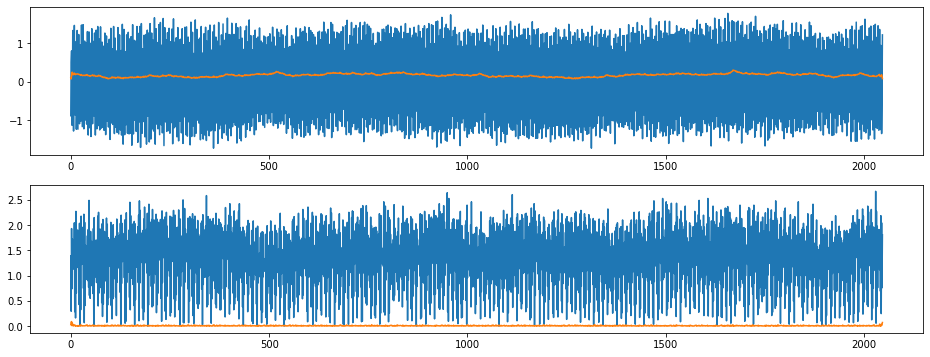

index:  280678
MAE:  0.901195651530278
n_bunches       648
bunch_index     419
bunch_number     72
Name: 9741, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7446/instability_data/07446_Inst_B1H_Q7_20181116_02h46m18s.h5


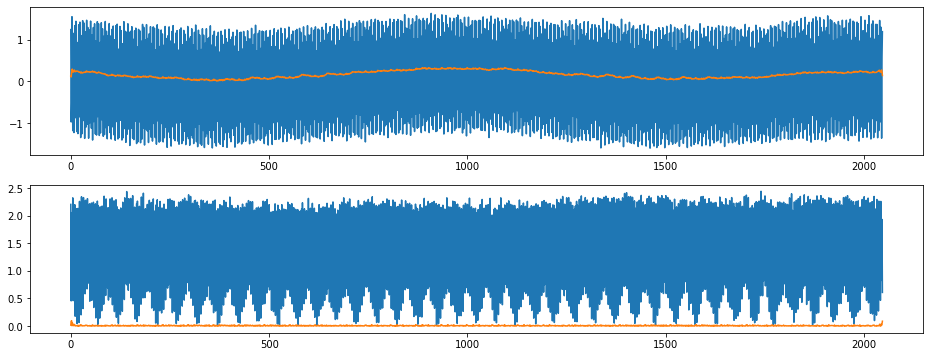

index:  290028
MAE:  0.9010261498353989
n_bunches        648
bunch_index     2121
bunch_number     396
Name: 10065, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7446/instability_data/07446_Inst_B1H_Q7_20181116_02h46m18s.h5


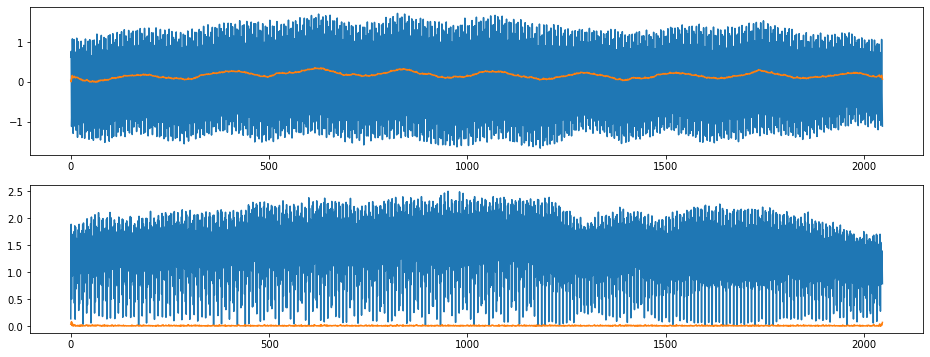

index:  51998
MAE:  0.9008842119624529
n_bunches        733
bunch_index     2910
bunch_number     612
Name: 1797, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


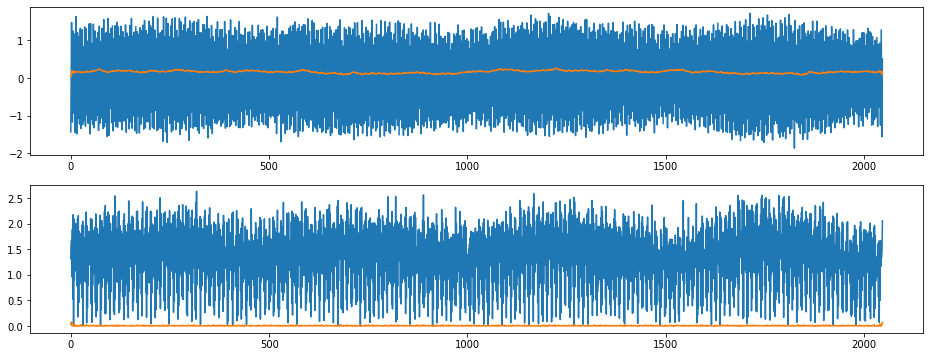

index:  174894
MAE:  0.9008672688443635
n_bunches       1227
bunch_index      167
bunch_number      43
Name: 6041, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_11h45m14s.h5


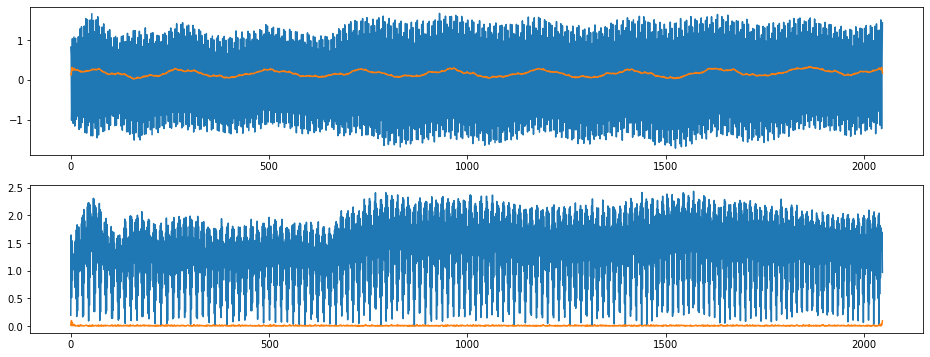

index:  34871
MAE:  0.9008635991730439
n_bunches       733
bunch_index      79
bunch_number     12
Name: 1197, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


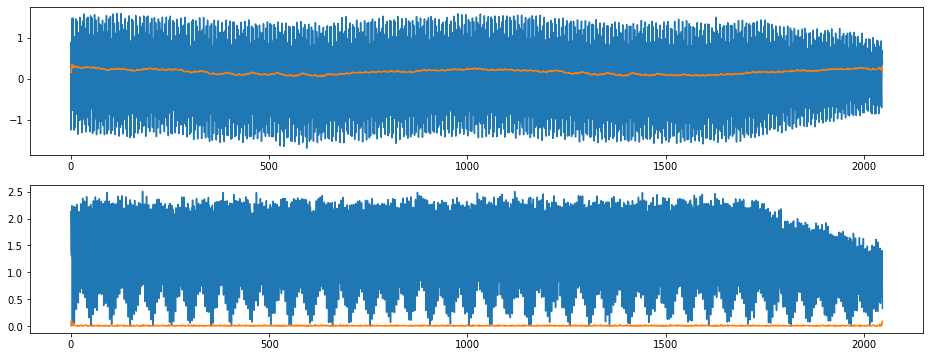

index:  54040
MAE:  0.9008400668889911
n_bunches        733
bunch_index     3224
bunch_number     684
Name: 1869, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


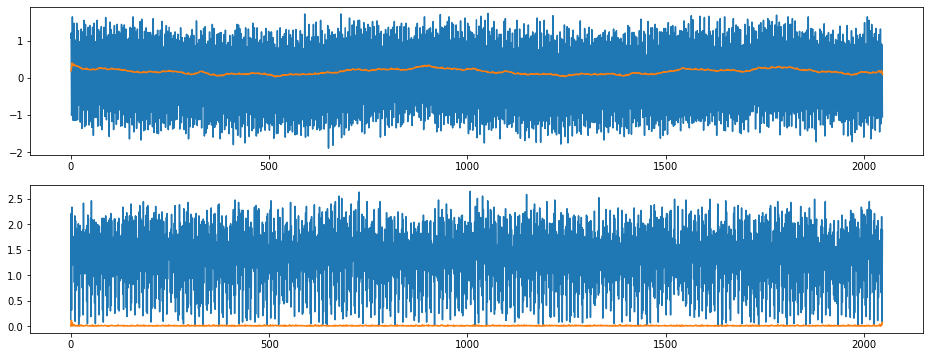

index:  53957
MAE:  0.9007681173219062
n_bunches        733
bunch_index     3218
bunch_number     682
Name: 1867, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


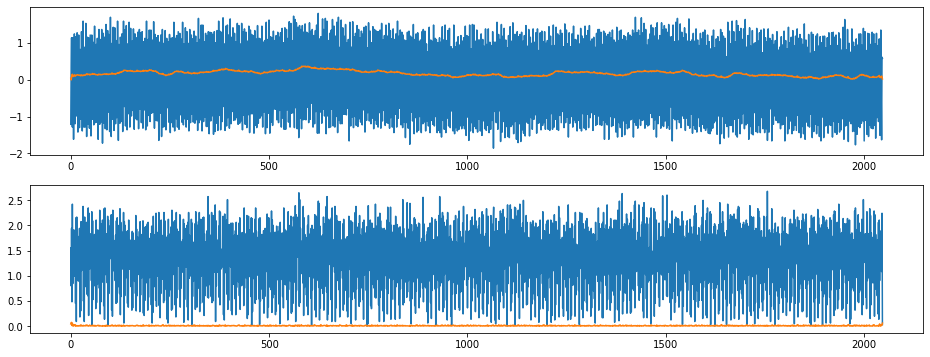

index:  55103
MAE:  0.9007177793459403
n_bunches        733
bunch_index     3391
bunch_number     719
Name: 1904, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


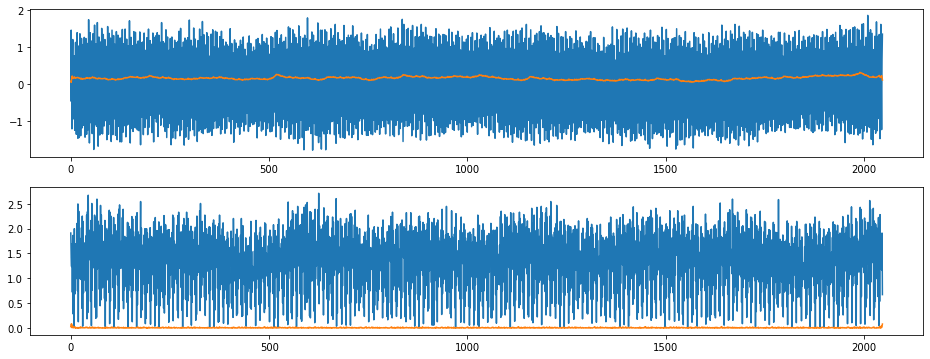

index:  51931
MAE:  0.9006461456858432
n_bunches        733
bunch_index     2904
bunch_number     610
Name: 1795, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


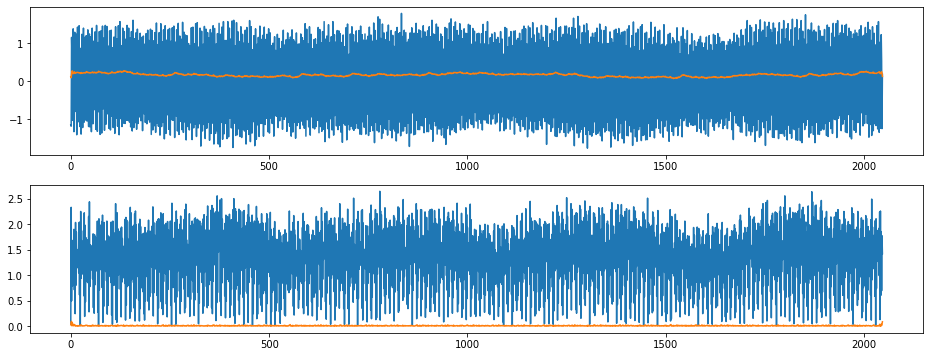

index:  218938
MAE:  0.9004595627930845
n_bunches        987
bunch_index     1150
bunch_number     338
Name: 7566, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6706/instability_data/06706_Inst_B1H_Q7_20180520_12h23m14s.h5


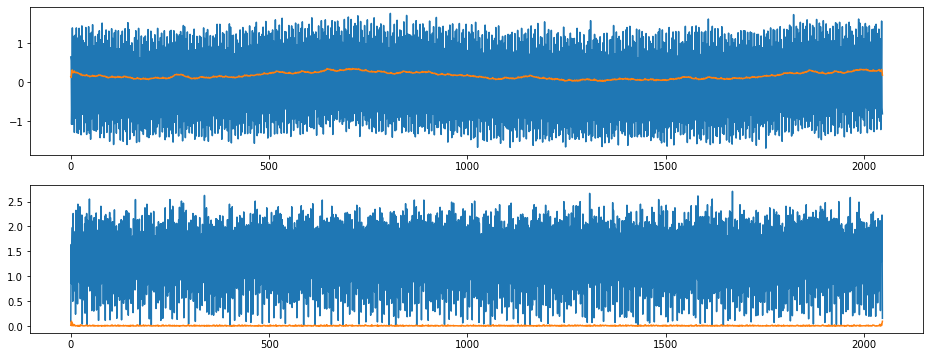

index:  54750
MAE:  0.9002532989138929
n_bunches        733
bunch_index     3346
bunch_number     708
Name: 1893, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


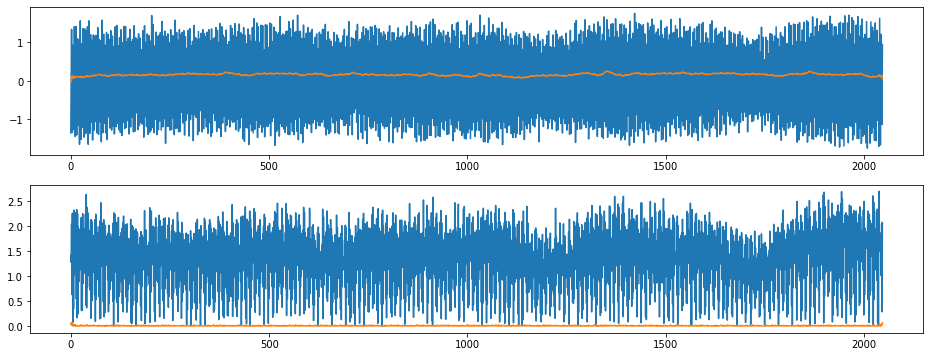

index:  162558
MAE:  0.9001713742065527
n_bunches       684
bunch_index     573
bunch_number    304
Name: 5618, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6247/instability_data/06247_Inst_B1H_Q7_20170927_07h40m43s.h5


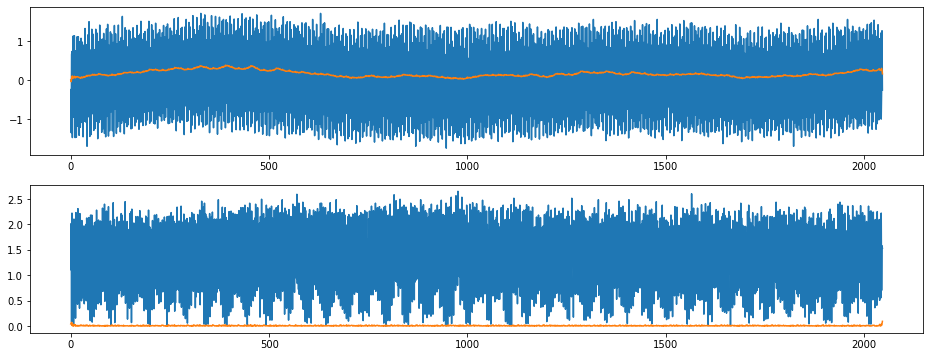

index:  55921
MAE:  0.9001265399728393
n_bunches       444
bunch_index     199
bunch_number     16
Name: 1934, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6990/instability_data/06990_Inst_B1H_Q7_20180727_09h47m15s.h5


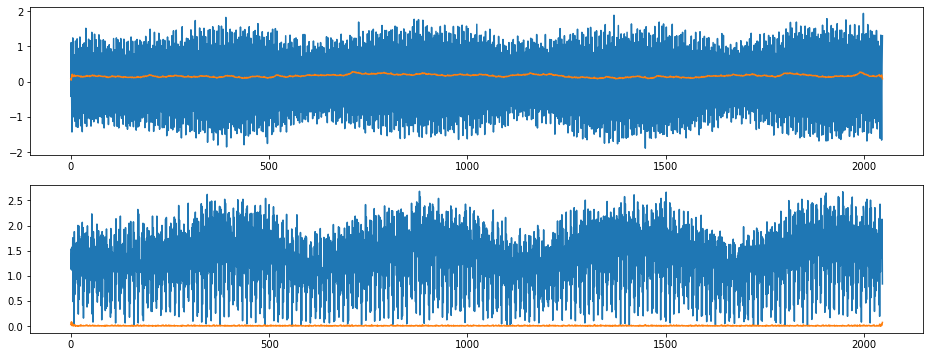

index:  286389
MAE:  0.900030435423385
n_bunches        648
bunch_index     1430
bunch_number     267
Name: 9936, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7446/instability_data/07446_Inst_B1H_Q7_20181116_02h46m18s.h5


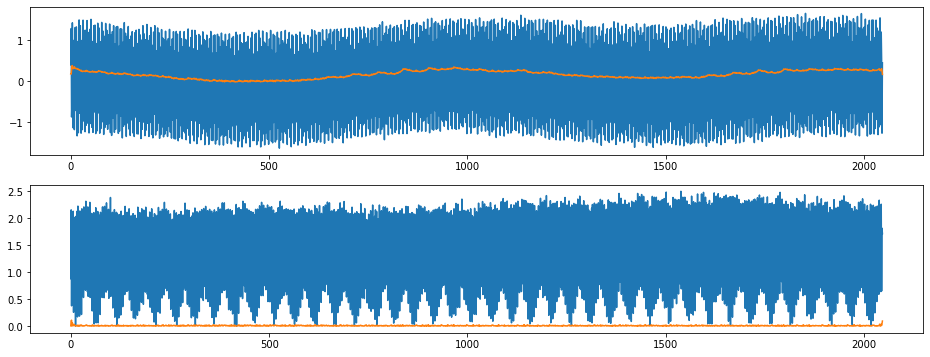

index:  55959
MAE:  0.8994451054090895
n_bunches       444
bunch_index     200
bunch_number     17
Name: 1935, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6990/instability_data/06990_Inst_B1H_Q7_20180727_09h47m15s.h5


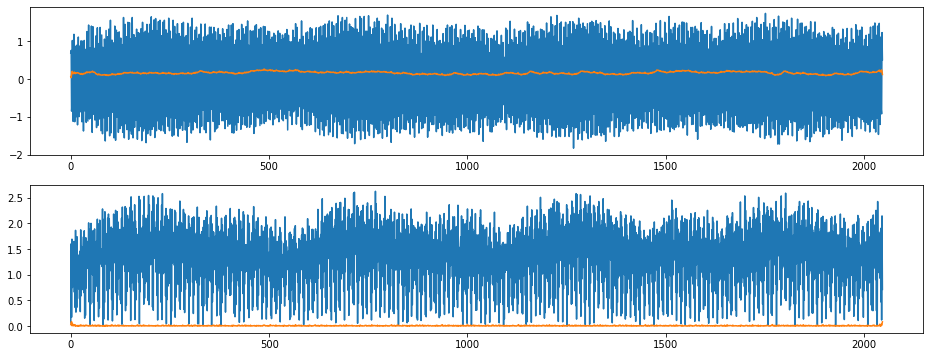

index:  54518
MAE:  0.8993129967306632
n_bunches        733
bunch_index     3319
bunch_number     701
Name: 1886, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


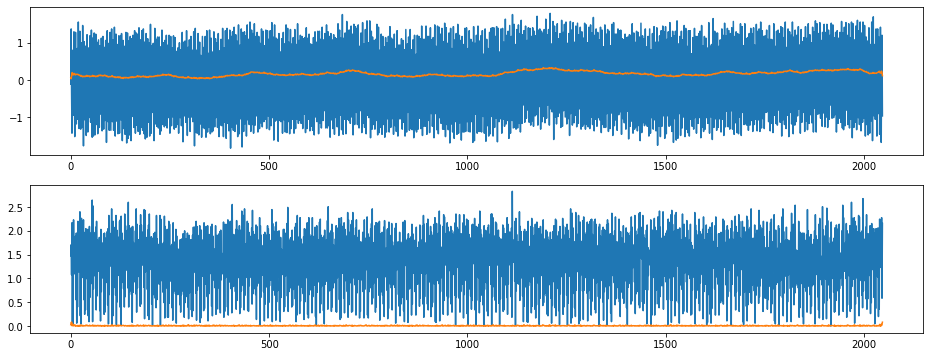

index:  56811
MAE:  0.899141693478134
n_bunches       444
bunch_index     228
bunch_number     45
Name: 1963, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6990/instability_data/06990_Inst_B1H_Q7_20180727_09h47m15s.h5


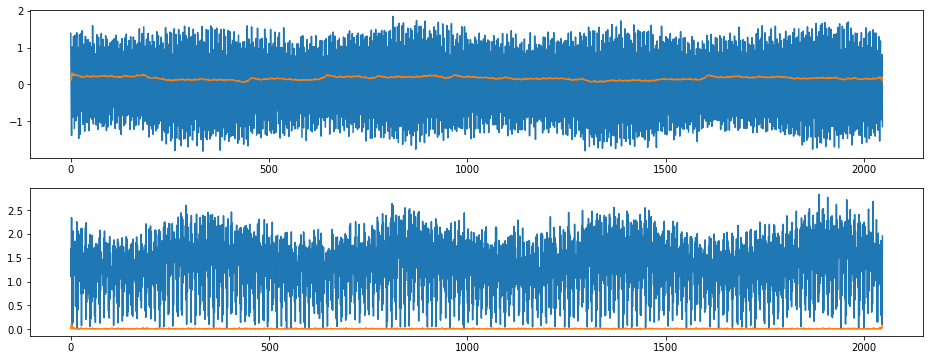

index:  55465
MAE:  0.8989484005727314
n_bunches       444
bunch_index      18
bunch_number      0
Name: 1918, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6990/instability_data/06990_Inst_B1H_Q7_20180727_09h47m15s.h5


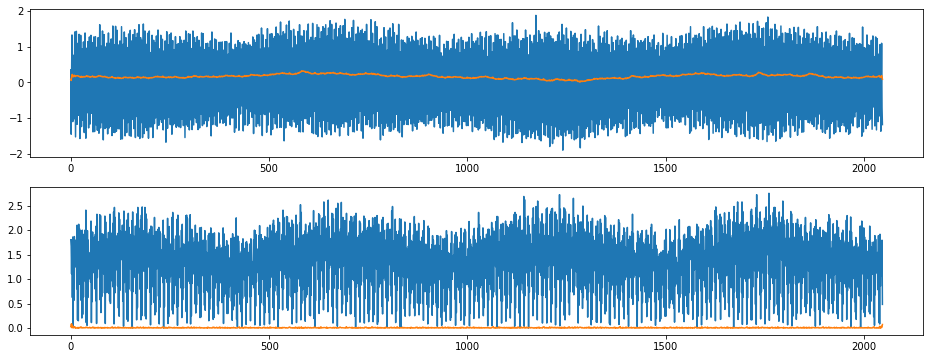

index:  95832
MAE:  0.8989168281042743
n_bunches        418
bunch_index     1152
bunch_number     240
Name: 3310, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7481/instability_data/07481_Inst_B1H_Q7_20181128_09h48m56s.h5


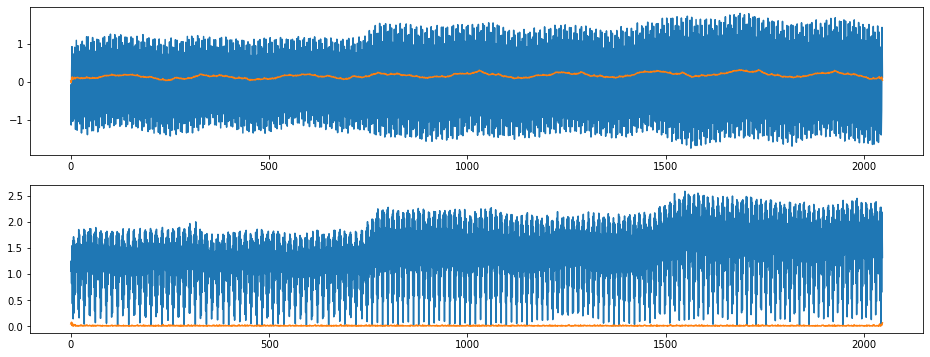

index:  56136
MAE:  0.8986990081965793
n_bunches       444
bunch_index     207
bunch_number     24
Name: 1942, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6990/instability_data/06990_Inst_B1H_Q7_20180727_09h47m15s.h5


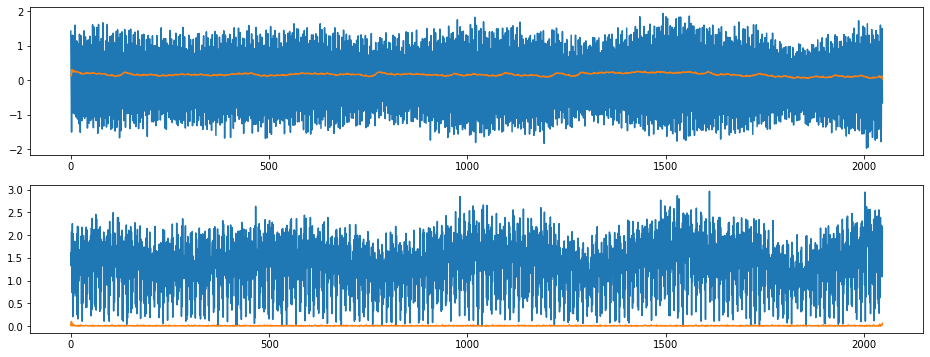

index:  90335
MAE:  0.8985819188634153
n_bunches       418
bunch_index     267
bunch_number     52
Name: 3122, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7481/instability_data/07481_Inst_B1H_Q7_20181128_09h48m56s.h5


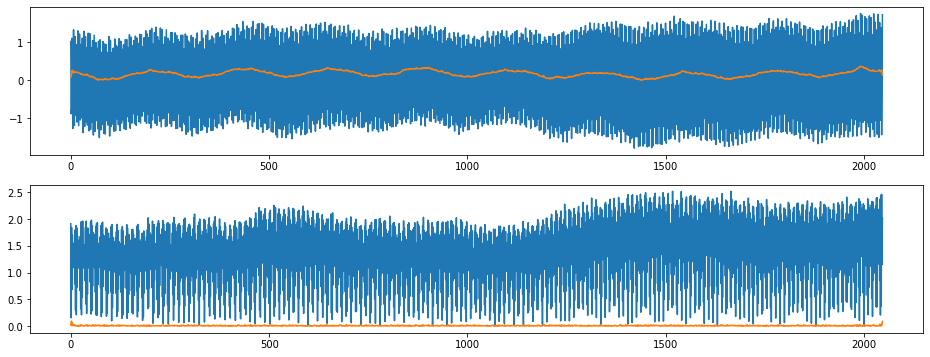

index:  385579
MAE:  0.8981140428221834
n_bunches       636
bunch_index     691
bunch_number    500
Name: 13374, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7037/instability_data/07037_Inst_B1H_Q7_20180808_02h43m34s.h5


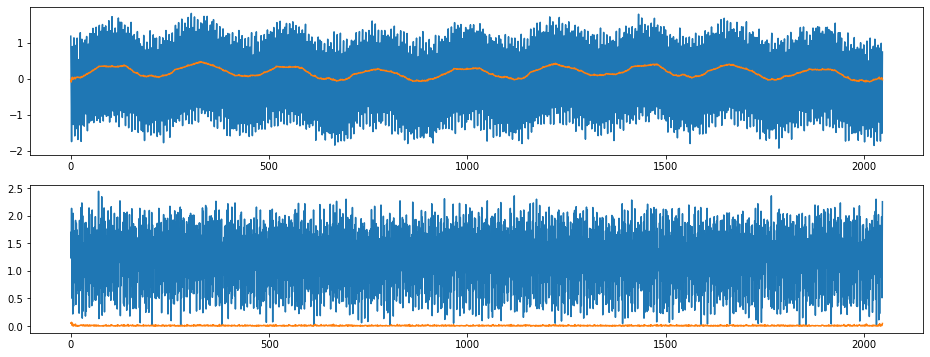

index:  49923
MAE:  0.8978091327678369
n_bunches        733
bunch_index     2536
bunch_number     539
Name: 1724, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


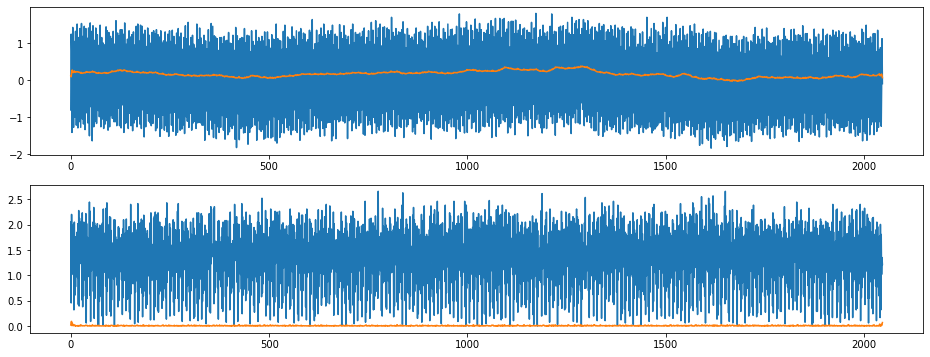

index:  27605
MAE:  0.8977690279592654
n_bunches        972
bunch_index     1387
bunch_number     734
Name: 947, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6272/instability_data/06272_Inst_B1H_Q7_20171005_01h30m07s.h5


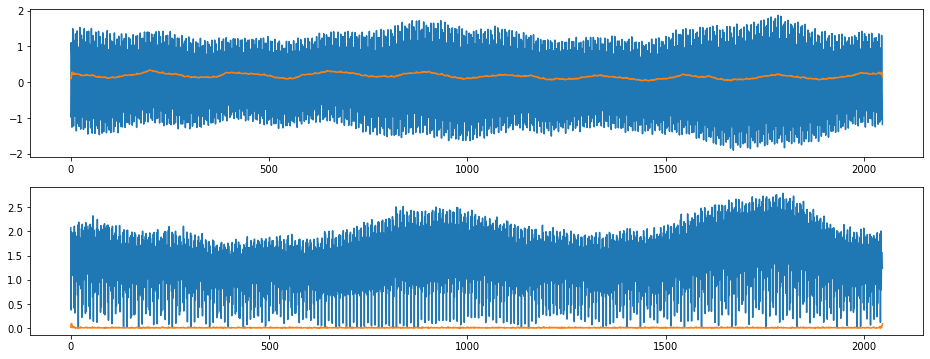

index:  282850
MAE:  0.8977645993255854
n_bunches       648
bunch_index     813
bunch_number    148
Name: 9817, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7446/instability_data/07446_Inst_B1H_Q7_20181116_02h46m18s.h5


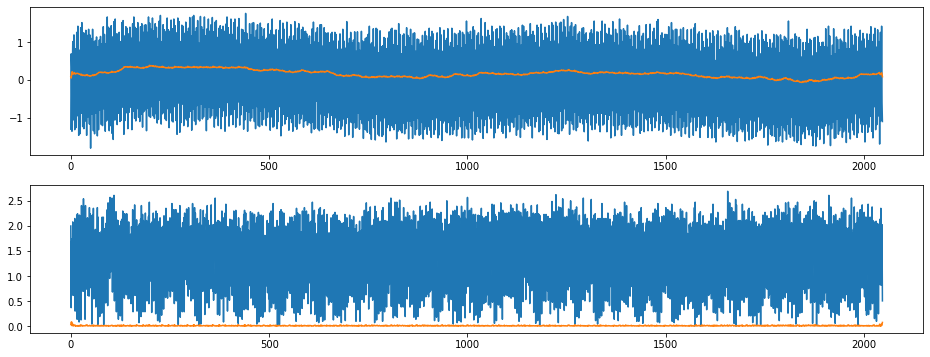

index:  53487
MAE:  0.8977200696976265
n_bunches        733
bunch_index     3146
bunch_number     664
Name: 1849, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


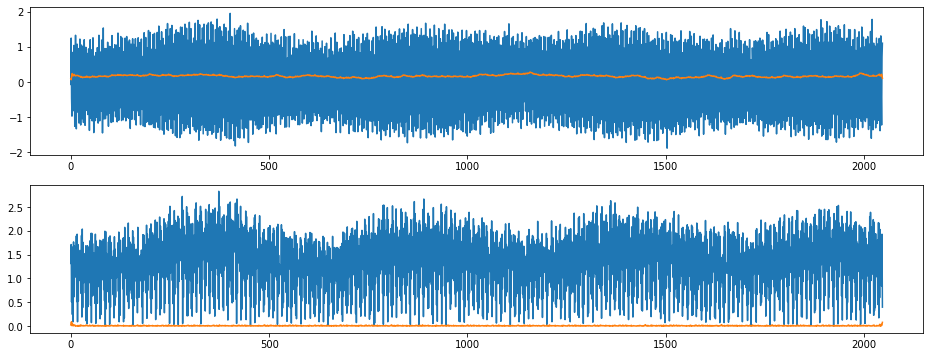

index:  160708
MAE:  0.8975242242588339
n_bunches       684
bunch_index     448
bunch_number    238
Name: 5552, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6247/instability_data/06247_Inst_B1H_Q7_20170927_07h40m43s.h5


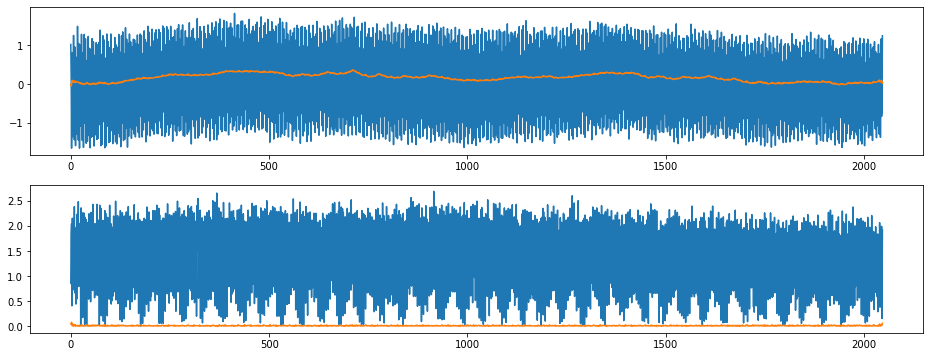

index:  391267
MAE:  0.8972547182798141
n_bunches       396
bunch_index     118
bunch_number     62
Name: 13572, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7122/instability_data/07122_Inst_B1H_Q7_20180903_07h29m11s.h5


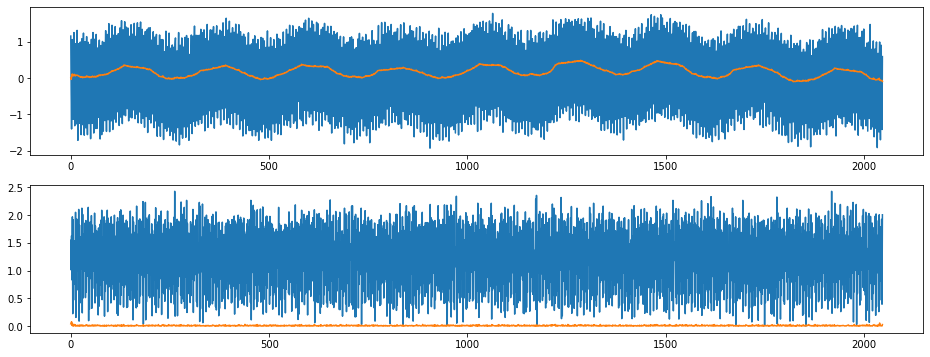

index:  283340
MAE:  0.8972381341496014
n_bunches       648
bunch_index     889
bunch_number    165
Name: 9834, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7446/instability_data/07446_Inst_B1H_Q7_20181116_02h46m18s.h5


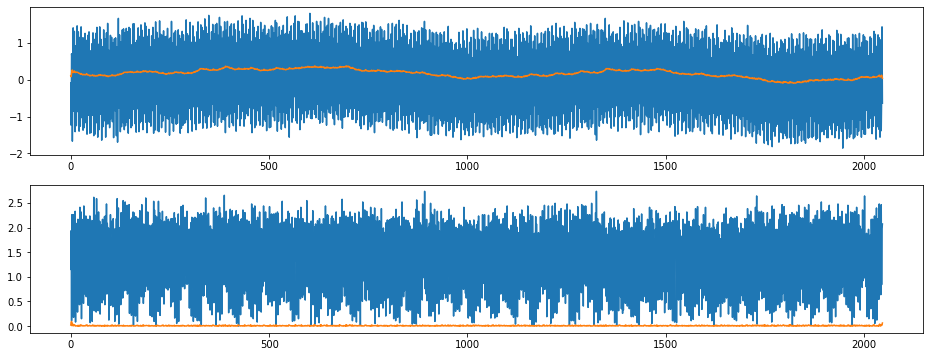

index:  52521
MAE:  0.8970516024617714
n_bunches        733
bunch_index     2982
bunch_number     630
Name: 1815, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


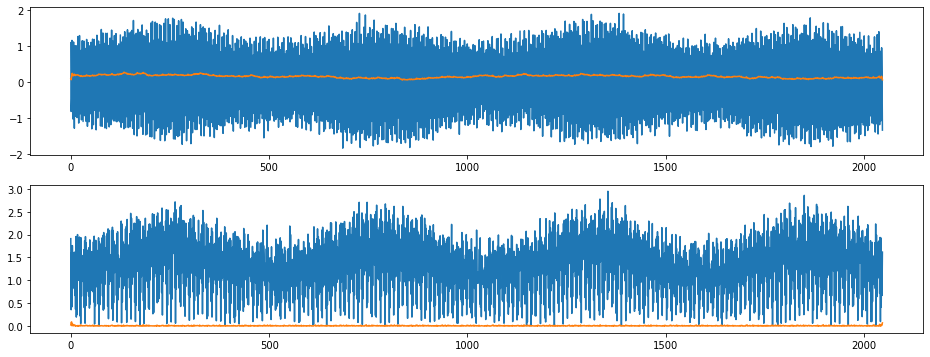

index:  49261
MAE:  0.8969498611241196
n_bunches        733
bunch_index     2431
bunch_number     513
Name: 1698, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


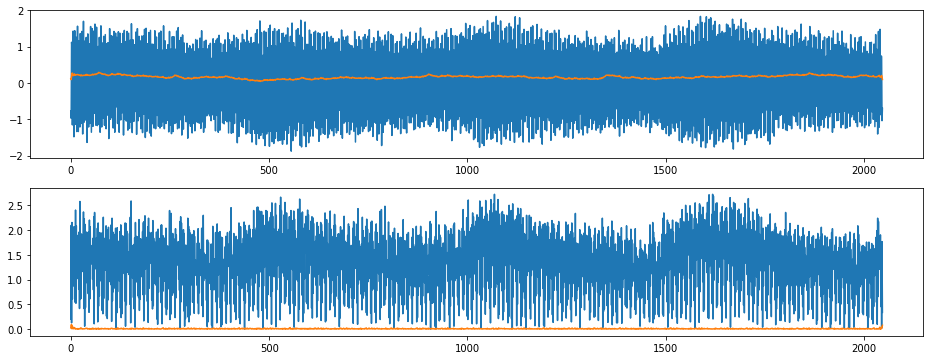

index:  52288
MAE:  0.8968771253819094
n_bunches        733
bunch_index     2955
bunch_number     623
Name: 1808, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


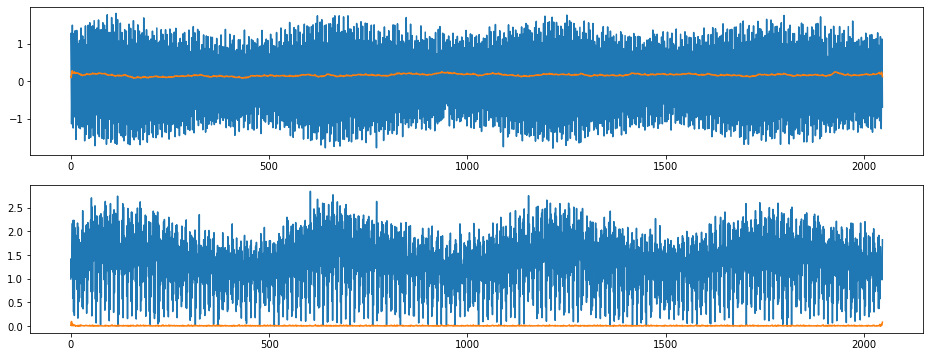

index:  56088
MAE:  0.8967362991107389
n_bunches       444
bunch_index     205
bunch_number     22
Name: 1940, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6990/instability_data/06990_Inst_B1H_Q7_20180727_09h47m15s.h5


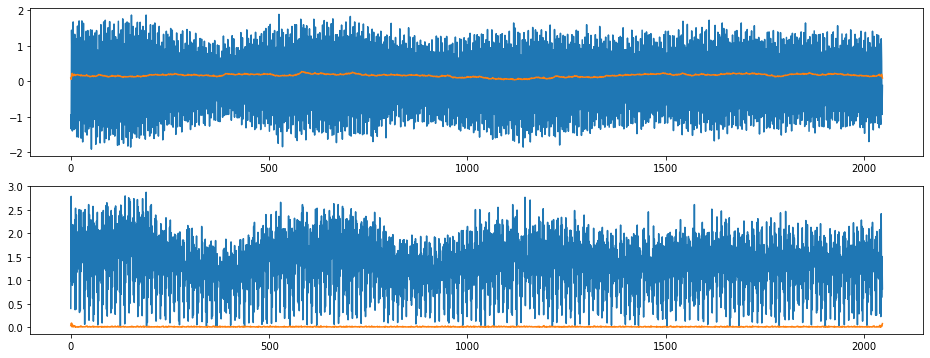

index:  387887
MAE:  0.8964639782203357
n_bunches       636
bunch_index     809
bunch_number    583
Name: 13457, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7037/instability_data/07037_Inst_B1H_Q7_20180808_02h43m34s.h5


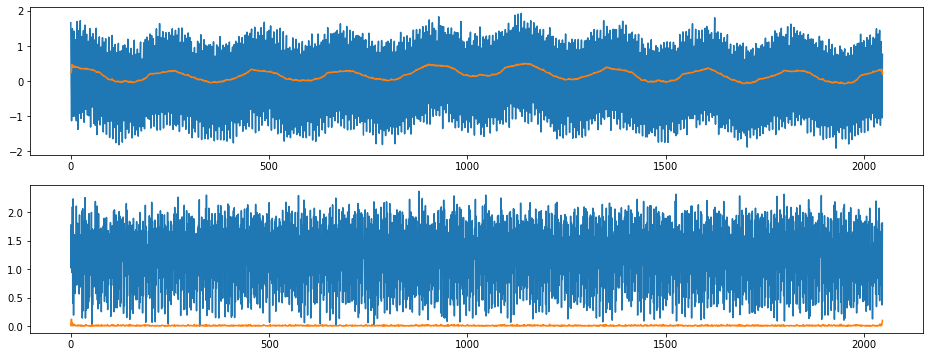

index:  40323
MAE:  0.8963679417519934
n_bunches       733
bunch_index     979
bunch_number    203
Name: 1388, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


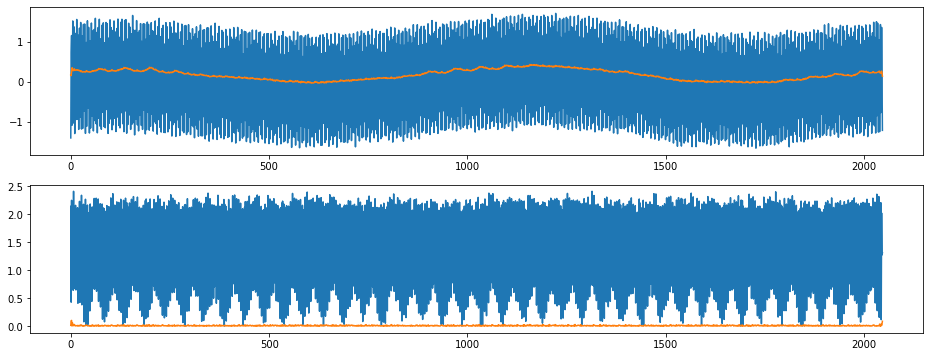

index:  53246
MAE:  0.8958159199165834
n_bunches        733
bunch_index     3110
bunch_number     655
Name: 1840, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


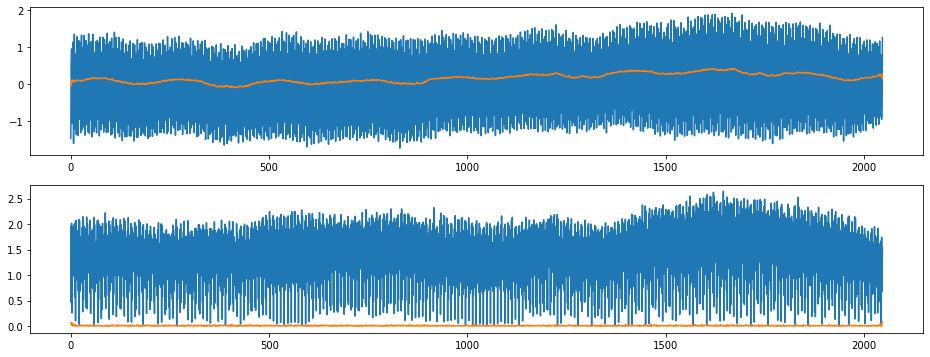

index:  27112
MAE:  0.8957615234444136
n_bunches        972
bunch_index     1362
bunch_number     717
Name: 930, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6272/instability_data/06272_Inst_B1H_Q7_20171005_01h30m07s.h5


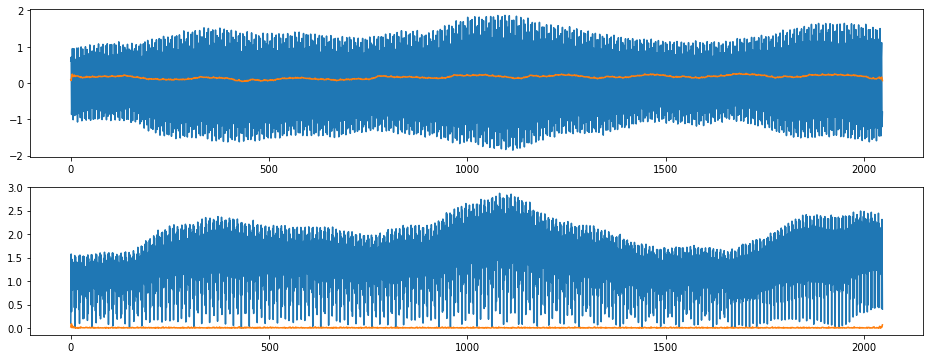

index:  391615
MAE:  0.8956502077242874
n_bunches       396
bunch_index     132
bunch_number     76
Name: 13586, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7122/instability_data/07122_Inst_B1H_Q7_20180903_07h29m11s.h5


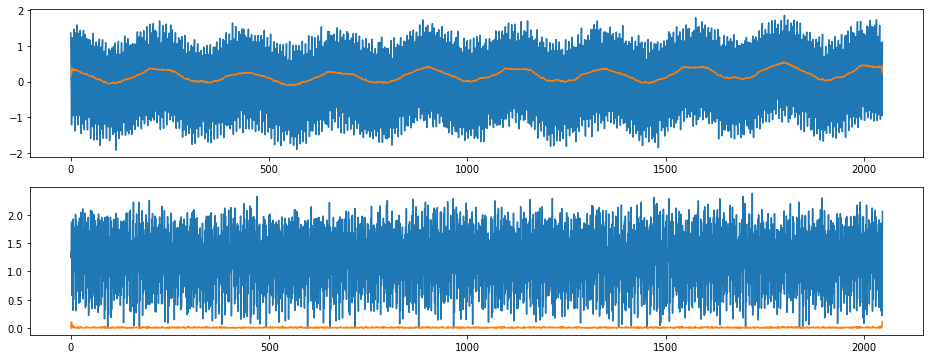

index:  37917
MAE:  0.8956209608632025
n_bunches       733
bunch_index     545
bunch_number    115
Name: 1300, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


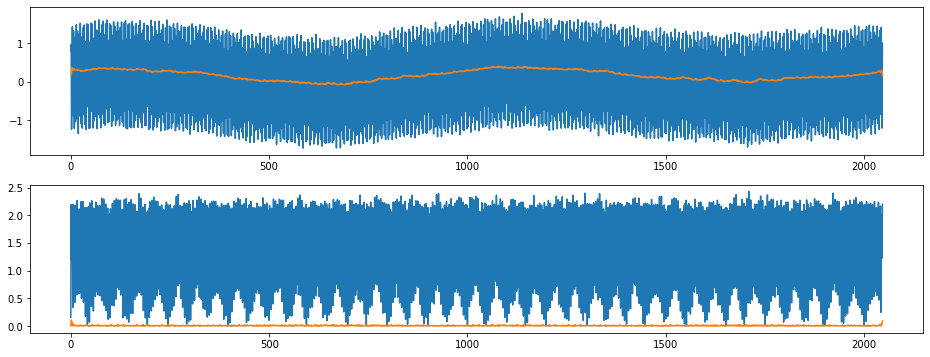

index:  390688
MAE:  0.895488922155149
n_bunches       396
bunch_index      91
bunch_number     42
Name: 13552, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7122/instability_data/07122_Inst_B1H_Q7_20180903_07h29m11s.h5


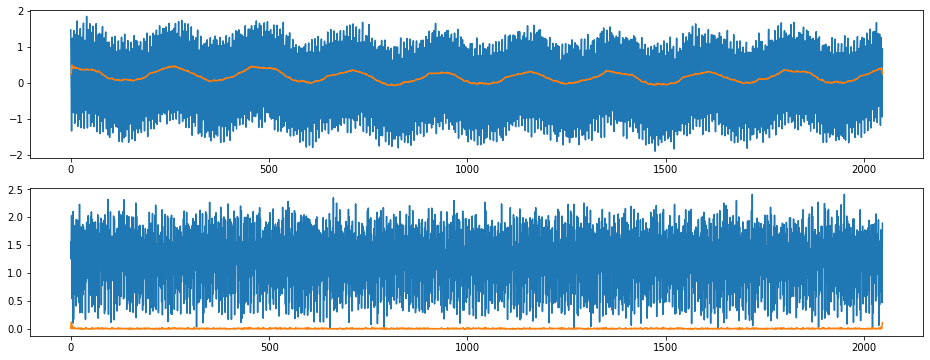

index:  156923
MAE:  0.8952985617833064
n_bunches       684
bunch_index     224
bunch_number    111
Name: 5425, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6247/instability_data/06247_Inst_B1H_Q7_20170927_07h40m43s.h5


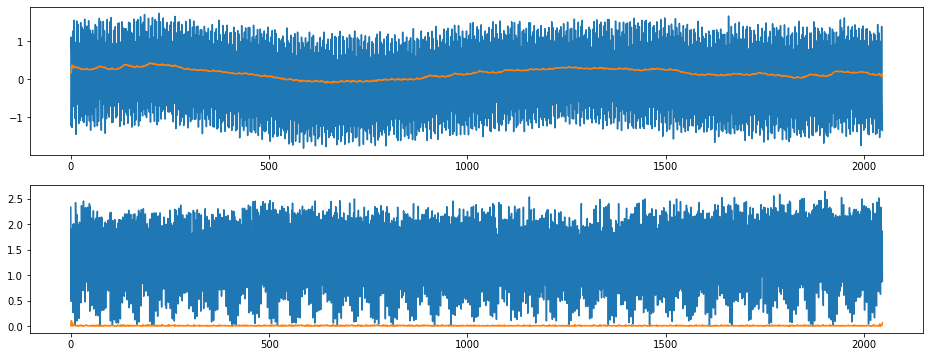

index:  93681
MAE:  0.8952198143585663
n_bunches       418
bunch_index     806
bunch_number    166
Name: 3236, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7481/instability_data/07481_Inst_B1H_Q7_20181128_09h48m56s.h5


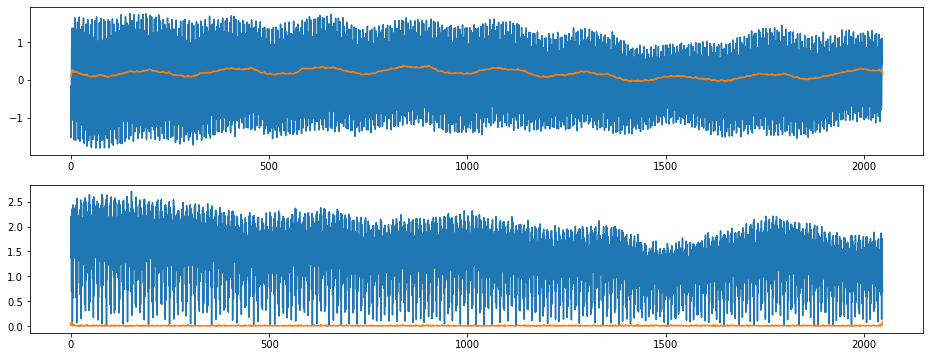

index:  391431
MAE:  0.8951213919466766
n_bunches       396
bunch_index     124
bunch_number     68
Name: 13578, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7122/instability_data/07122_Inst_B1H_Q7_20180903_07h29m11s.h5


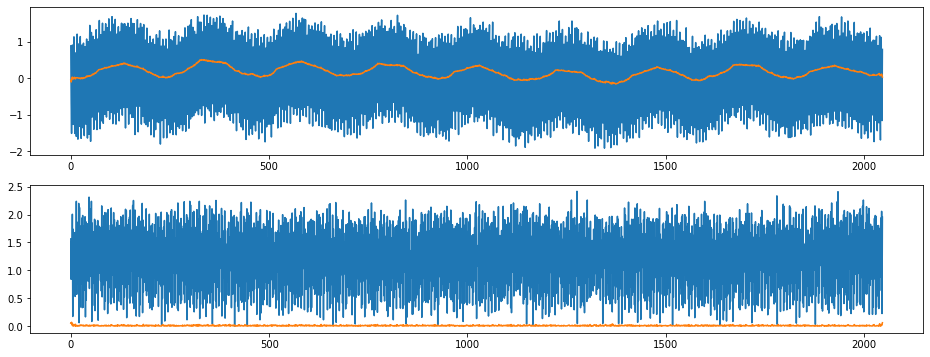

index:  362708
MAE:  0.8950710410494958
n_bunches       376
bunch_index     431
bunch_number     87
Name: 12585, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7468/instability_data/07468_Inst_B1H_Q7_20181123_19h34m32s.h5


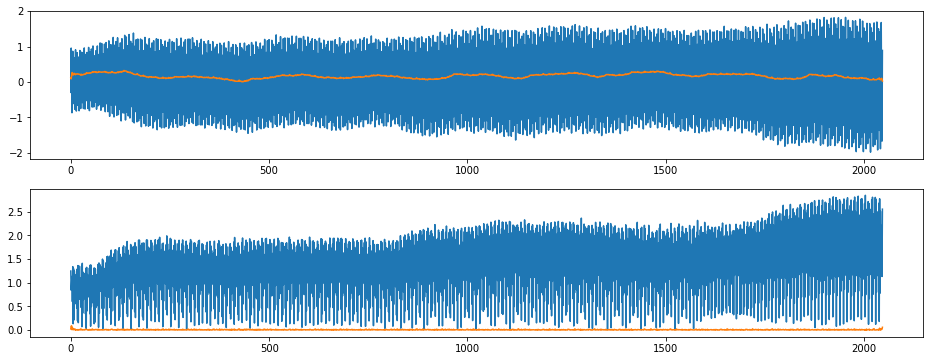

index:  389939
MAE:  0.8949608756920651
n_bunches       396
bunch_index      66
bunch_number     17
Name: 13527, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7122/instability_data/07122_Inst_B1H_Q7_20180903_07h29m11s.h5


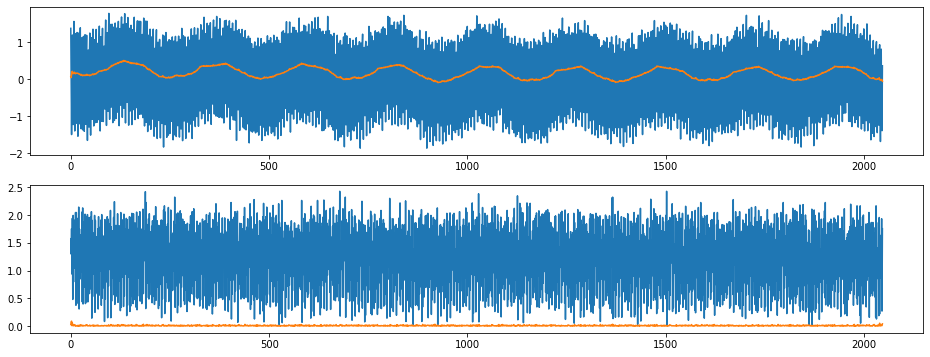

index:  83770
MAE:  0.8947364882587152
n_bunches        456
bunch_index     1212
bunch_number     277
Name: 2891, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7378/instability_data/07378_Inst_B1H_Q7_20181028_22h46m14s.h5


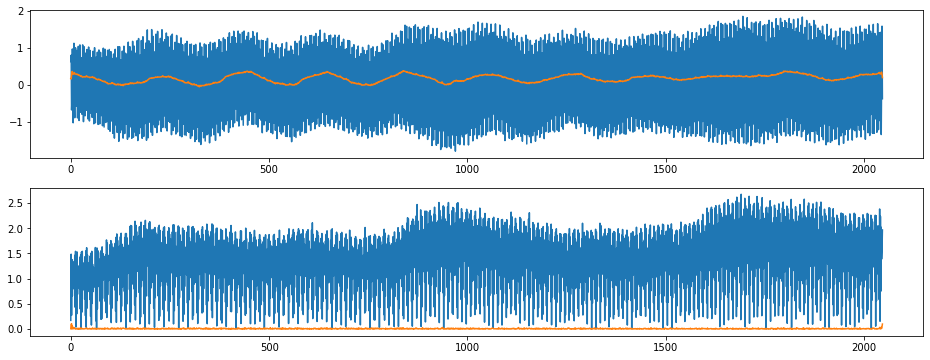

index:  54628
MAE:  0.8945556989804911
n_bunches        733
bunch_index     3334
bunch_number     705
Name: 1890, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


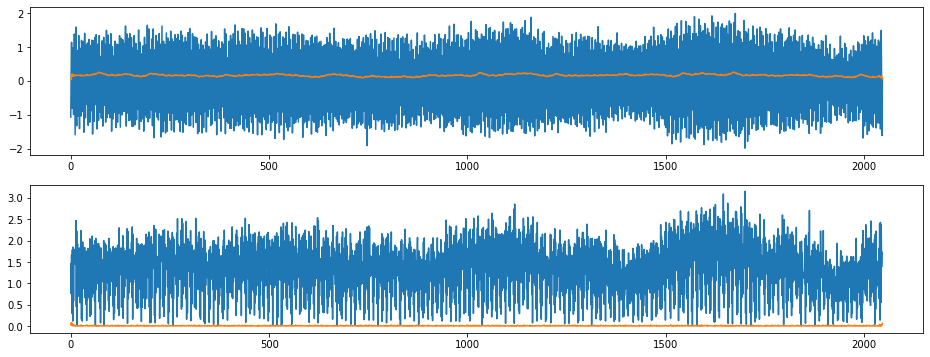

index:  209548
MAE:  0.8944219195259323
n_bunches       987
bunch_index      66
bunch_number     23
Name: 7251, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6706/instability_data/06706_Inst_B1H_Q7_20180520_12h23m14s.h5


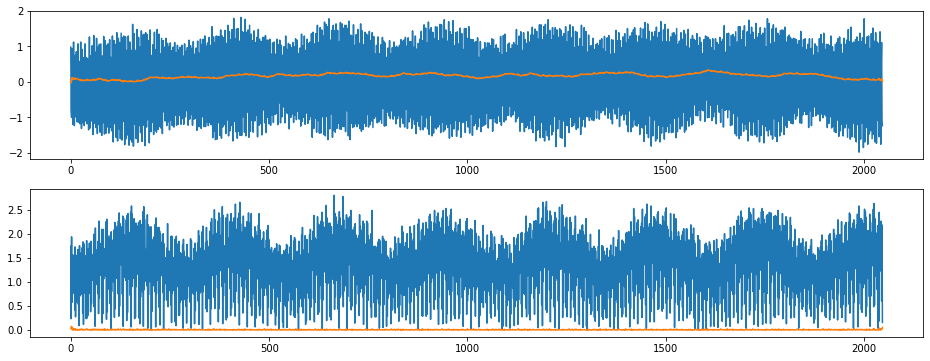

index:  56882
MAE:  0.894419596271343
n_bunches       444
bunch_index     230
bunch_number     47
Name: 1965, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6990/instability_data/06990_Inst_B1H_Q7_20180727_09h47m15s.h5


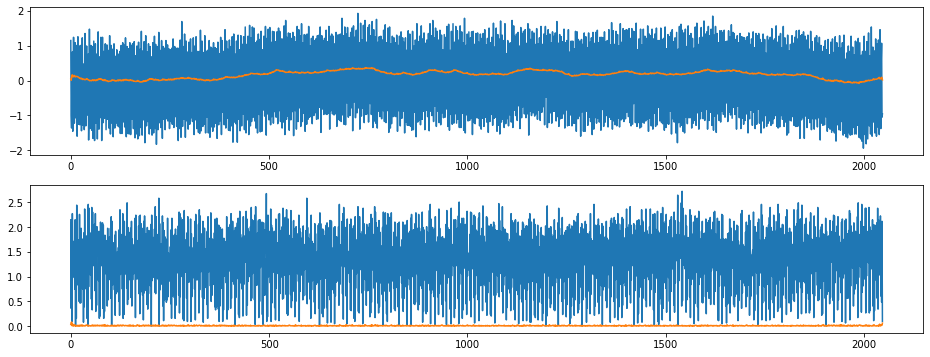

index:  54941
MAE:  0.8943916629559501
n_bunches        733
bunch_index     3370
bunch_number     714
Name: 1899, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


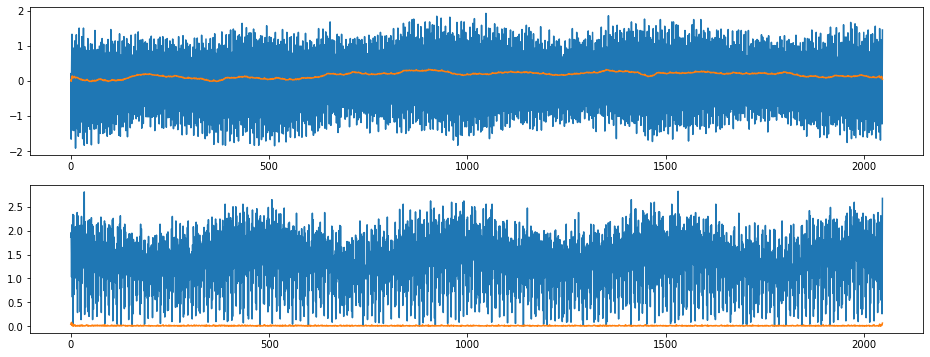

index:  208606
MAE:  0.8942479248760726
n_bunches       1227
bunch_index     3274
bunch_number    1219
Name: 7217, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_11h45m14s.h5


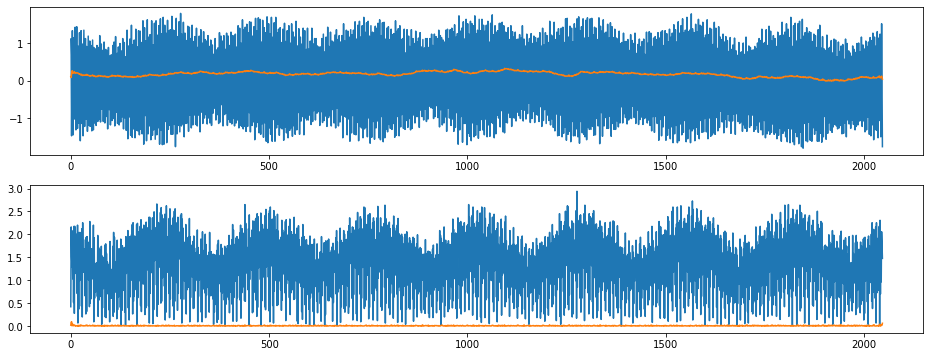

index:  391155
MAE:  0.8941626732185727
n_bunches       396
bunch_index     105
bunch_number     56
Name: 13566, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7122/instability_data/07122_Inst_B1H_Q7_20180903_07h29m11s.h5


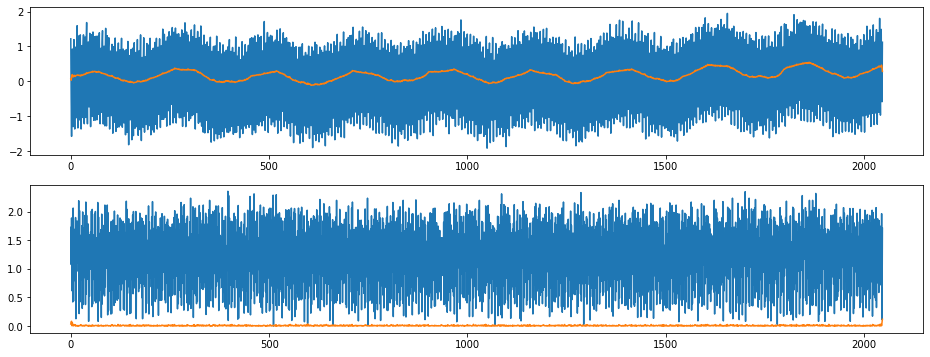

index:  32644
MAE:  0.8941308376636361
n_bunches        972
bunch_index     1716
bunch_number     907
Name: 1120, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6272/instability_data/06272_Inst_B1H_Q7_20171005_01h30m07s.h5


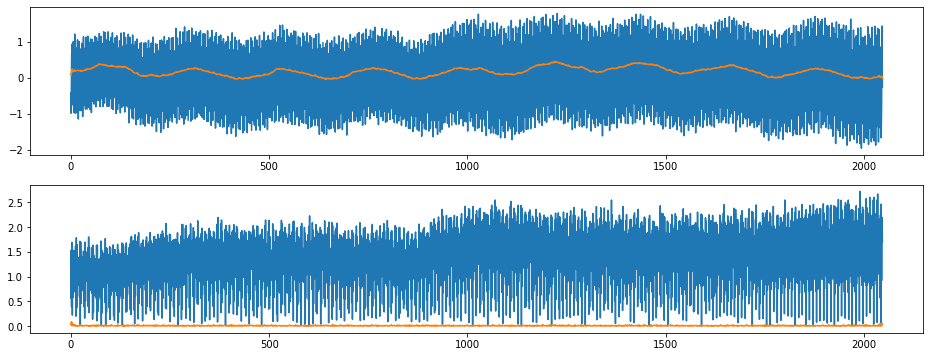

index:  389915
MAE:  0.8940035714403152
n_bunches       396
bunch_index      65
bunch_number     16
Name: 13526, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7122/instability_data/07122_Inst_B1H_Q7_20180903_07h29m11s.h5


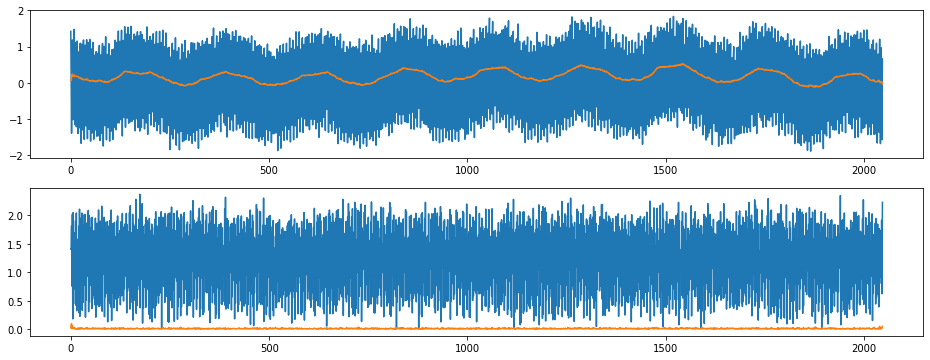

index:  387053
MAE:  0.8939133117628193
n_bunches       636
bunch_index     781
bunch_number    555
Name: 13429, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7037/instability_data/07037_Inst_B1H_Q7_20180808_02h43m34s.h5


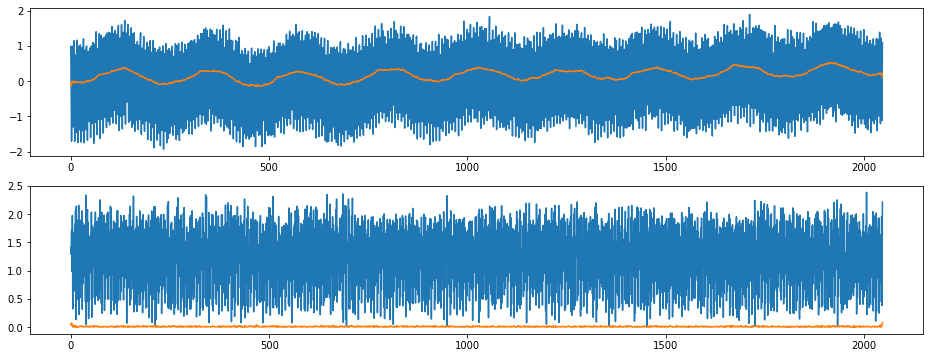

index:  391684
MAE:  0.8939124602745955
n_bunches       396
bunch_index     136
bunch_number     80
Name: 13590, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7122/instability_data/07122_Inst_B1H_Q7_20180903_07h29m11s.h5


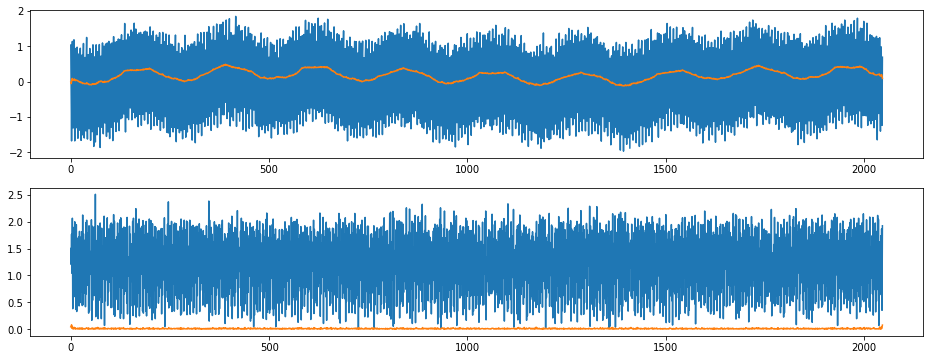

index:  54158
MAE:  0.8938718369539171
n_bunches        733
bunch_index     3245
bunch_number     689
Name: 1874, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


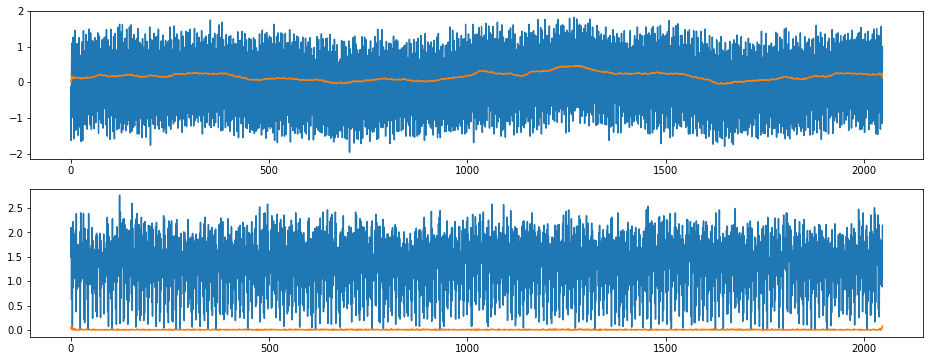

index:  408990
MAE:  0.8936794074587435
n_bunches        502
bunch_index     1272
bunch_number     270
Name: 14184, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_08h31m15s.h5


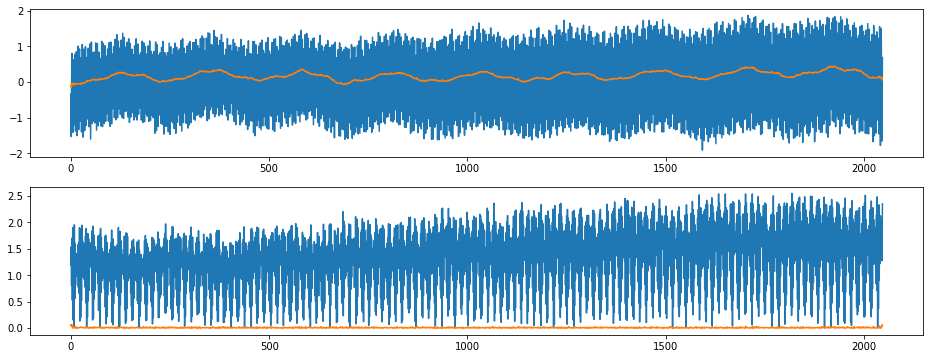

index:  256290
MAE:  0.893592436999233
n_bunches       372
bunch_index     437
bunch_number     76
Name: 8882, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7448/instability_data/07448_Inst_B1H_Q7_20181116_07h25m20s.h5


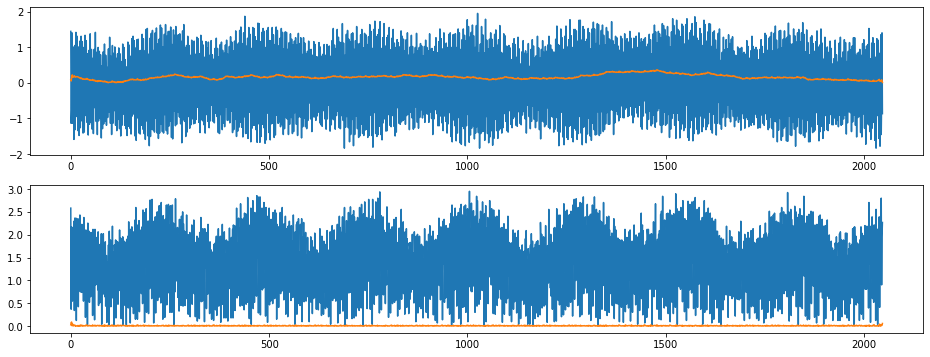

index:  392339
MAE:  0.8935614405499723
n_bunches       396
bunch_index     158
bunch_number    102
Name: 13612, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7122/instability_data/07122_Inst_B1H_Q7_20180903_07h29m11s.h5


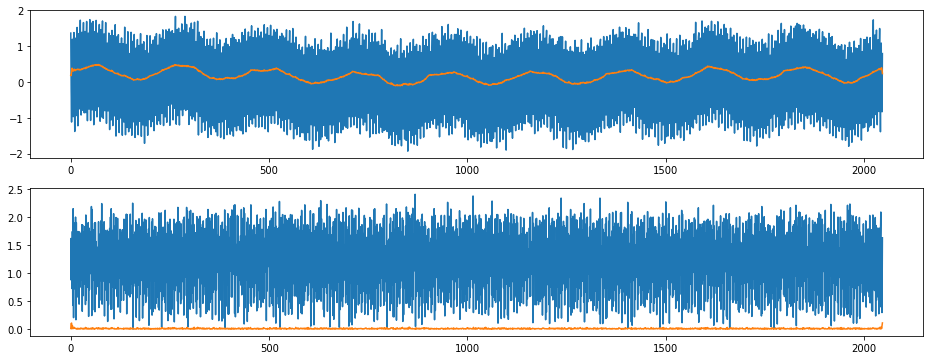

index:  386758
MAE:  0.8934968741061884
n_bunches       636
bunch_index     771
bunch_number    545
Name: 13419, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7037/instability_data/07037_Inst_B1H_Q7_20180808_02h43m34s.h5


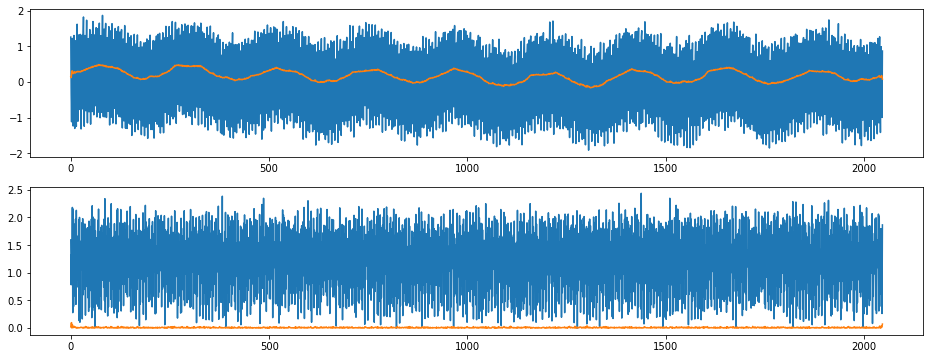

index:  205442
MAE:  0.8934828361114346
n_bunches       1227
bunch_index     3154
bunch_number    1113
Name: 7111, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_11h45m14s.h5


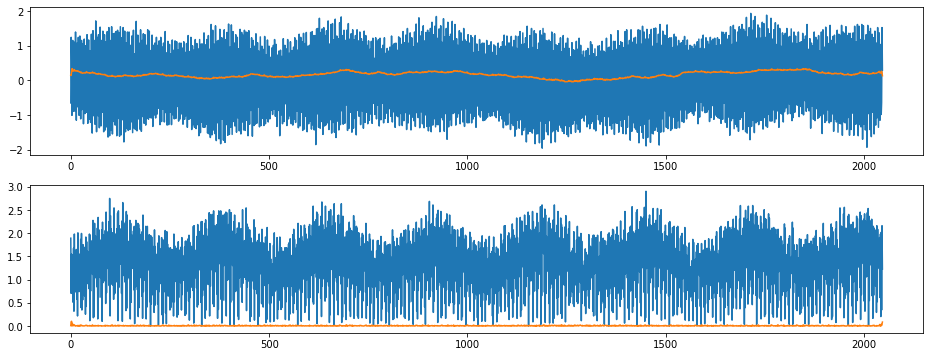

index:  205394
MAE:  0.8934613892385325
n_bunches       1227
bunch_index     3152
bunch_number    1111
Name: 7109, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_11h45m14s.h5


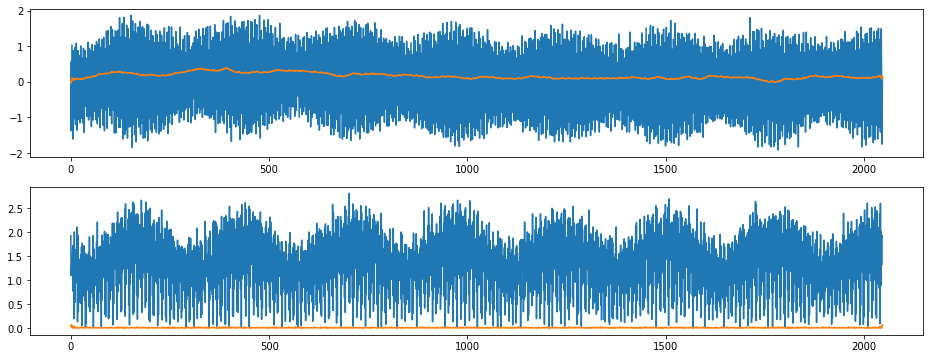

index:  52686
MAE:  0.8933857767079139
n_bunches        733
bunch_index     3003
bunch_number     635
Name: 1820, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


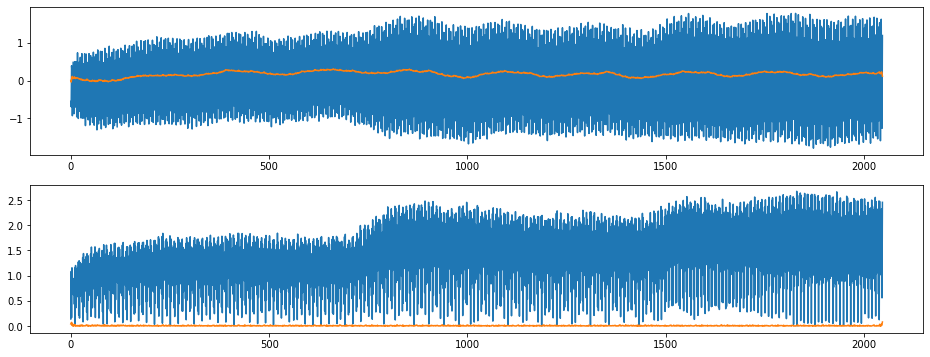

index:  392067
MAE:  0.8933471375478863
n_bunches       396
bunch_index     149
bunch_number     93
Name: 13603, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7122/instability_data/07122_Inst_B1H_Q7_20180903_07h29m11s.h5


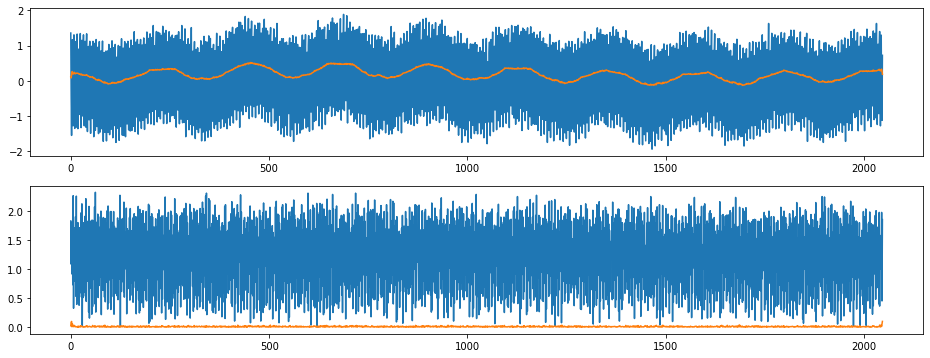

index:  388793
MAE:  0.8933453089605403
n_bunches       636
bunch_index     846
bunch_number    613
Name: 13487, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7037/instability_data/07037_Inst_B1H_Q7_20180808_02h43m34s.h5


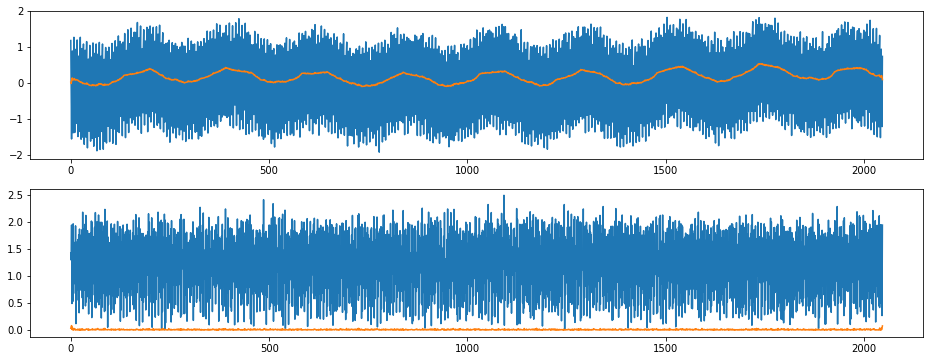

index:  393112
MAE:  0.8932826555537189
n_bunches       396
bunch_index     217
bunch_number    130
Name: 13640, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7122/instability_data/07122_Inst_B1H_Q7_20180903_07h29m11s.h5


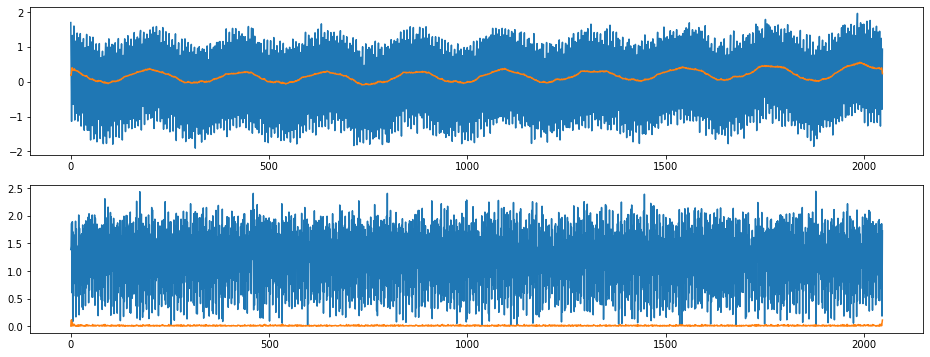

index:  389919
MAE:  0.8932494942088525
n_bunches       396
bunch_index      65
bunch_number     16
Name: 13526, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7122/instability_data/07122_Inst_B1H_Q7_20180903_07h29m11s.h5


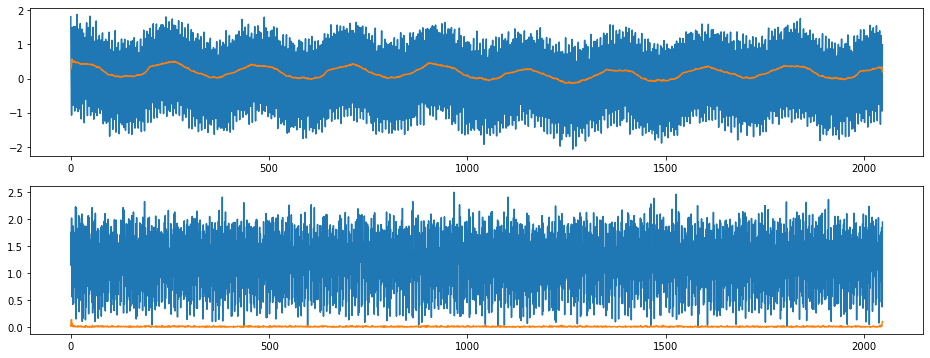

index:  55809
MAE:  0.8930239943366649
n_bunches       444
bunch_index      29
bunch_number     11
Name: 1929, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6990/instability_data/06990_Inst_B1H_Q7_20180727_09h47m15s.h5


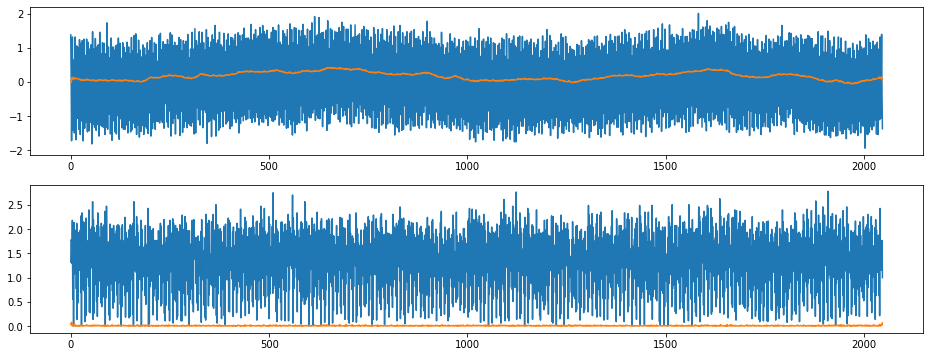

index:  388649
MAE:  0.893005843286623
n_bunches       636
bunch_index     841
bunch_number    608
Name: 13482, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7037/instability_data/07037_Inst_B1H_Q7_20180808_02h43m34s.h5


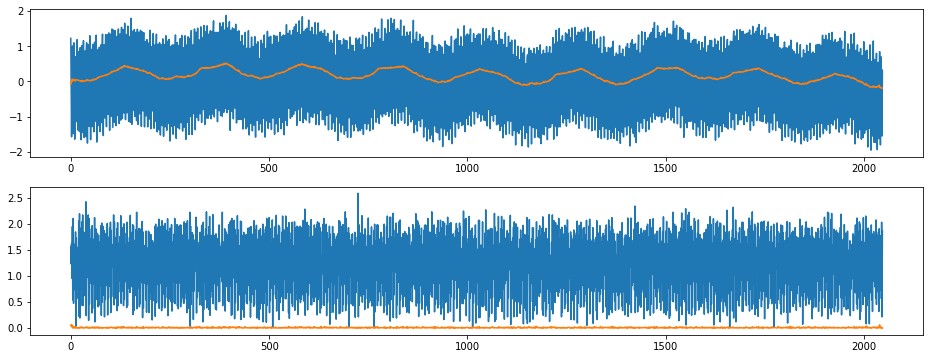

index:  53623
MAE:  0.892978089174066
n_bunches        733
bunch_index     3170
bunch_number     670
Name: 1855, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


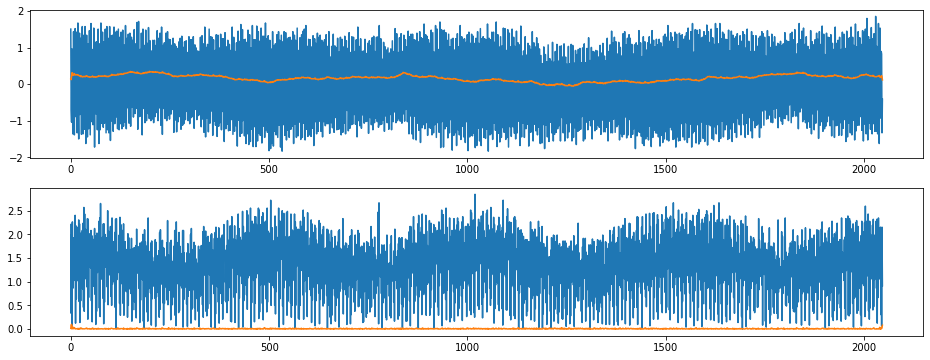

index:  57105
MAE:  0.8929740057752424
n_bunches       444
bunch_index     237
bunch_number     54
Name: 1972, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6990/instability_data/06990_Inst_B1H_Q7_20180727_09h47m15s.h5


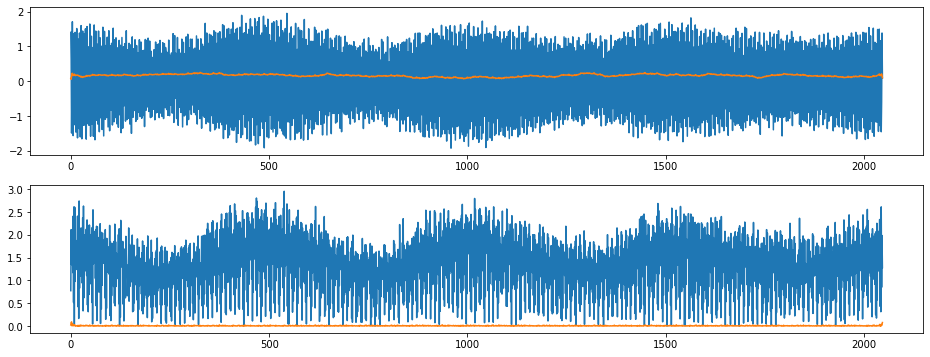

index:  57169
MAE:  0.8928978065706984
n_bunches       444
bunch_index     239
bunch_number     56
Name: 1974, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6990/instability_data/06990_Inst_B1H_Q7_20180727_09h47m15s.h5


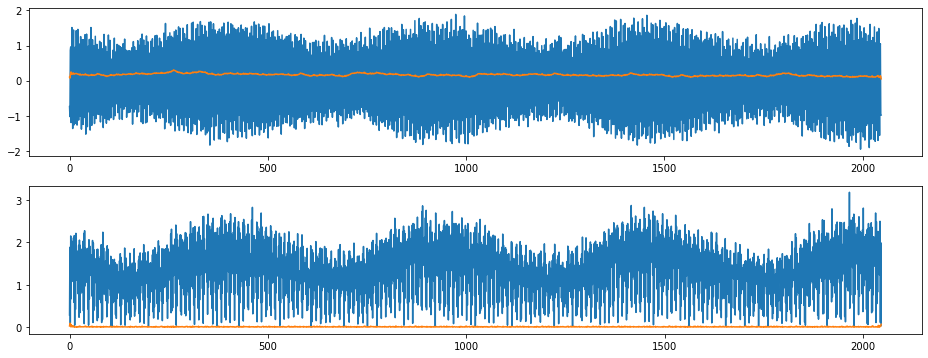

index:  85589
MAE:  0.892893282379525
n_bunches        456
bunch_index     1306
bunch_number     340
Name: 2954, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7378/instability_data/07378_Inst_B1H_Q7_20181028_22h46m14s.h5


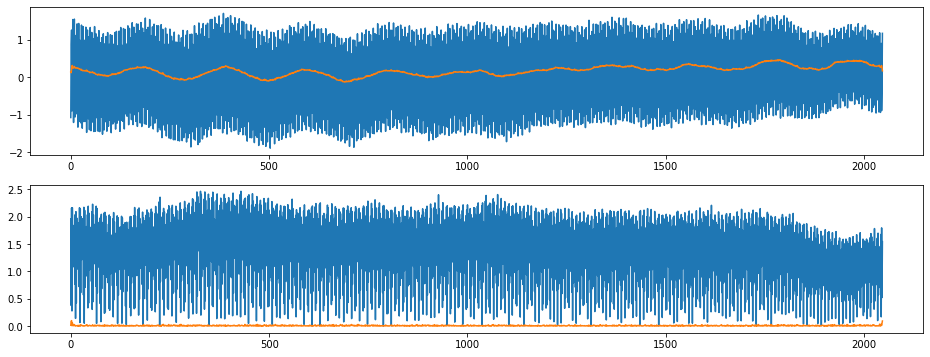

index:  53692
MAE:  0.8928896588844182
n_bunches        733
bunch_index     3182
bunch_number     673
Name: 1858, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


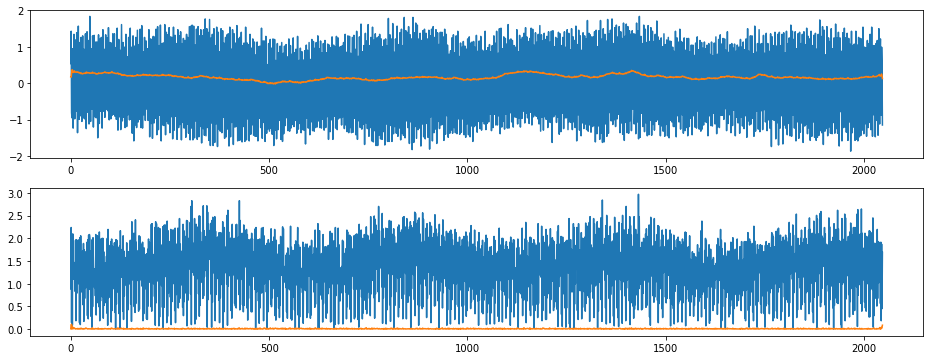

index:  50242
MAE:  0.892727010476364
n_bunches        733
bunch_index     2612
bunch_number     550
Name: 1735, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


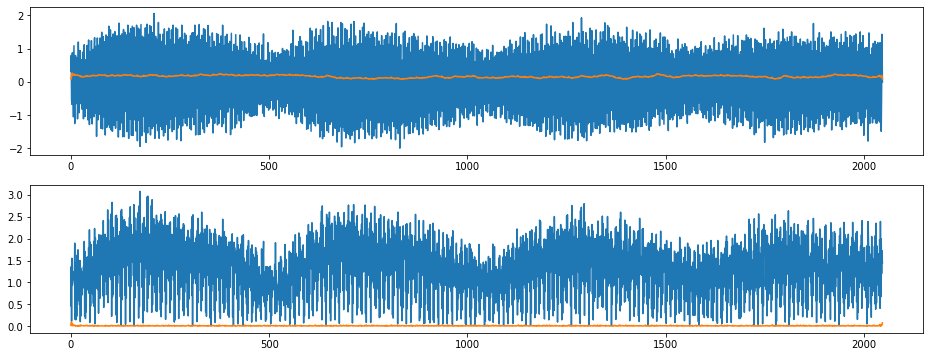

index:  54143
MAE:  0.8927068472571249
n_bunches        733
bunch_index     3242
bunch_number     688
Name: 1873, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


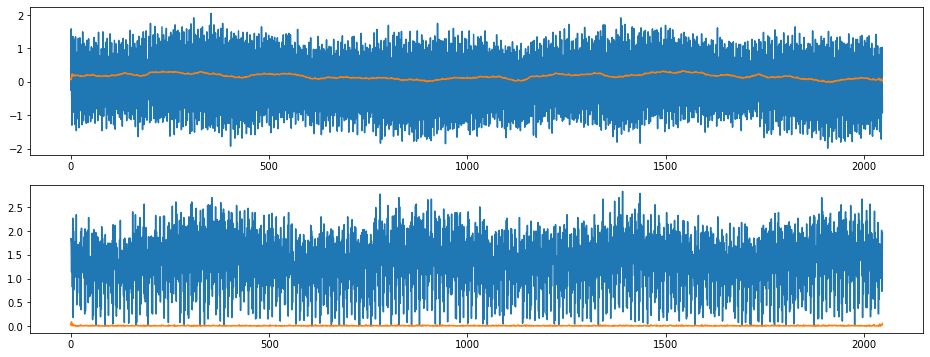

index:  219081
MAE:  0.8926608525044826
n_bunches        987
bunch_index     1155
bunch_number     343
Name: 7571, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6706/instability_data/06706_Inst_B1H_Q7_20180520_12h23m14s.h5


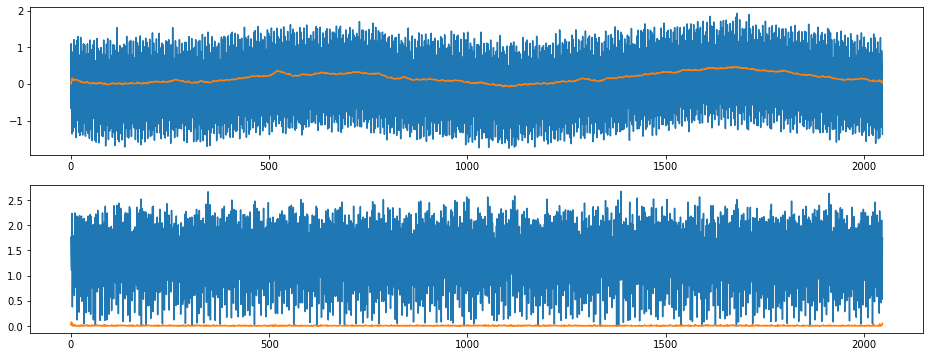

index:  292016
MAE:  0.8923567247765324
n_bunches        648
bunch_index     2473
bunch_number     463
Name: 10132, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7446/instability_data/07446_Inst_B1H_Q7_20181116_02h46m18s.h5


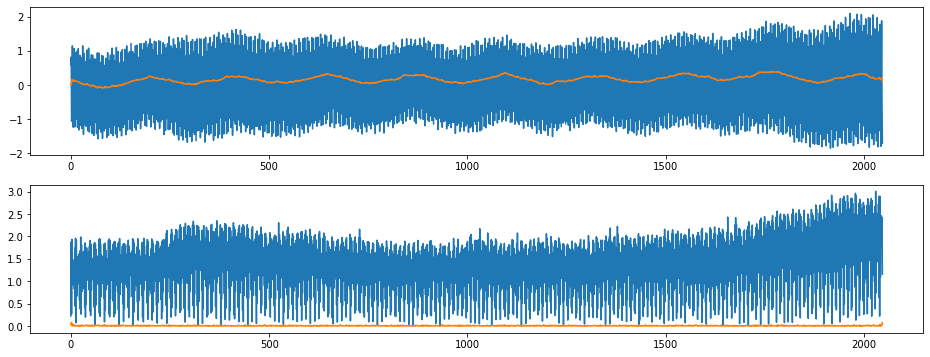

index:  286842
MAE:  0.8921917926392657
n_bunches        648
bunch_index     1534
bunch_number     284
Name: 9953, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7446/instability_data/07446_Inst_B1H_Q7_20181116_02h46m18s.h5


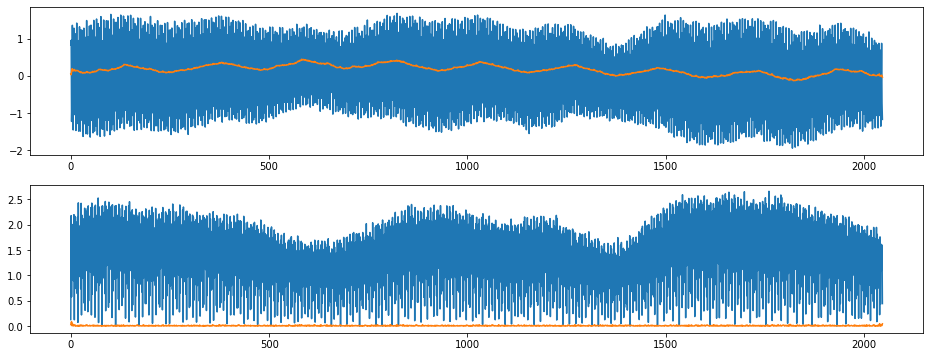

index:  387551
MAE:  0.8921914394879289
n_bunches       636
bunch_index     796
bunch_number    570
Name: 13444, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7037/instability_data/07037_Inst_B1H_Q7_20180808_02h43m34s.h5


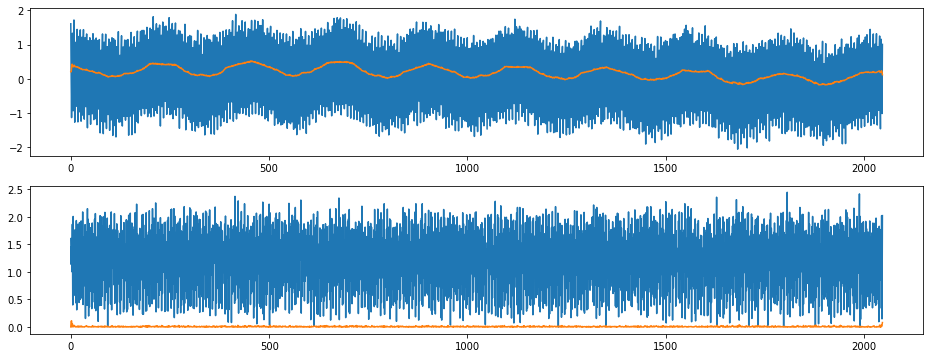

index:  53199
MAE:  0.8918612217833006
n_bunches        733
bunch_index     3104
bunch_number     654
Name: 1839, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


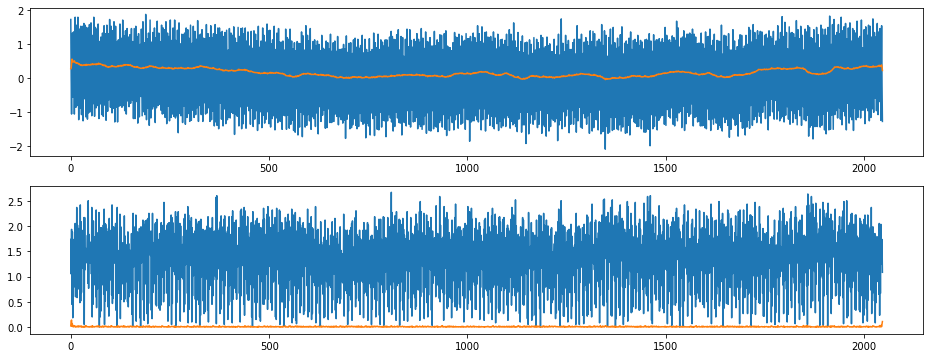

index:  43787
MAE:  0.8918072219193911
n_bunches        733
bunch_index     1504
bunch_number     315
Name: 1500, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


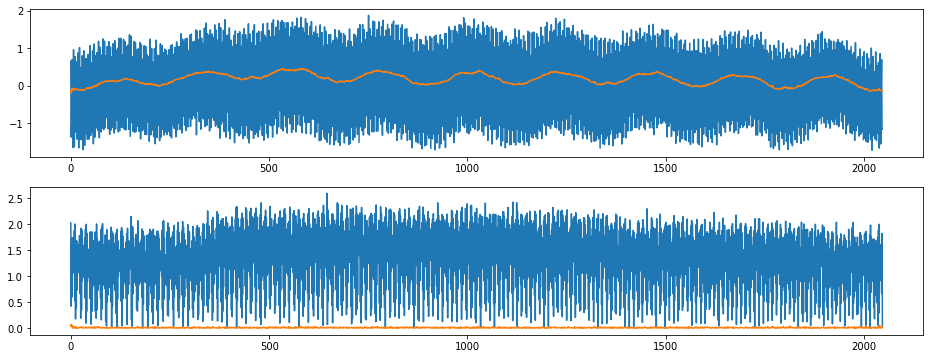

index:  26384
MAE:  0.8914243726883908
n_bunches        972
bunch_index     1316
bunch_number     690
Name: 903, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6272/instability_data/06272_Inst_B1H_Q7_20171005_01h30m07s.h5


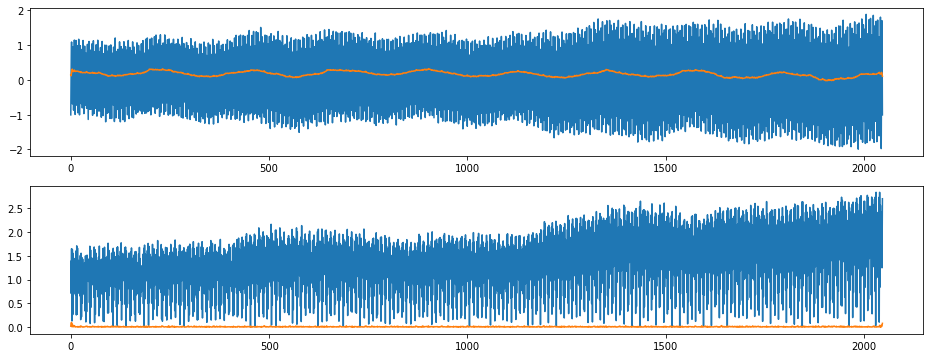

index:  52572
MAE:  0.8913993467342183
n_bunches        733
bunch_index     2988
bunch_number     631
Name: 1816, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


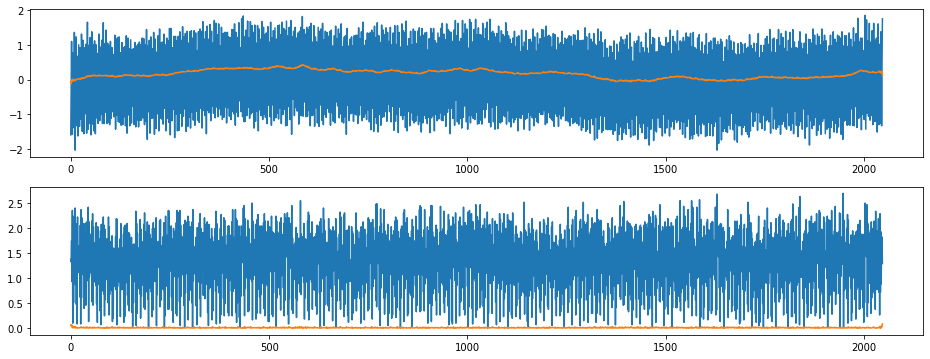

index:  1565
MAE:  0.8913787677024593
n_bunches       192
bunch_index     167
bunch_number     33
Name: 54, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6897/instability_data/06897_Inst_B1H_Q7_20180708_00h36m16s.h5


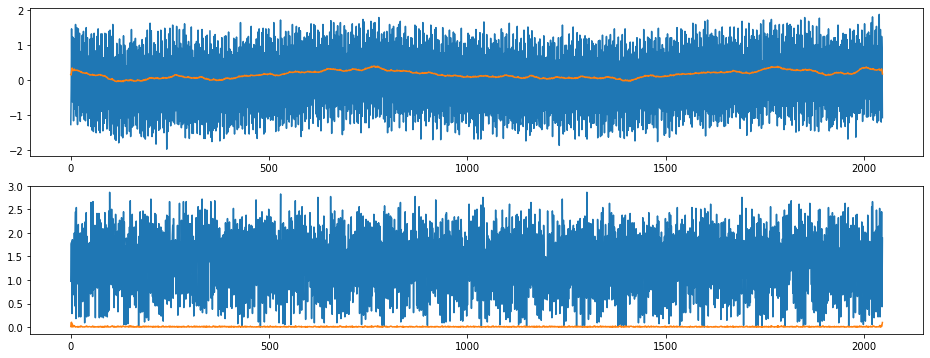

index:  57190
MAE:  0.8912000583573243
n_bunches       444
bunch_index     240
bunch_number     57
Name: 1975, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6990/instability_data/06990_Inst_B1H_Q7_20180727_09h47m15s.h5


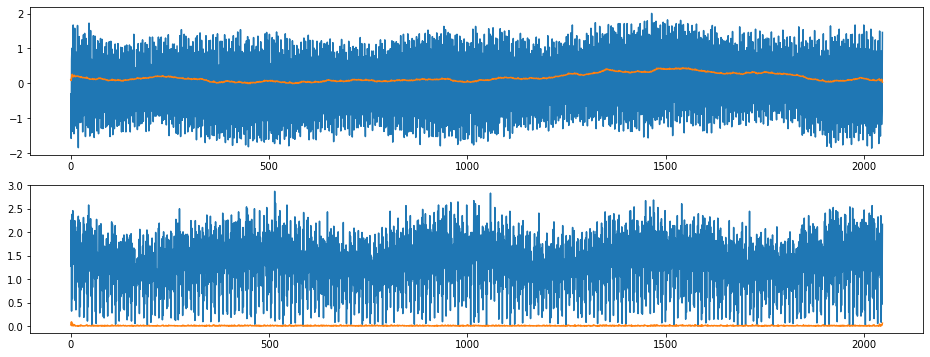

index:  55289
MAE:  0.8911837911798288
n_bunches        733
bunch_index     3418
bunch_number     726
Name: 1911, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


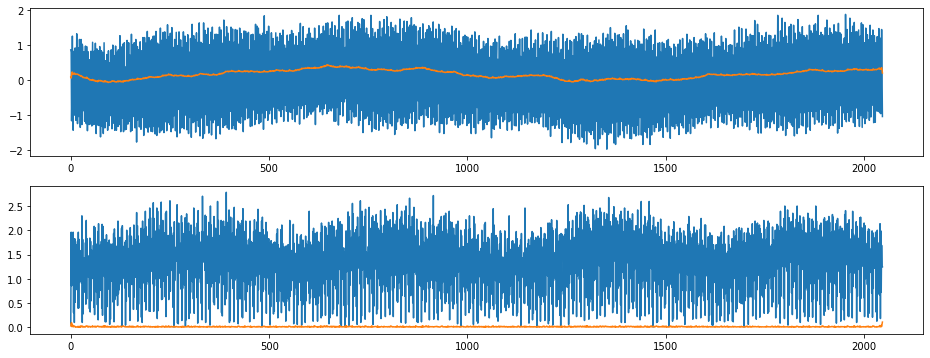

index:  116734
MAE:  0.8911409493012217
n_bunches       796
bunch_index     197
bunch_number     92
Name: 4026, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6192/instability_data/06192_Inst_B1H_Q7_20170912_17h19m38s.h5


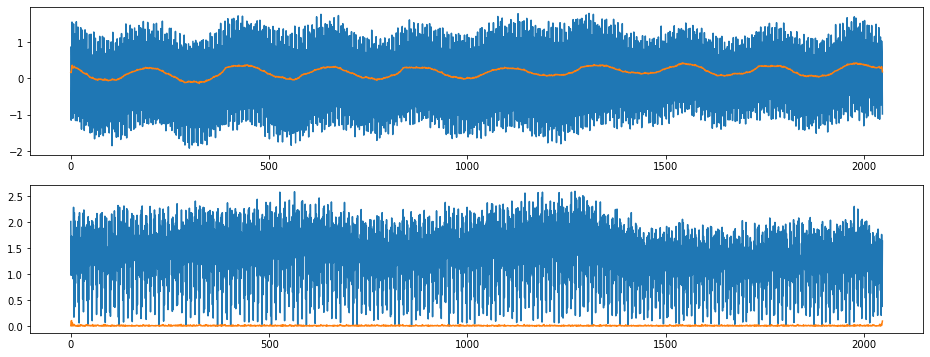

index:  390664
MAE:  0.8910654110840984
n_bunches       396
bunch_index      90
bunch_number     41
Name: 13551, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7122/instability_data/07122_Inst_B1H_Q7_20180903_07h29m11s.h5


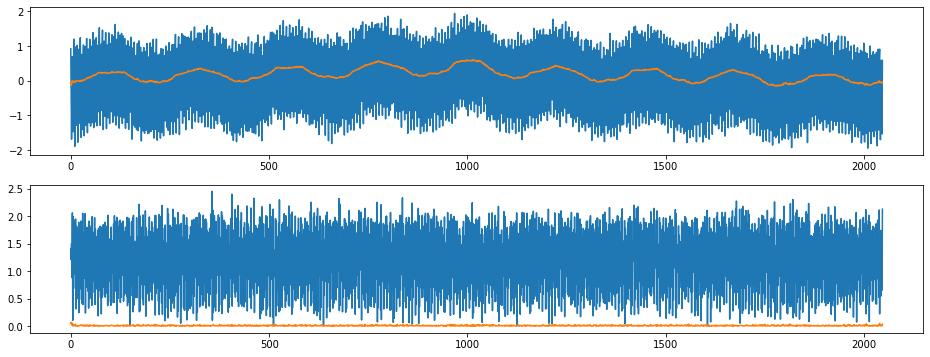

index:  384246
MAE:  0.8910266820040373
n_bunches       636
bunch_index     640
bunch_number    456
Name: 13330, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7037/instability_data/07037_Inst_B1H_Q7_20180808_02h43m34s.h5


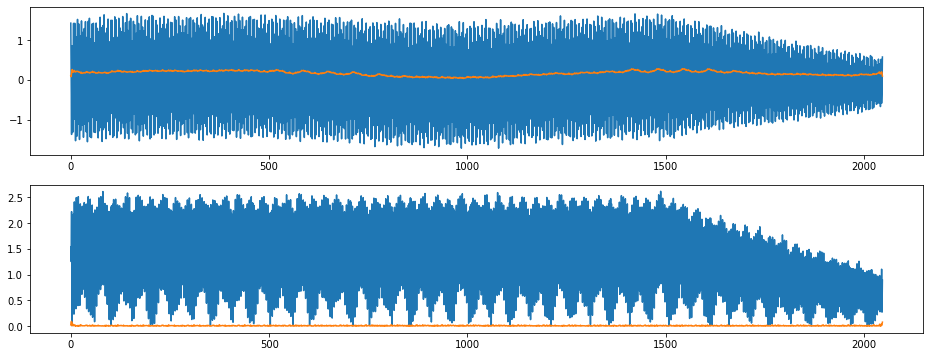

index:  54409
MAE:  0.8909486670662812
n_bunches        733
bunch_index     3304
bunch_number     697
Name: 1882, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


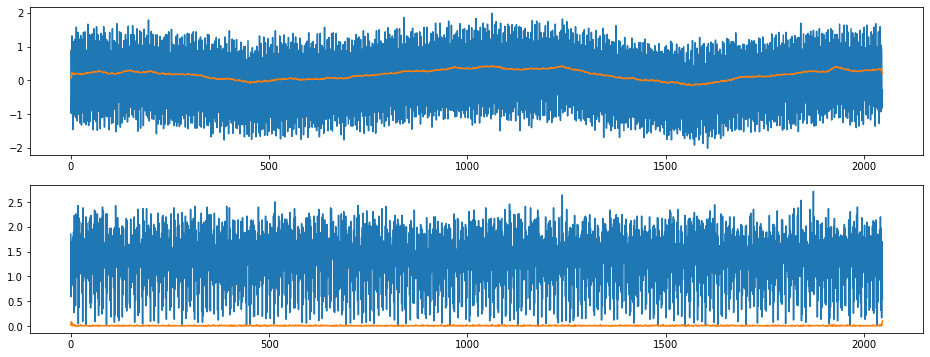

index:  56597
MAE:  0.8908053715548511
n_bunches       444
bunch_index     221
bunch_number     38
Name: 1956, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6990/instability_data/06990_Inst_B1H_Q7_20180727_09h47m15s.h5


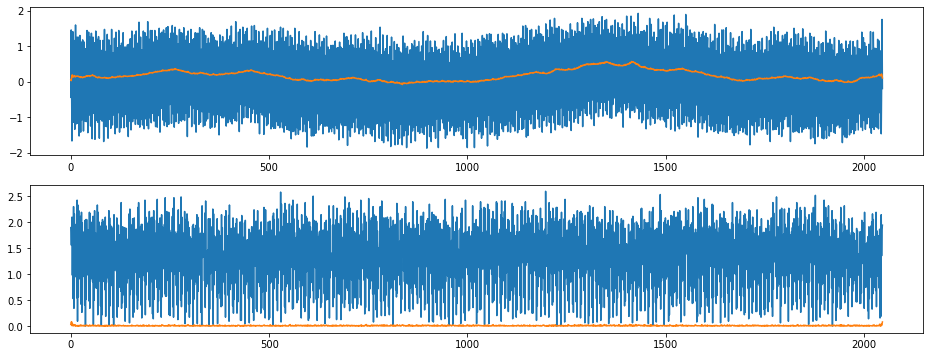

index:  97302
MAE:  0.8907909341003086
n_bunches        418
bunch_index     1370
bunch_number     288
Name: 3358, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7481/instability_data/07481_Inst_B1H_Q7_20181128_09h48m56s.h5


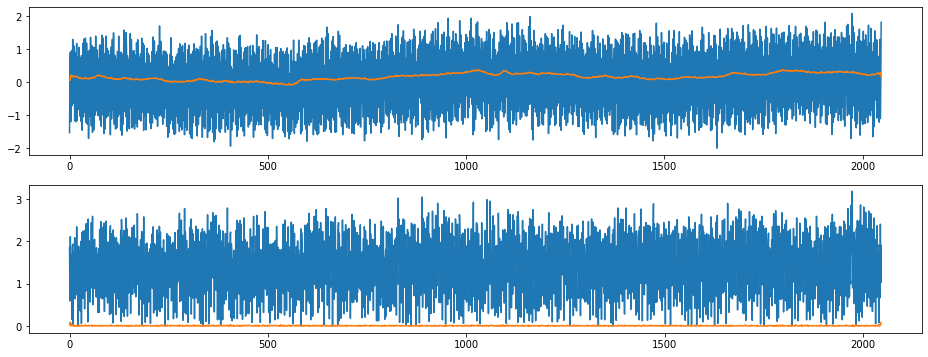

index:  211236
MAE:  0.8906031466906793
n_bunches       987
bunch_index     250
bunch_number     79
Name: 7307, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6706/instability_data/06706_Inst_B1H_Q7_20180520_12h23m14s.h5


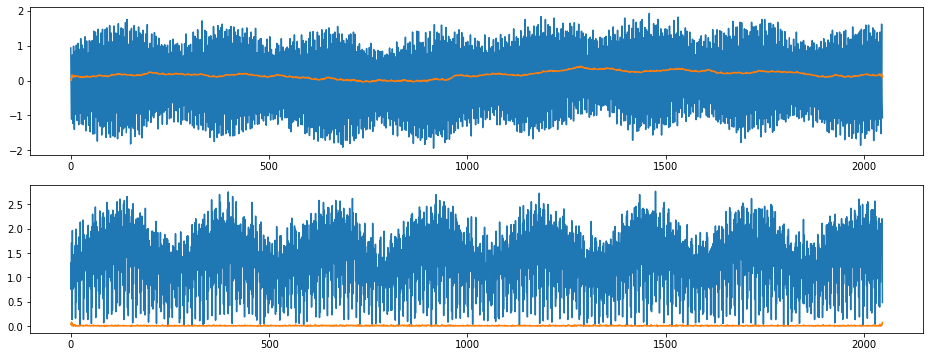

index:  50087
MAE:  0.8903796623355587
n_bunches        733
bunch_index     2588
bunch_number     544
Name: 1729, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


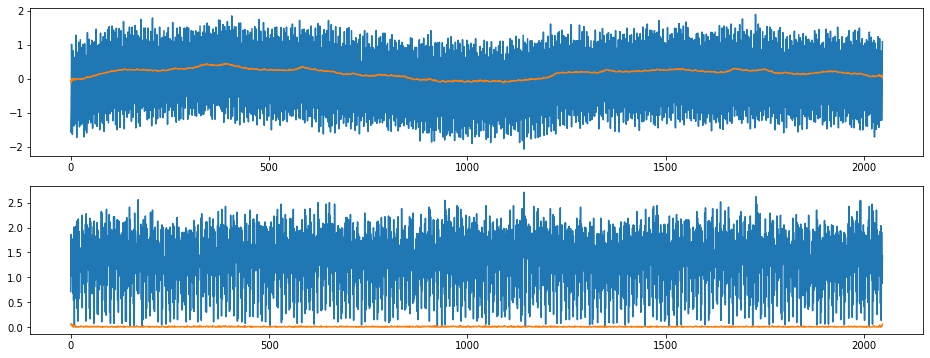

index:  45929
MAE:  0.890352062267969
n_bunches        733
bunch_index     1873
bunch_number     393
Name: 1578, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


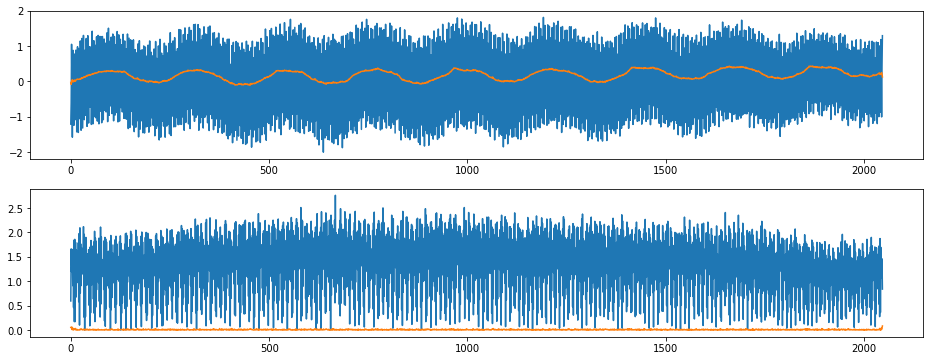

index:  212393
MAE:  0.8902949819765452
n_bunches       987
bunch_index     288
bunch_number    117
Name: 7345, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6706/instability_data/06706_Inst_B1H_Q7_20180520_12h23m14s.h5


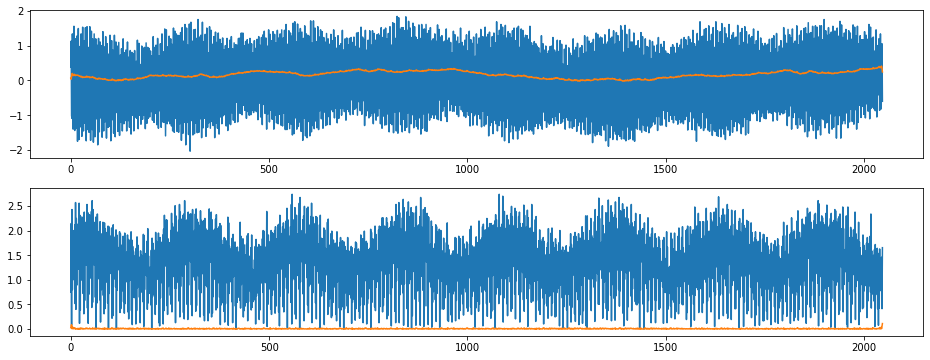

index:  48819
MAE:  0.890237286086739
n_bunches        733
bunch_index     2345
bunch_number     498
Name: 1683, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


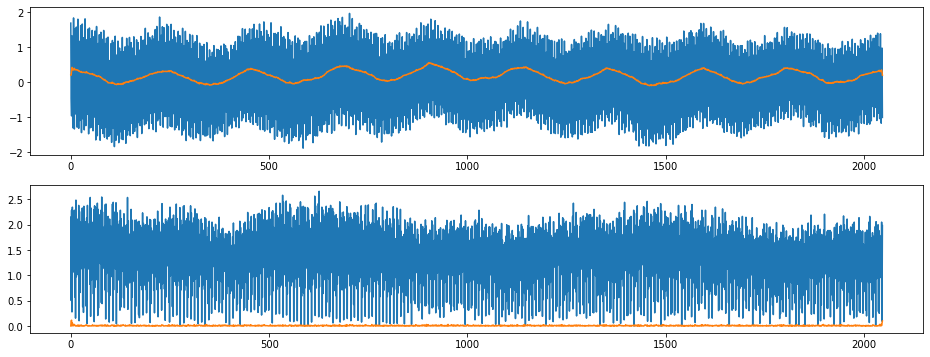

index:  56249
MAE:  0.8902189830615437
n_bunches       444
bunch_index     210
bunch_number     27
Name: 1945, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6990/instability_data/06990_Inst_B1H_Q7_20180727_09h47m15s.h5


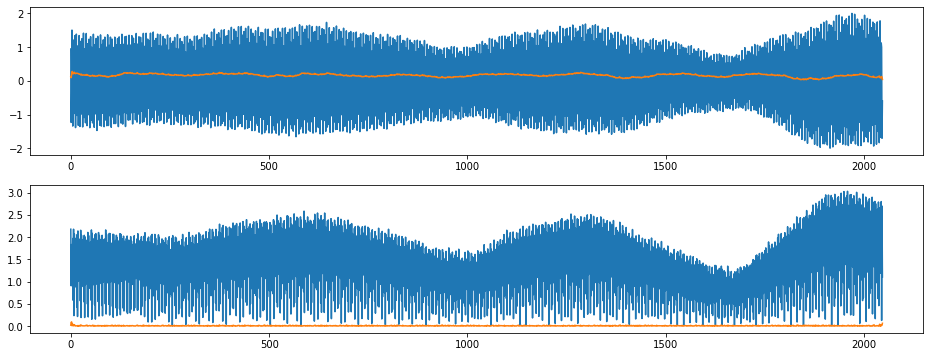

index:  156012
MAE:  0.8901560622557358
n_bunches       684
bunch_index     176
bunch_number     79
Name: 5393, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6247/instability_data/06247_Inst_B1H_Q7_20170927_07h40m43s.h5


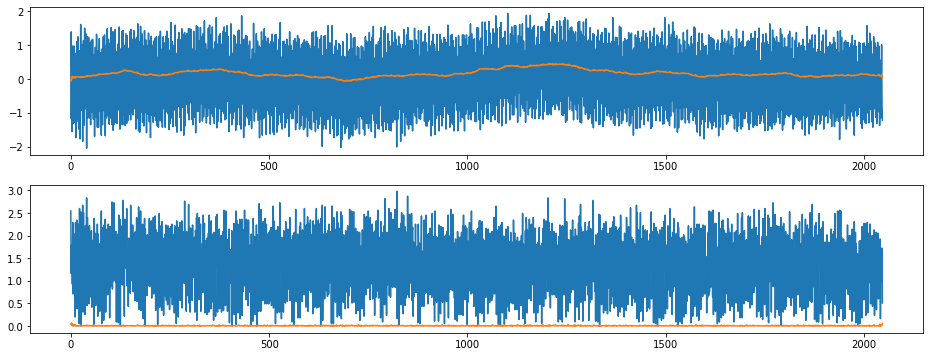

index:  211653
MAE:  0.8901330377565899
n_bunches       987
bunch_index     263
bunch_number     92
Name: 7320, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6706/instability_data/06706_Inst_B1H_Q7_20180520_12h23m14s.h5


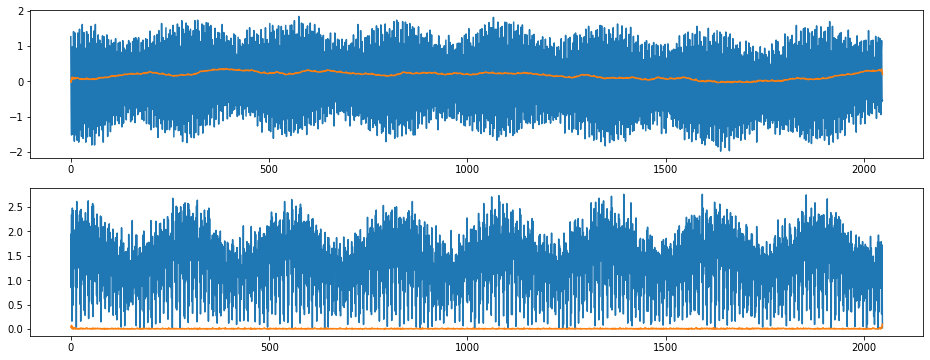

index:  386471
MAE:  0.8900905315652676
n_bunches       636
bunch_index     726
bunch_number    535
Name: 13409, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7037/instability_data/07037_Inst_B1H_Q7_20180808_02h43m34s.h5


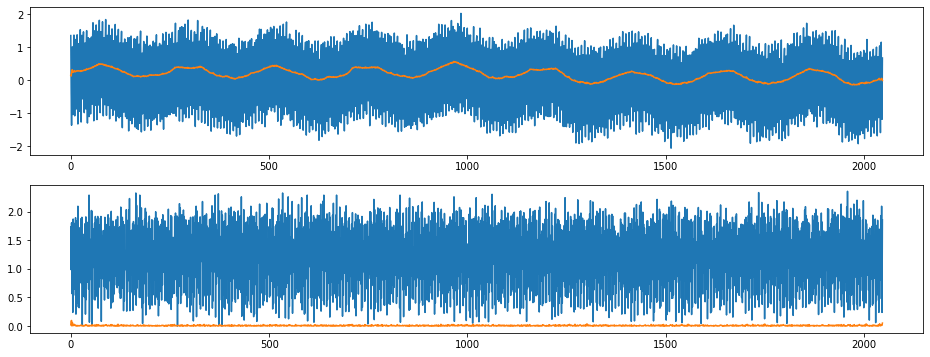

index:  206344
MAE:  0.8900104843573207
n_bunches       1227
bunch_index     3190
bunch_number    1142
Name: 7140, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_11h45m14s.h5


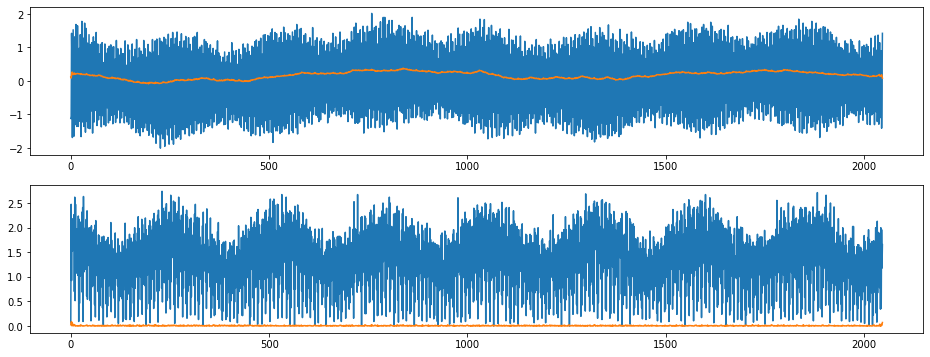

index:  50692
MAE:  0.8897831069550314
n_bunches        733
bunch_index     2701
bunch_number     566
Name: 1751, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


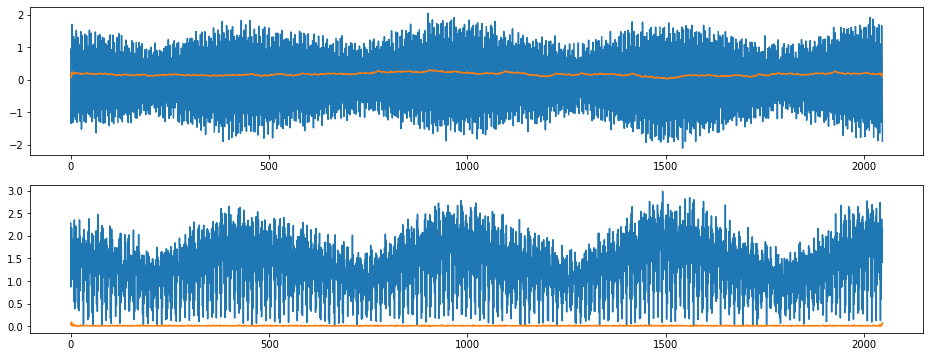

index:  204812
MAE:  0.889774557221994
n_bunches       1227
bunch_index     3134
bunch_number    1093
Name: 7091, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_11h45m14s.h5


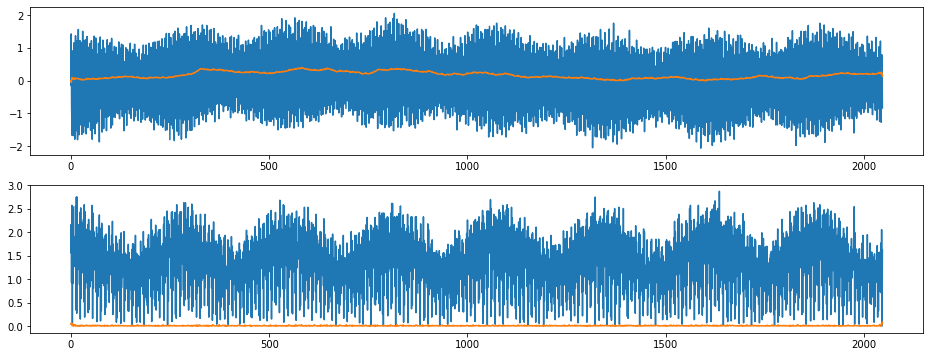

index:  6672
MAE:  0.8897100348748606
n_bunches       972
bunch_index      65
bunch_number     15
Name: 228, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6272/instability_data/06272_Inst_B1H_Q7_20171005_01h30m07s.h5


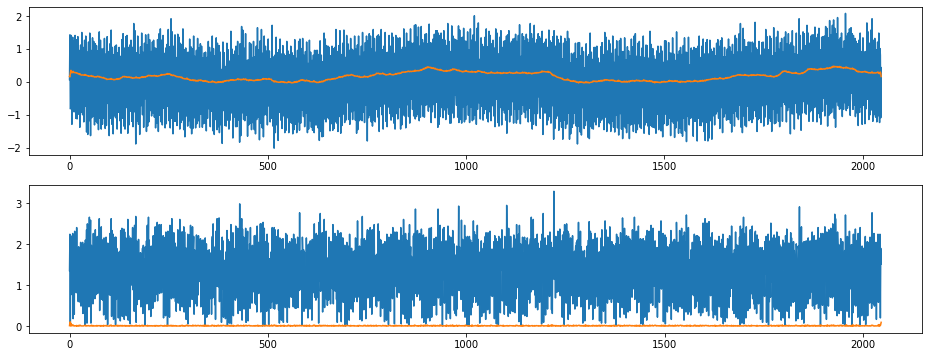

index:  390748
MAE:  0.8896636922000659
n_bunches       396
bunch_index      92
bunch_number     43
Name: 13553, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7122/instability_data/07122_Inst_B1H_Q7_20180903_07h29m11s.h5


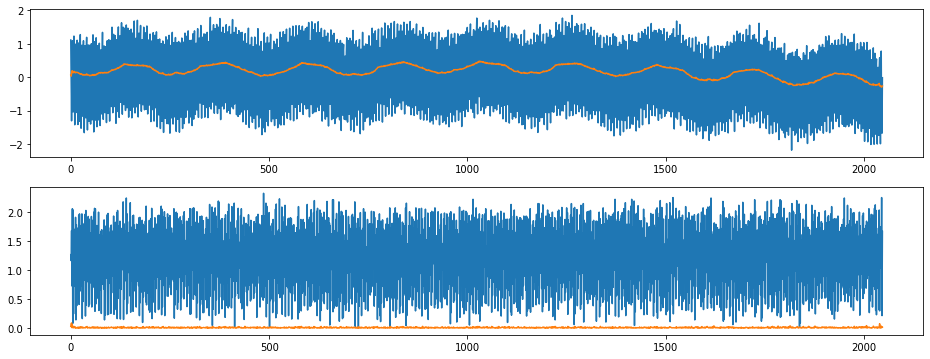

index:  49949
MAE:  0.8895682776699629
n_bunches        733
bunch_index     2536
bunch_number     539
Name: 1724, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


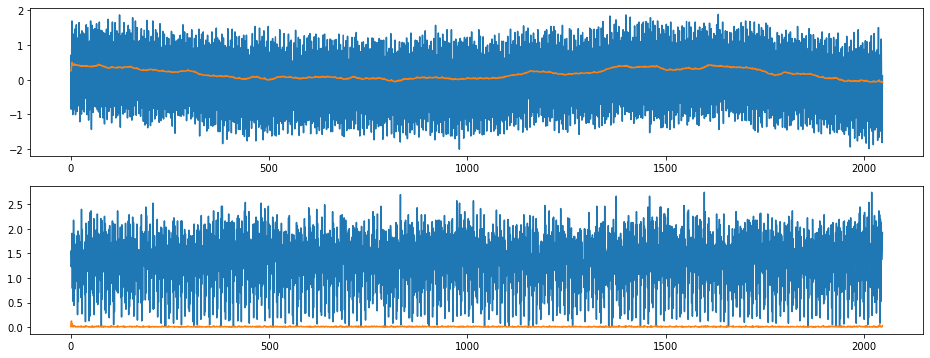

index:  208457
MAE:  0.8894732237940837
n_bunches       1227
bunch_index     3270
bunch_number    1215
Name: 7213, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_11h45m14s.h5


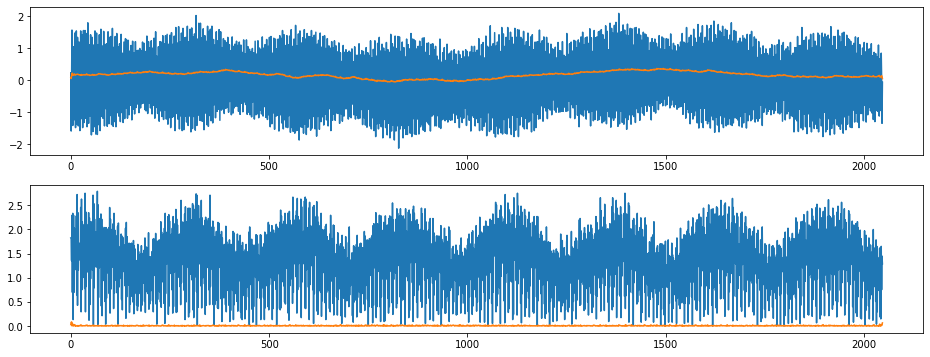

index:  92547
MAE:  0.8894635106446984
n_bunches       418
bunch_index     619
bunch_number    127
Name: 3197, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7481/instability_data/07481_Inst_B1H_Q7_20181128_09h48m56s.h5


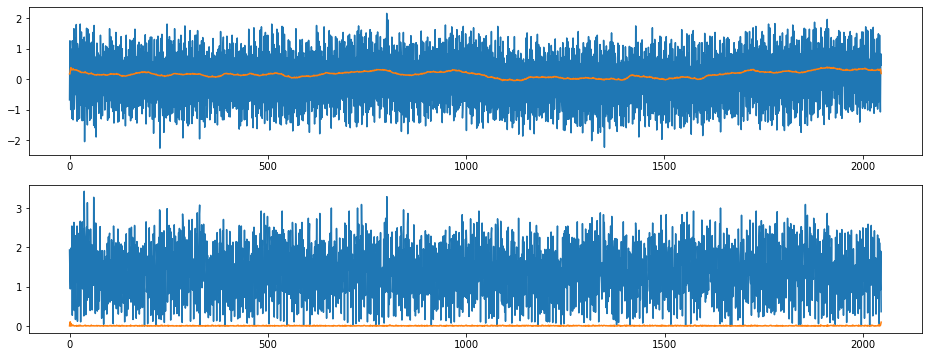

index:  382275
MAE:  0.8892958026107365
n_bunches       636
bunch_index     532
bunch_number    386
Name: 13260, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7037/instability_data/07037_Inst_B1H_Q7_20180808_02h43m34s.h5


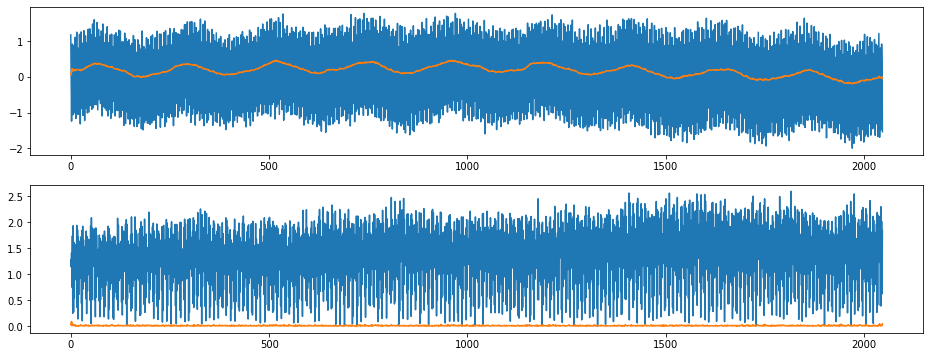

index:  314007
MAE:  0.889096289755624
n_bunches        648
bunch_index     2241
bunch_number     417
Name: 10892, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7444/instability_data/07444_Inst_B1H_Q7_20181115_07h56m14s.h5


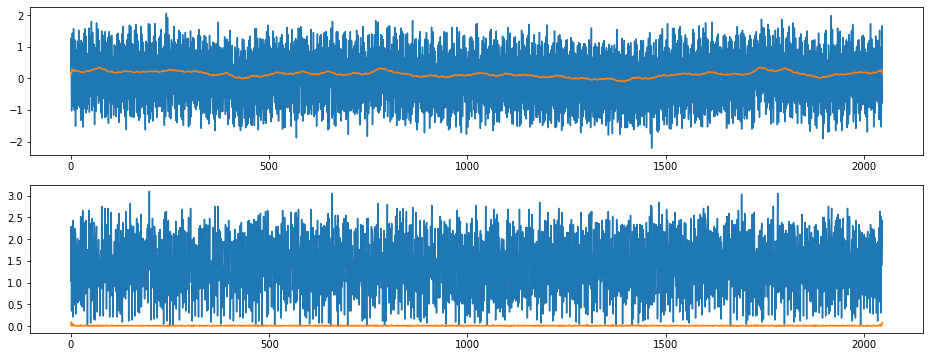

index:  50729
MAE:  0.8890530200273503
n_bunches        733
bunch_index     2704
bunch_number     567
Name: 1752, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


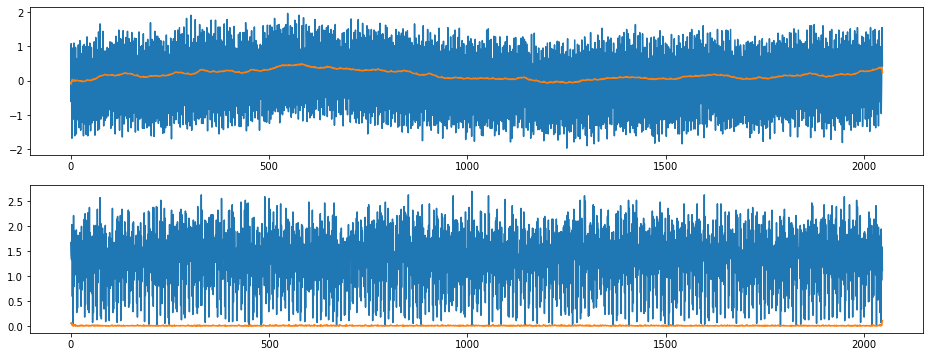

index:  361467
MAE:  0.8889954794124959
n_bunches       376
bunch_index     237
bunch_number     45
Name: 12543, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7468/instability_data/07468_Inst_B1H_Q7_20181123_19h34m32s.h5


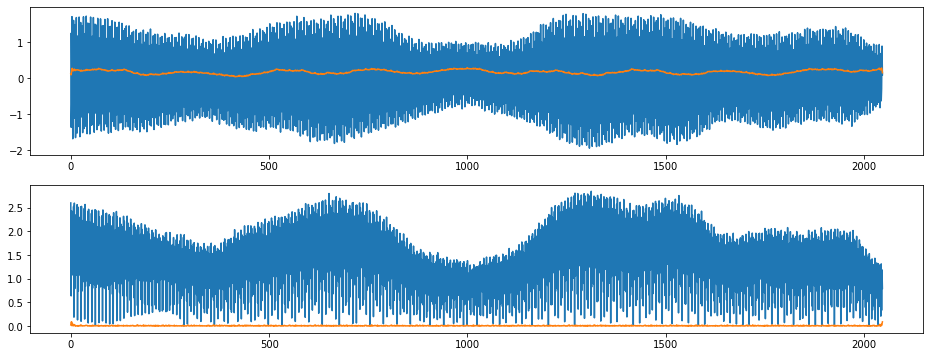

index:  215207
MAE:  0.8889923218564254
n_bunches       987
bunch_index     554
bunch_number    213
Name: 7441, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6706/instability_data/06706_Inst_B1H_Q7_20180520_12h23m14s.h5


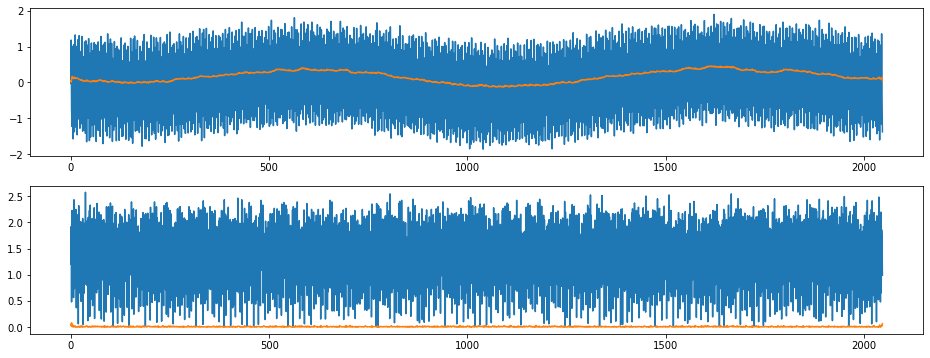

index:  261428
MAE:  0.8888346773296998
n_bunches        372
bunch_index     1372
bunch_number     254
Name: 9060, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7448/instability_data/07448_Inst_B1H_Q7_20181116_07h25m20s.h5


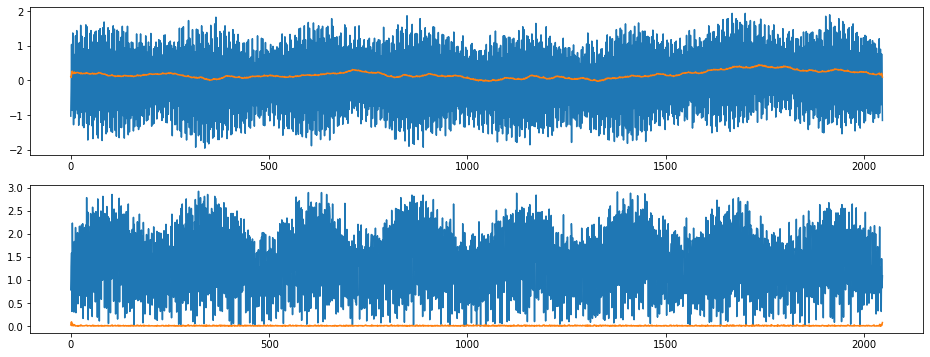

index:  386400
MAE:  0.8888120719765715
n_bunches       636
bunch_index     722
bunch_number    531
Name: 13405, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7037/instability_data/07037_Inst_B1H_Q7_20180808_02h43m34s.h5


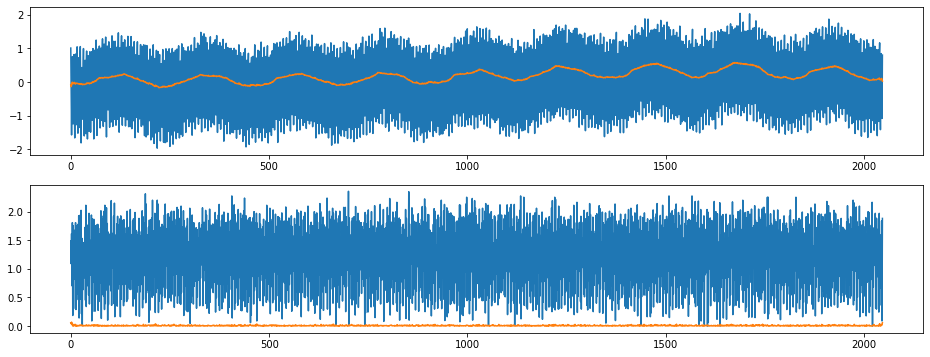

index:  161997
MAE:  0.8887747359585514
n_bunches       684
bunch_index     518
bunch_number    284
Name: 5598, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6247/instability_data/06247_Inst_B1H_Q7_20170927_07h40m43s.h5


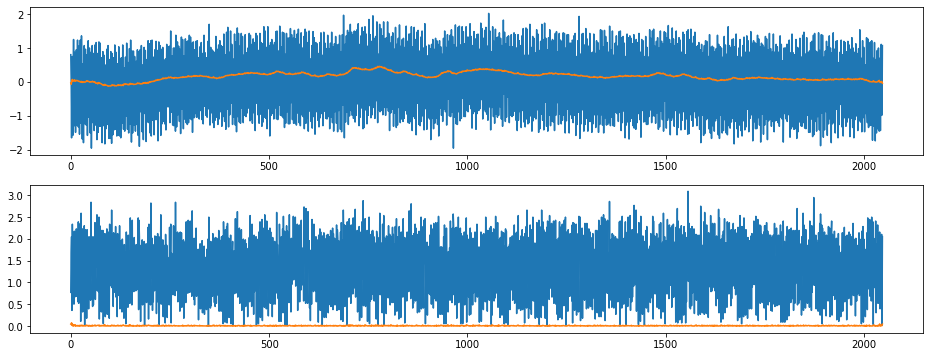

index:  25730
MAE:  0.8887667963714927
n_bunches        972
bunch_index     1254
bunch_number     667
Name: 880, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6272/instability_data/06272_Inst_B1H_Q7_20171005_01h30m07s.h5


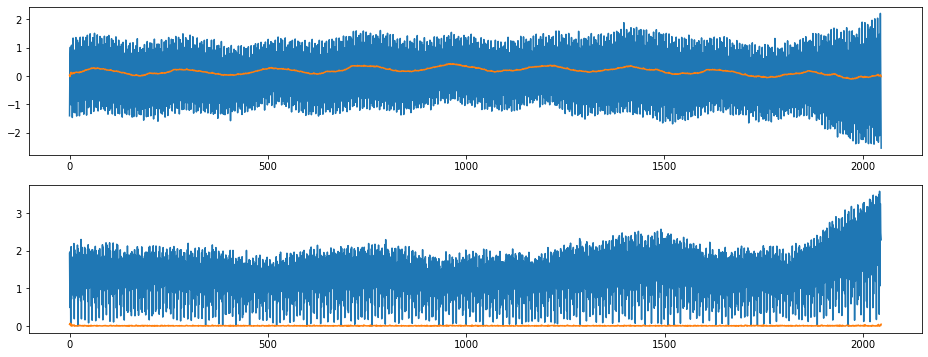

index:  57183
MAE:  0.8886679477297681
n_bunches       444
bunch_index     239
bunch_number     56
Name: 1974, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6990/instability_data/06990_Inst_B1H_Q7_20180727_09h47m15s.h5


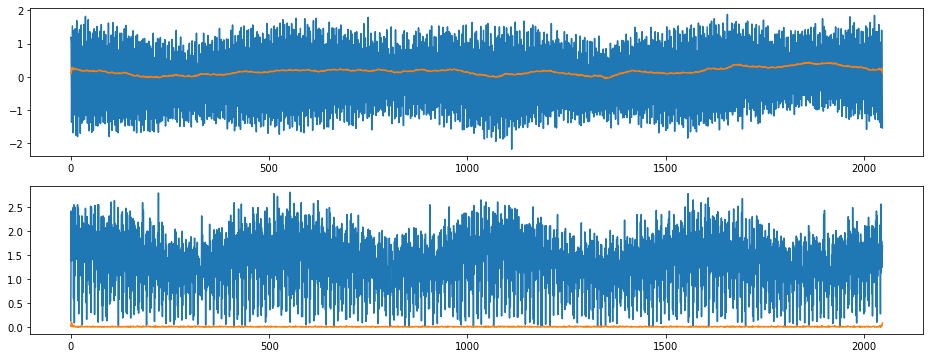

index:  391070
MAE:  0.8886594632062673
n_bunches       396
bunch_index     102
bunch_number     53
Name: 13563, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7122/instability_data/07122_Inst_B1H_Q7_20180903_07h29m11s.h5


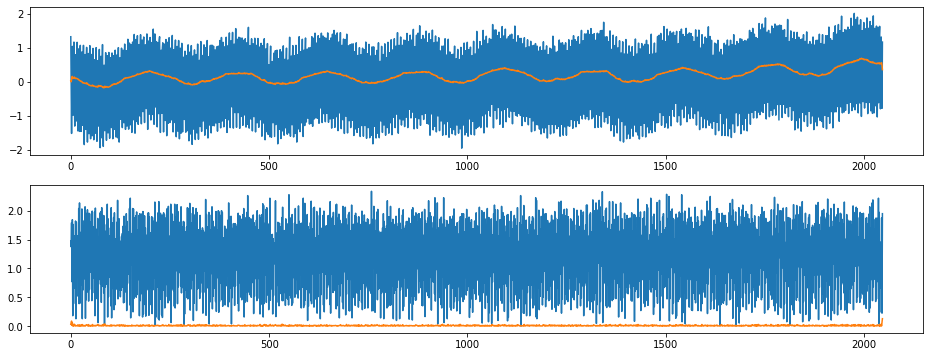

index:  33855
MAE:  0.8886314671548787
n_bunches        972
bunch_index     1782
bunch_number     947
Name: 1160, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6272/instability_data/06272_Inst_B1H_Q7_20171005_01h30m07s.h5


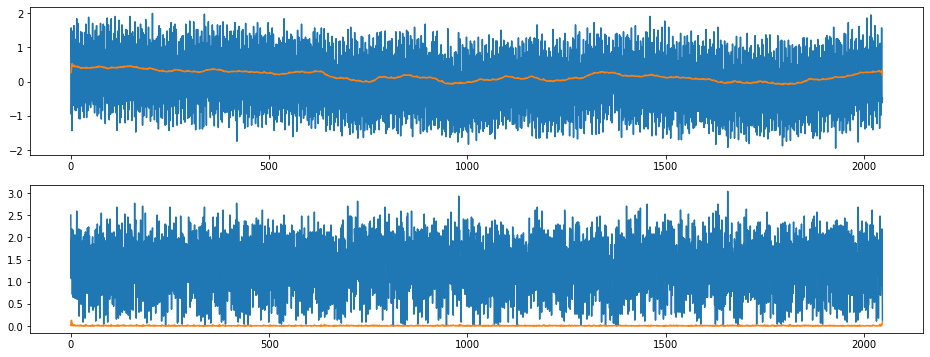

index:  162389
MAE:  0.88863118313089
n_bunches       684
bunch_index     562
bunch_number    297
Name: 5611, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6247/instability_data/06247_Inst_B1H_Q7_20170927_07h40m43s.h5


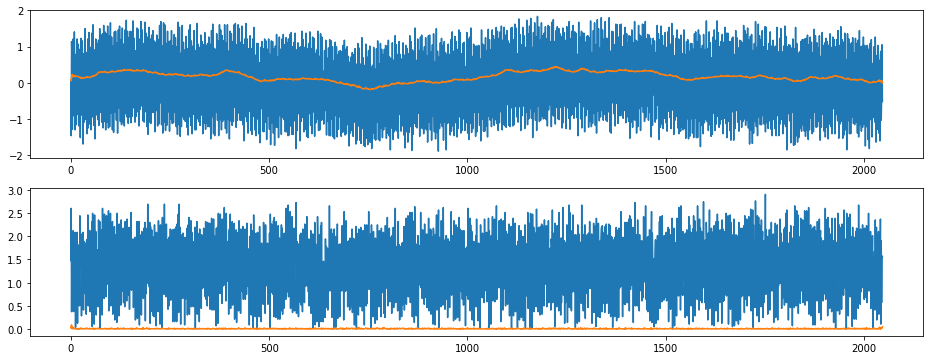

index:  93693
MAE:  0.8885912240344384
n_bunches       418
bunch_index     806
bunch_number    166
Name: 3236, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7481/instability_data/07481_Inst_B1H_Q7_20181128_09h48m56s.h5


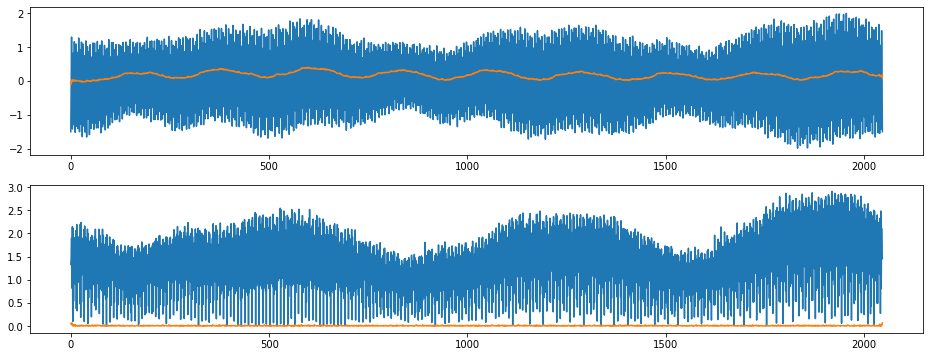

index:  144877
MAE:  0.8884900681267609
n_bunches       572
bunch_index     487
bunch_number    265
Name: 5007, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6246/instability_data/06246_Inst_B1H_Q7_20170927_04h56m36s.h5


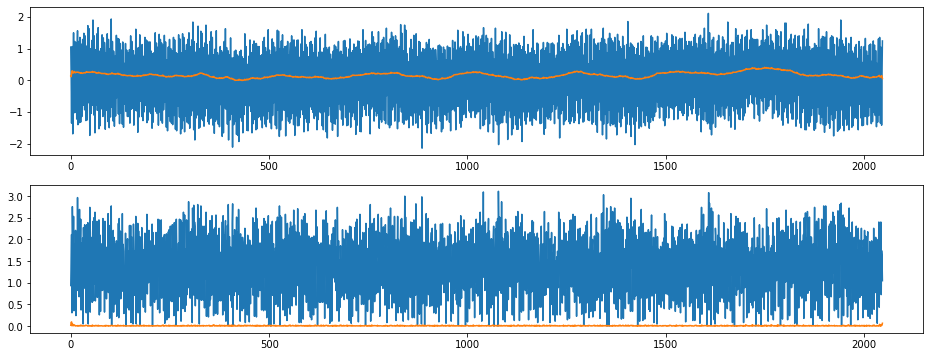

index:  211308
MAE:  0.8883858303884643
n_bunches       987
bunch_index     252
bunch_number     81
Name: 7309, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6706/instability_data/06706_Inst_B1H_Q7_20180520_12h23m14s.h5


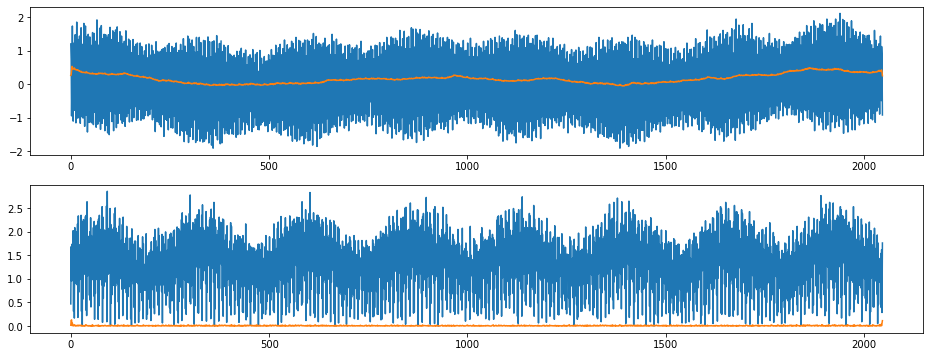

index:  56972
MAE:  0.8883616830030712
n_bunches       444
bunch_index     233
bunch_number     50
Name: 1968, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6990/instability_data/06990_Inst_B1H_Q7_20180727_09h47m15s.h5


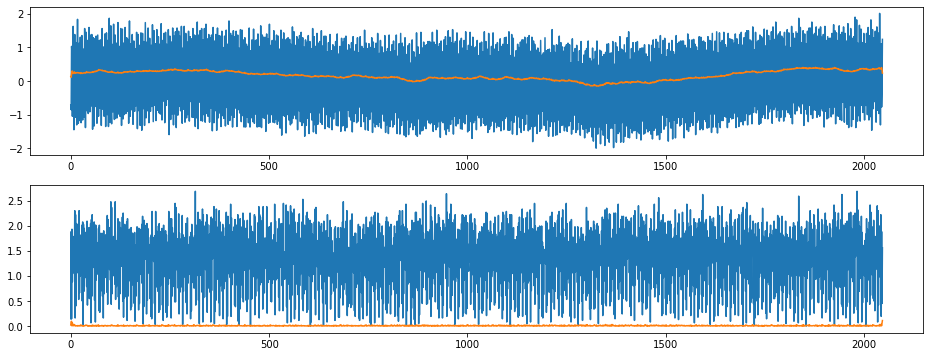

index:  97457
MAE:  0.8883155672688383
n_bunches        418
bunch_index     1391
bunch_number     293
Name: 3363, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7481/instability_data/07481_Inst_B1H_Q7_20181128_09h48m56s.h5


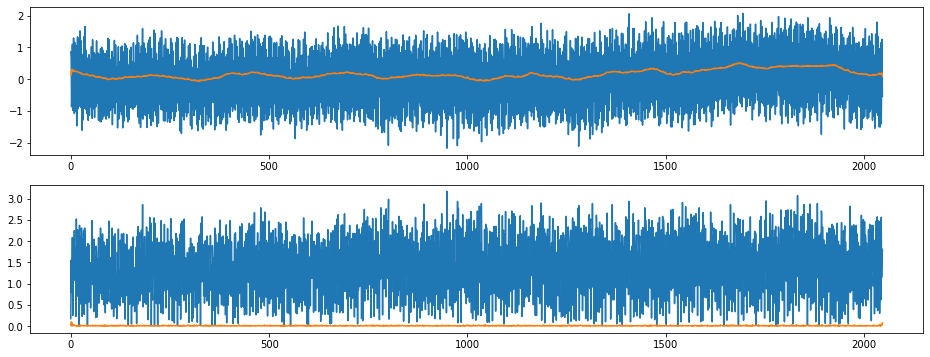

index:  49808
MAE:  0.8881005097970402
n_bunches        733
bunch_index     2515
bunch_number     534
Name: 1719, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


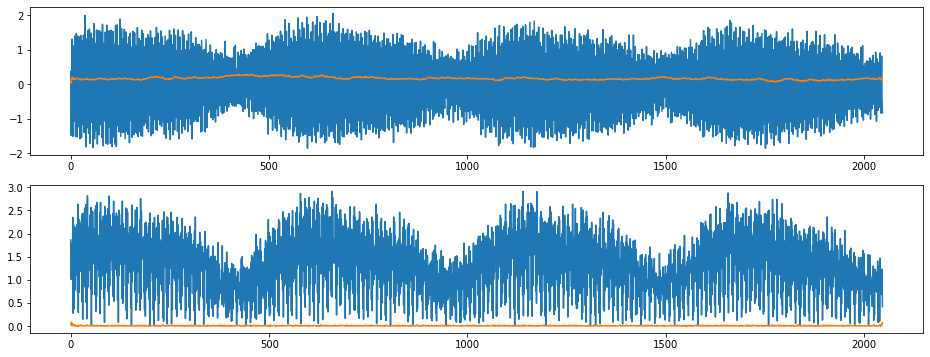

index:  314165
MAE:  0.8880930058478874
n_bunches        648
bunch_index     2267
bunch_number     423
Name: 10898, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7444/instability_data/07444_Inst_B1H_Q7_20181115_07h56m14s.h5


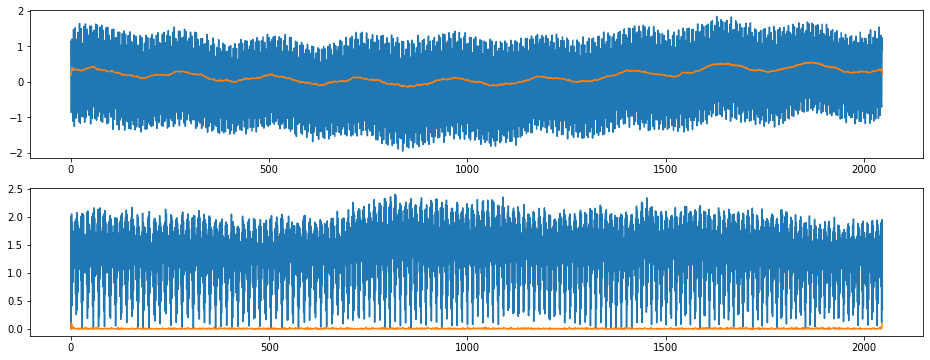

index:  49414
MAE:  0.8879798362908227
n_bunches        733
bunch_index     2455
bunch_number     519
Name: 1704, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


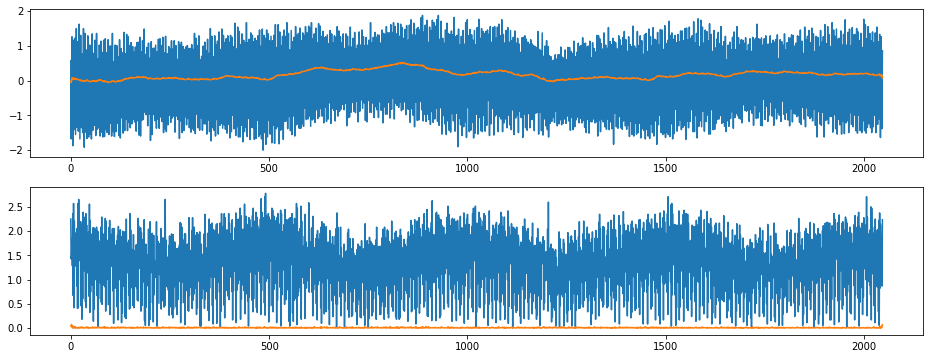

index:  52399
MAE:  0.8878753169190641
n_bunches        733
bunch_index     2967
bunch_number     626
Name: 1811, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


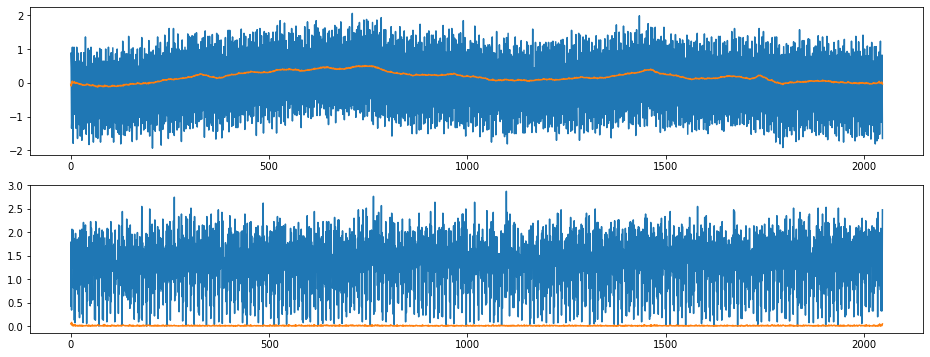

index:  83711
MAE:  0.8878582941688375
n_bunches        456
bunch_index     1210
bunch_number     275
Name: 2889, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7378/instability_data/07378_Inst_B1H_Q7_20181028_22h46m14s.h5


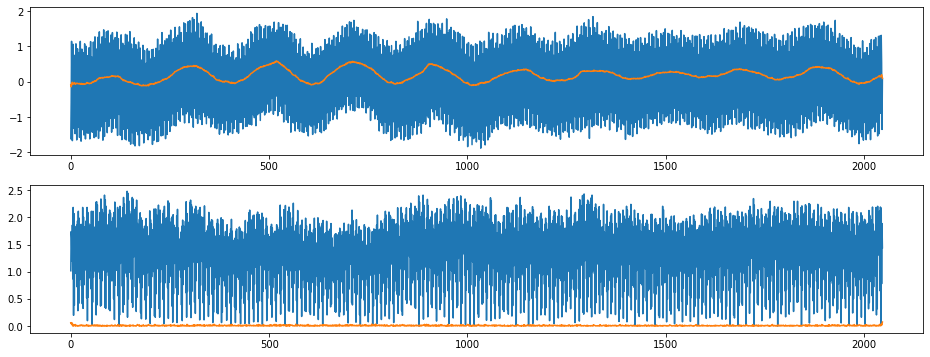

index:  206337
MAE:  0.8878551981412571
n_bunches       1227
bunch_index     3190
bunch_number    1142
Name: 7140, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_11h45m14s.h5


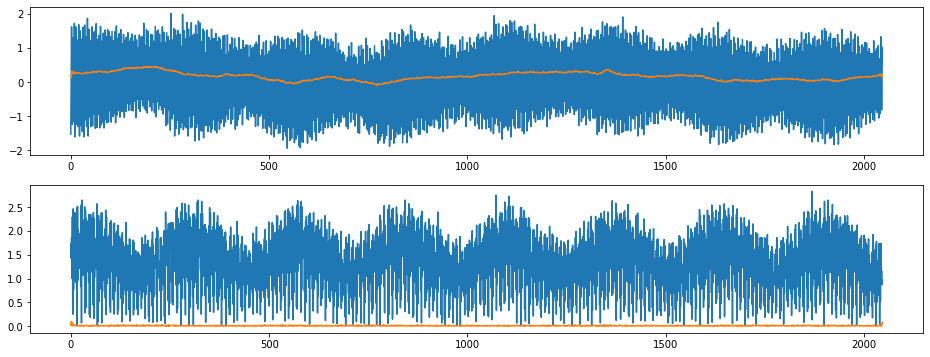

index:  206013
MAE:  0.8878053907664203
n_bunches       1227
bunch_index     3179
bunch_number    1131
Name: 7129, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_11h45m14s.h5


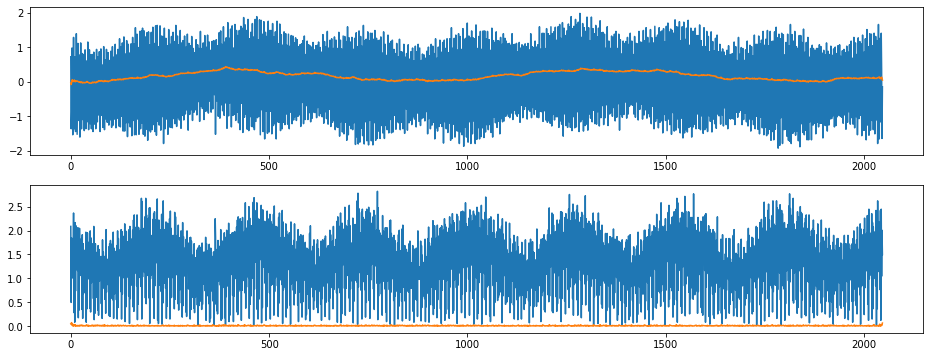

index:  390945
MAE:  0.8878023671788909
n_bunches       396
bunch_index      99
bunch_number     50
Name: 13560, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7122/instability_data/07122_Inst_B1H_Q7_20180903_07h29m11s.h5


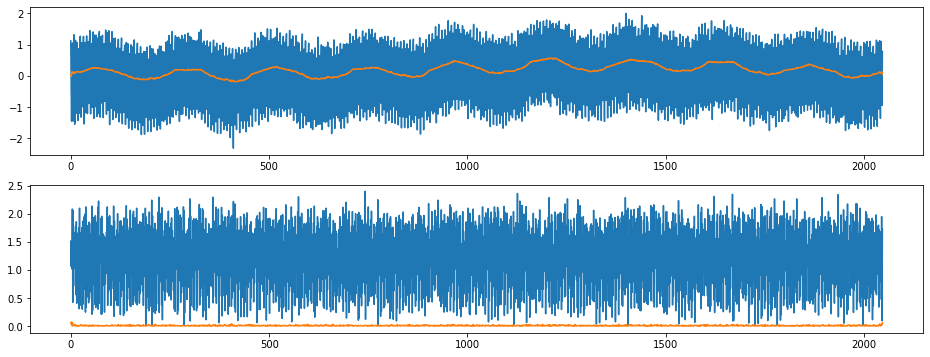

index:  210437
MAE:  0.8877901977730878
n_bunches       987
bunch_index     217
bunch_number     53
Name: 7281, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6706/instability_data/06706_Inst_B1H_Q7_20180520_12h23m14s.h5


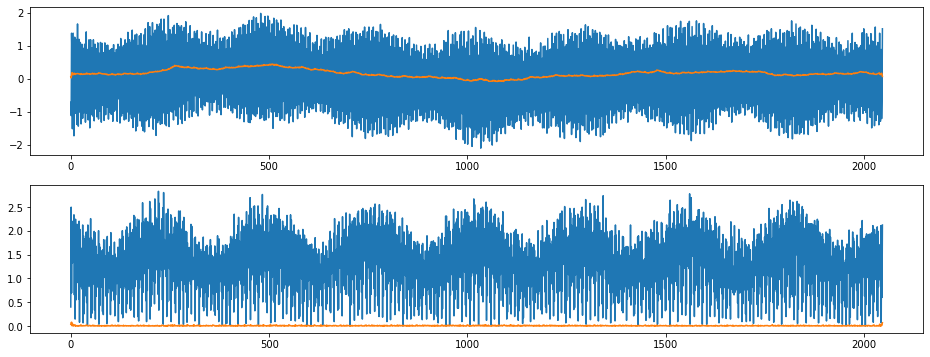

index:  94223
MAE:  0.8877348097452235
n_bunches       418
bunch_index     878
bunch_number    184
Name: 3254, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7481/instability_data/07481_Inst_B1H_Q7_20181128_09h48m56s.h5


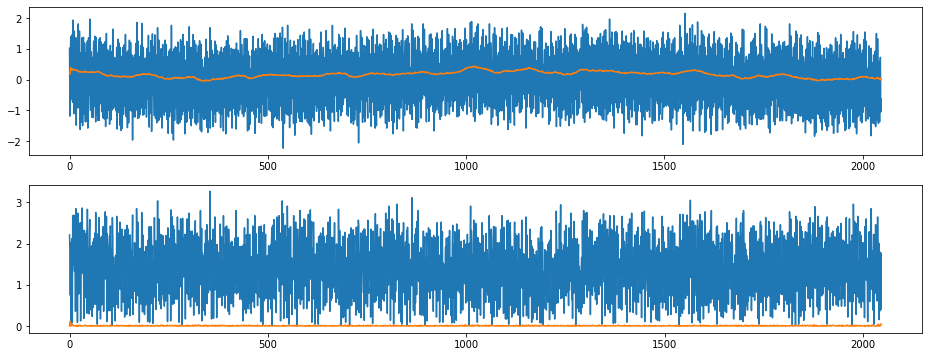

index:  142872
MAE:  0.8877271025964119
n_bunches       572
bunch_index     384
bunch_number    197
Name: 4939, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6246/instability_data/06246_Inst_B1H_Q7_20170927_04h56m36s.h5


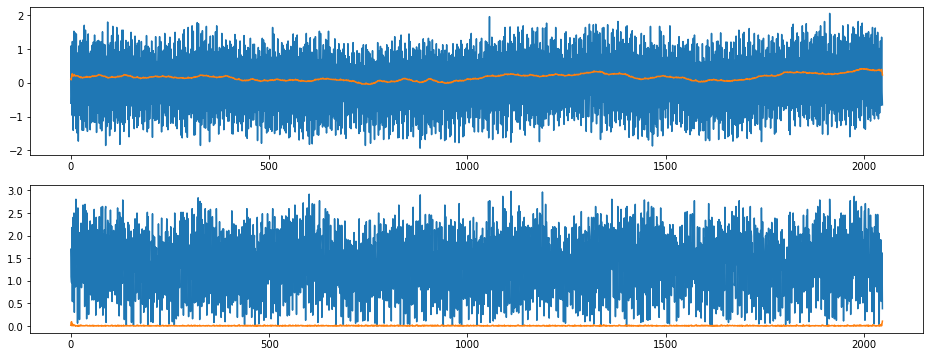

index:  212674
MAE:  0.8877125241052546
n_bunches       987
bunch_index     461
bunch_number    127
Name: 7355, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6706/instability_data/06706_Inst_B1H_Q7_20180520_12h23m14s.h5


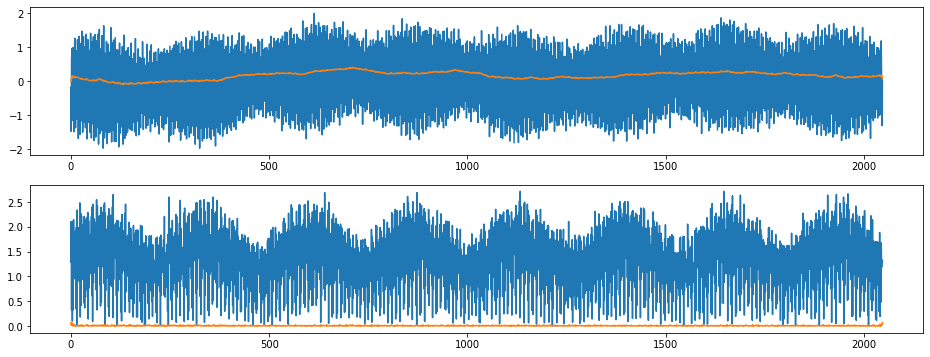

index:  82897
MAE:  0.8876584675930934
n_bunches        456
bunch_index     1175
bunch_number     247
Name: 2861, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7378/instability_data/07378_Inst_B1H_Q7_20181028_22h46m14s.h5


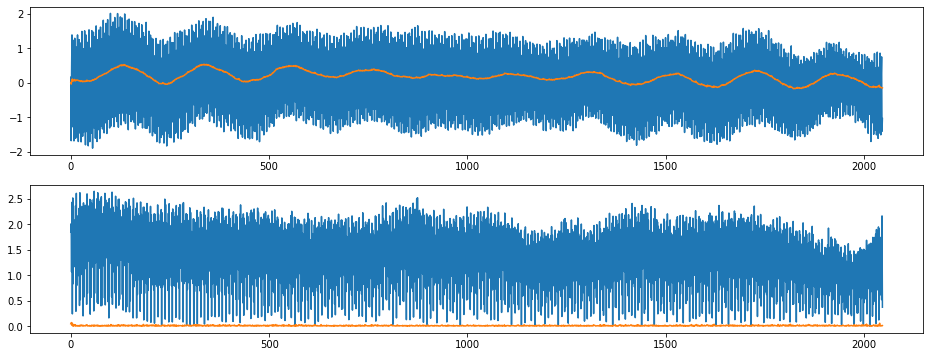

index:  390004
MAE:  0.8875926762883904
n_bunches       396
bunch_index      68
bunch_number     19
Name: 13529, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7122/instability_data/07122_Inst_B1H_Q7_20180903_07h29m11s.h5


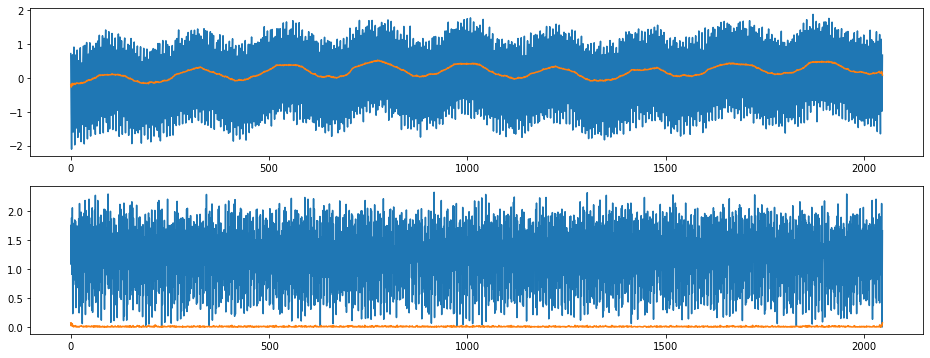

index:  51152
MAE:  0.8874581990742181
n_bunches        733
bunch_index     2761
bunch_number     581
Name: 1766, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


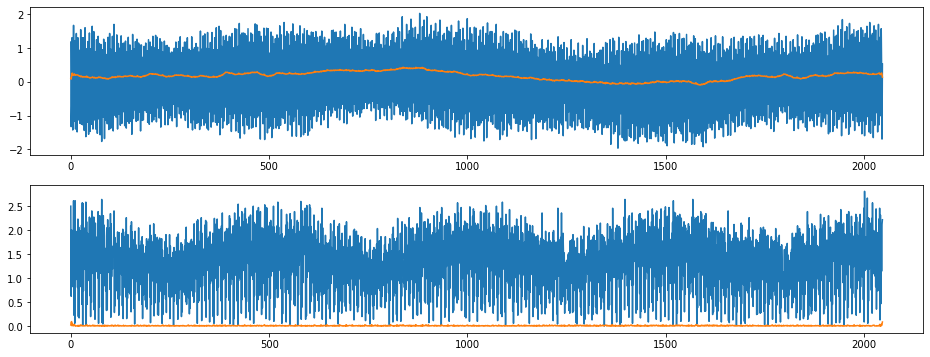

index:  55966
MAE:  0.8873487639471566
n_bunches       444
bunch_index     200
bunch_number     17
Name: 1935, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6990/instability_data/06990_Inst_B1H_Q7_20180727_09h47m15s.h5


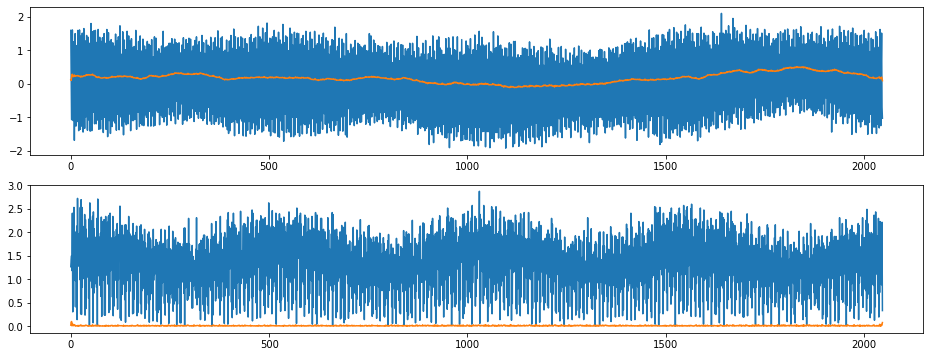

index:  391224
MAE:  0.8872927766668104
n_bunches       396
bunch_index     116
bunch_number     60
Name: 13570, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7122/instability_data/07122_Inst_B1H_Q7_20180903_07h29m11s.h5


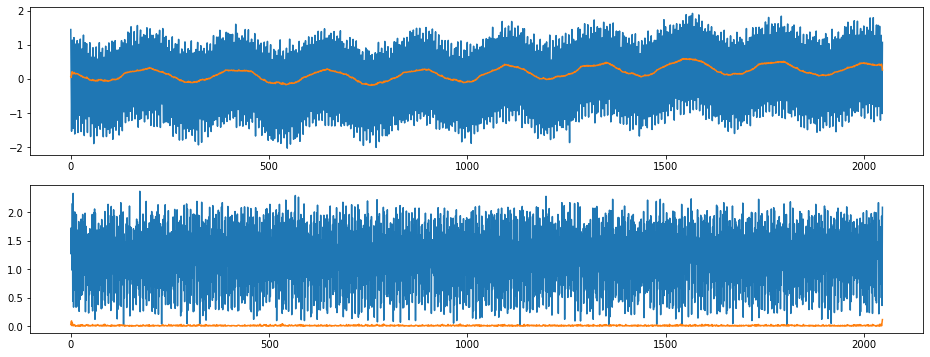

index:  254832
MAE:  0.8871768632417462
n_bunches       372
bunch_index     145
bunch_number     23
Name: 8829, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7448/instability_data/07448_Inst_B1H_Q7_20181116_07h25m20s.h5


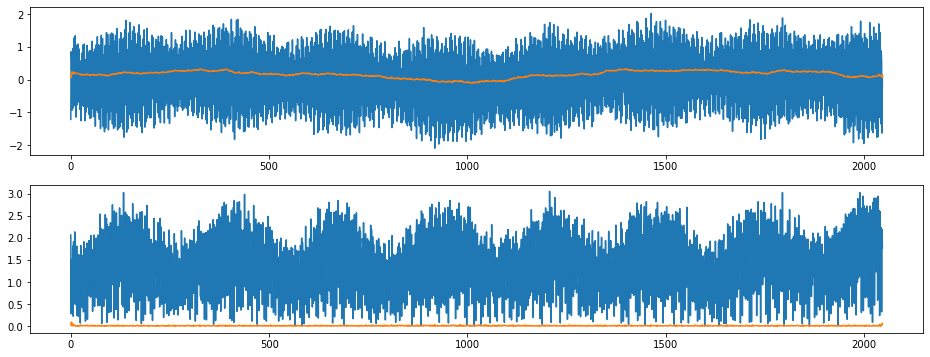

index:  96863
MAE:  0.8871057355302536
n_bunches        418
bunch_index     1316
bunch_number     274
Name: 3344, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7481/instability_data/07481_Inst_B1H_Q7_20181128_09h48m56s.h5


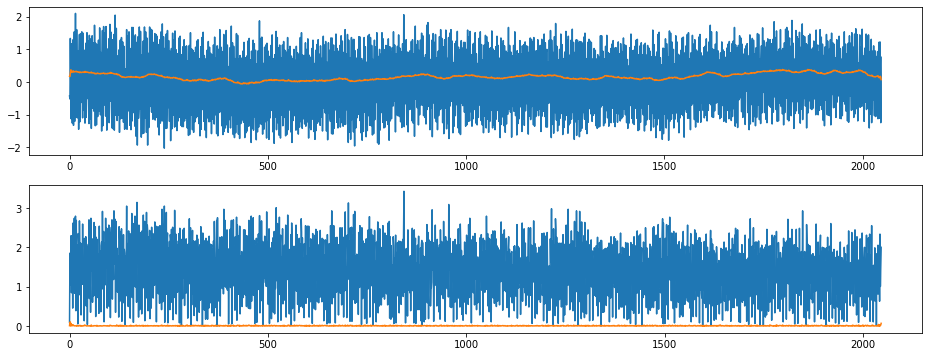

index:  49279
MAE:  0.8870573334756855
n_bunches        733
bunch_index     2431
bunch_number     513
Name: 1698, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


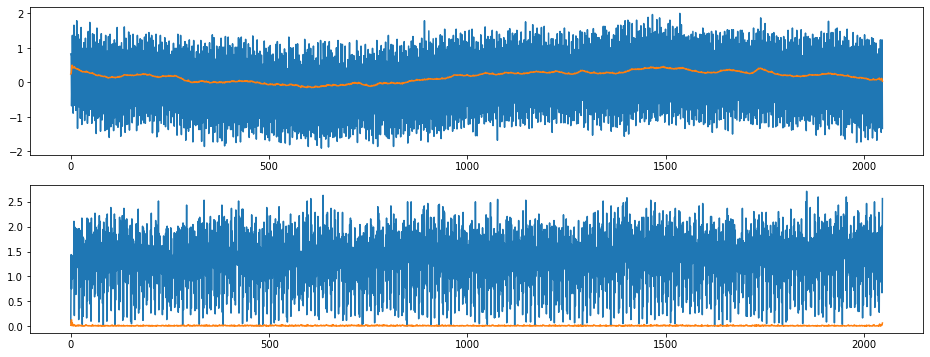

index:  212817
MAE:  0.8869854165064656
n_bunches       987
bunch_index     466
bunch_number    132
Name: 7360, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6706/instability_data/06706_Inst_B1H_Q7_20180520_12h23m14s.h5


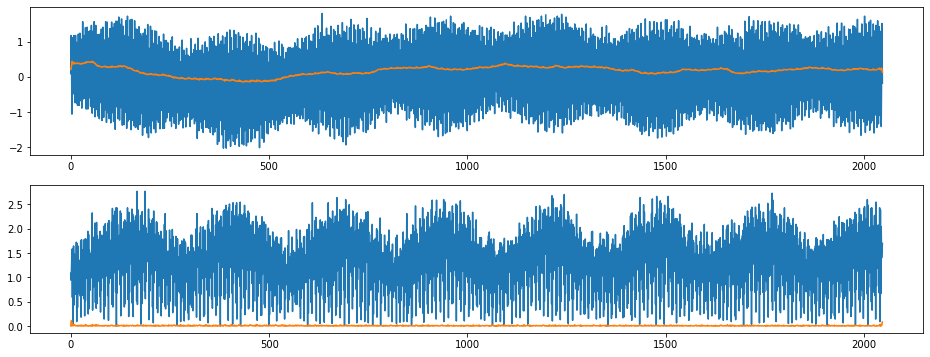

index:  389291
MAE:  0.886974049604647
n_bunches       636
bunch_index     865
bunch_number    632
Name: 13506, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7037/instability_data/07037_Inst_B1H_Q7_20180808_02h43m34s.h5


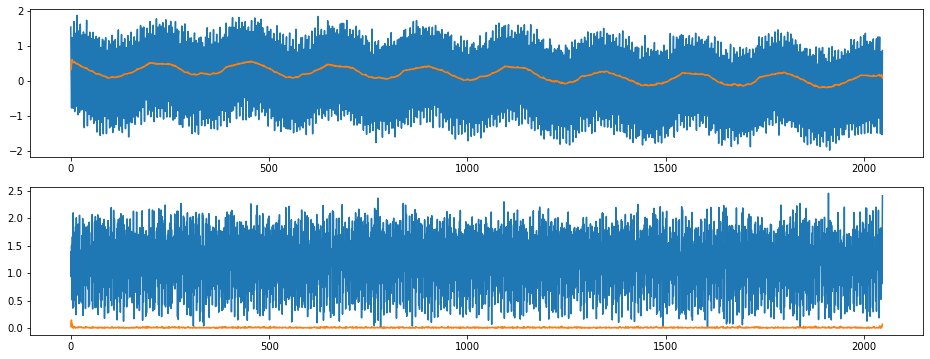

index:  389105
MAE:  0.8869714702578699
n_bunches       636
bunch_index     858
bunch_number    625
Name: 13499, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7037/instability_data/07037_Inst_B1H_Q7_20180808_02h43m34s.h5


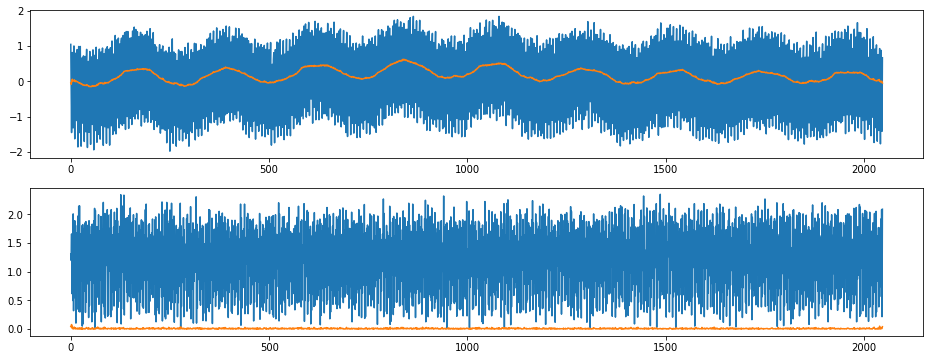

index:  316554
MAE:  0.8868954366027861
n_bunches        648
bunch_index     2746
bunch_number     511
Name: 10986, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7444/instability_data/07444_Inst_B1H_Q7_20181115_07h56m14s.h5


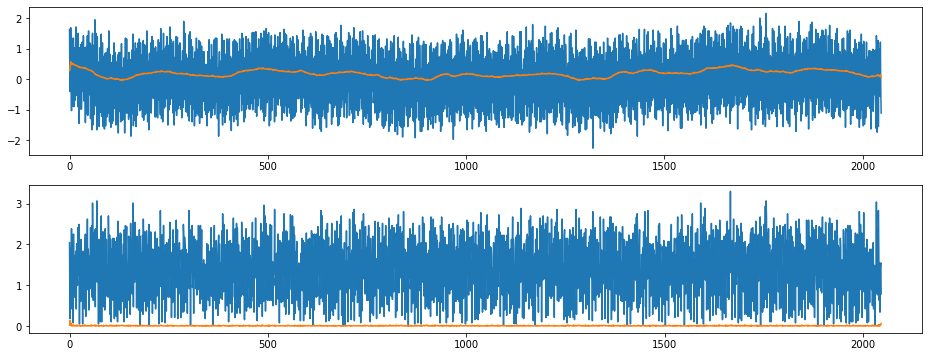

index:  56759
MAE:  0.8868727979653865
n_bunches       444
bunch_index     226
bunch_number     43
Name: 1961, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6990/instability_data/06990_Inst_B1H_Q7_20180727_09h47m15s.h5


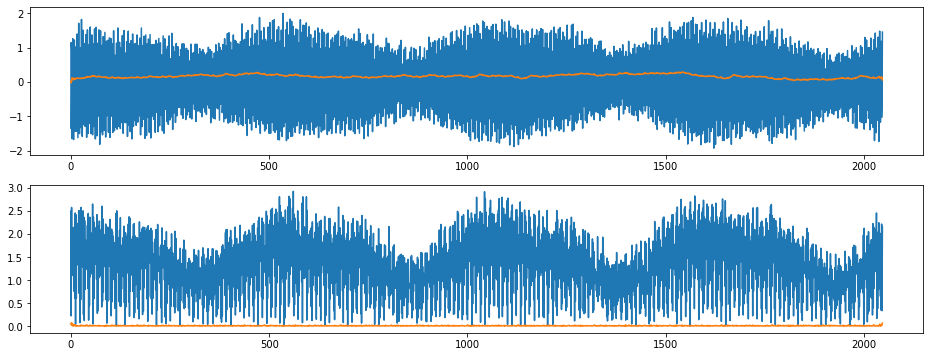

index:  54230
MAE:  0.8867690441549121
n_bunches        733
bunch_index     3280
bunch_number     691
Name: 1876, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


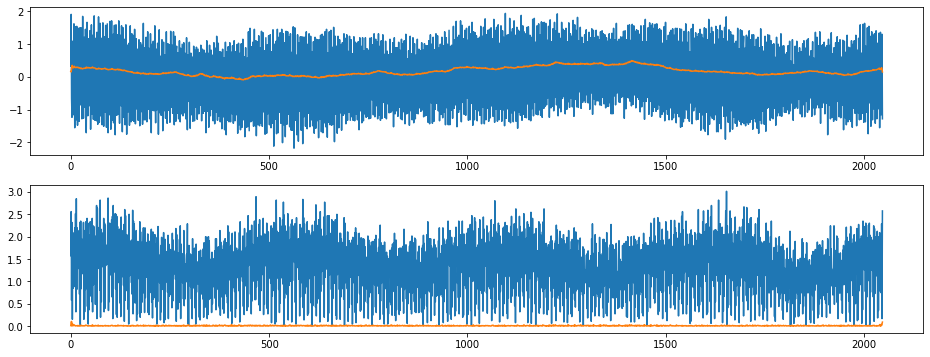

index:  53988
MAE:  0.8867494111898943
n_bunches        733
bunch_index     3221
bunch_number     683
Name: 1868, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


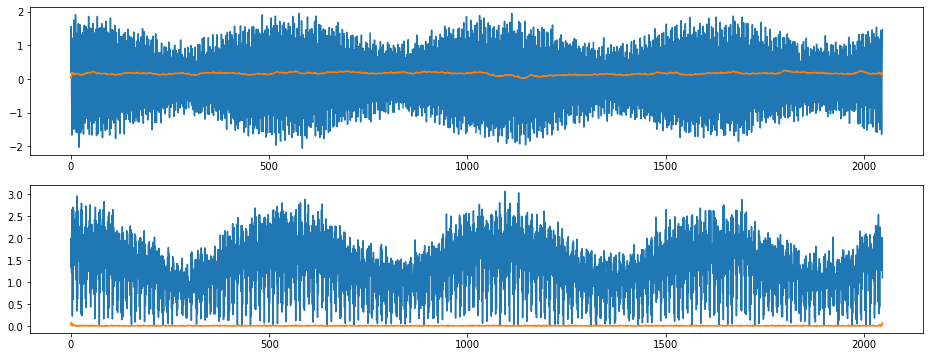

index:  259979
MAE:  0.8864015384648898
n_bunches        372
bunch_index     1090
bunch_number     203
Name: 9009, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7448/instability_data/07448_Inst_B1H_Q7_20181116_07h25m20s.h5


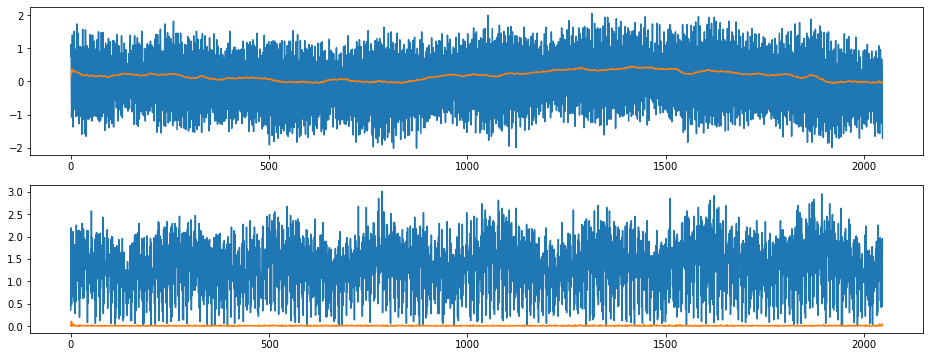

index:  26241
MAE:  0.8863951376773287
n_bunches        972
bunch_index     1310
bunch_number     684
Name: 897, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6272/instability_data/06272_Inst_B1H_Q7_20171005_01h30m07s.h5


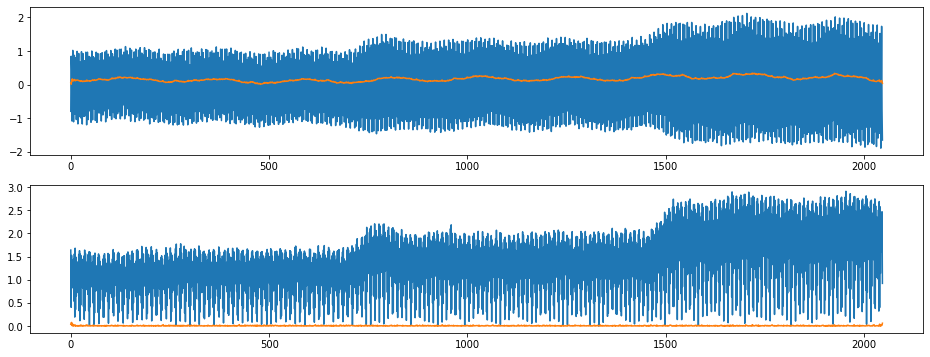

index:  207647
MAE:  0.88635759678824
n_bunches       1227
bunch_index     3240
bunch_number    1185
Name: 7183, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_11h45m14s.h5


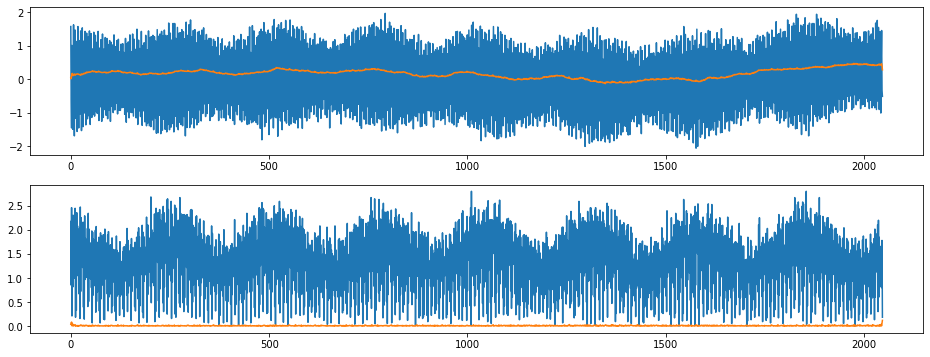

index:  255557
MAE:  0.8862142627958403
n_bunches       372
bunch_index     285
bunch_number     48
Name: 8854, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7448/instability_data/07448_Inst_B1H_Q7_20181116_07h25m20s.h5


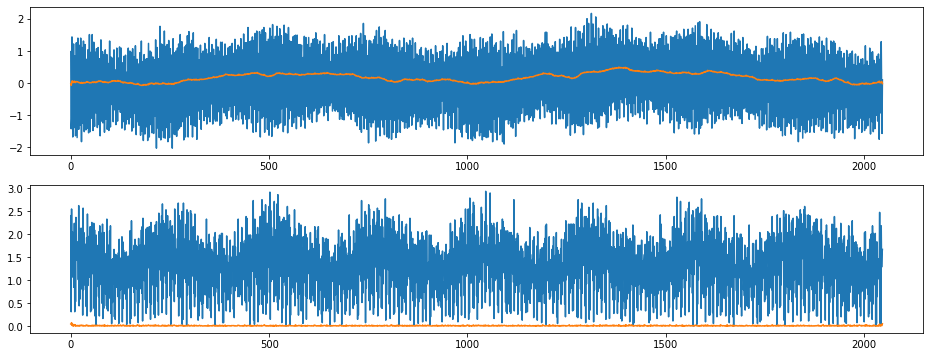

index:  56949
MAE:  0.8862122143272964
n_bunches       444
bunch_index     232
bunch_number     49
Name: 1967, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6990/instability_data/06990_Inst_B1H_Q7_20180727_09h47m15s.h5


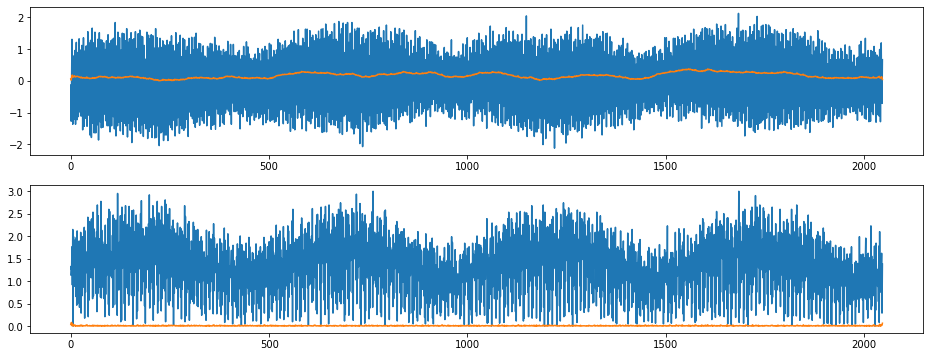

index:  50890
MAE:  0.8861846043570314
n_bunches        733
bunch_index     2728
bunch_number     573
Name: 1758, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


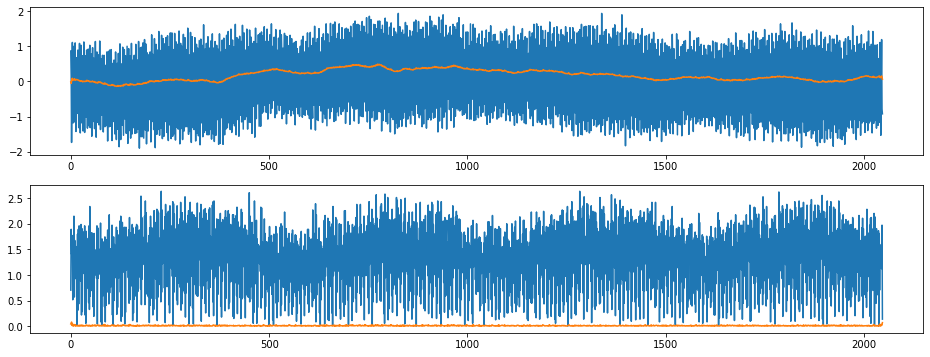

index:  145012
MAE:  0.8860534545038603
n_bunches       572
bunch_index     495
bunch_number    269
Name: 5011, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6246/instability_data/06246_Inst_B1H_Q7_20170927_04h56m36s.h5


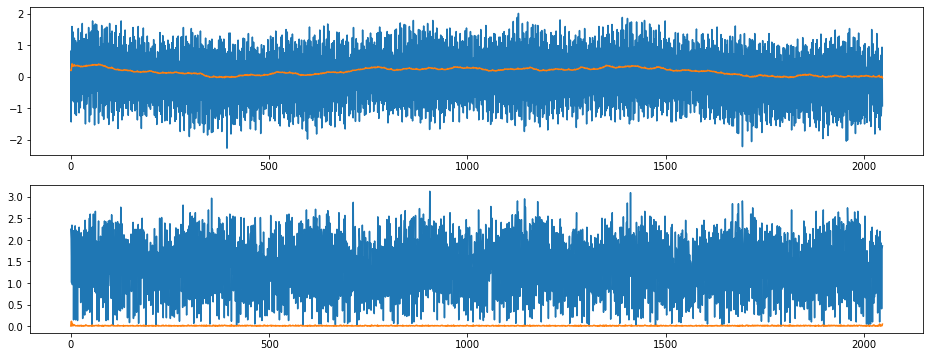

index:  143143
MAE:  0.8860359027119569
n_bunches       572
bunch_index     397
bunch_number    206
Name: 4948, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6246/instability_data/06246_Inst_B1H_Q7_20170927_04h56m36s.h5


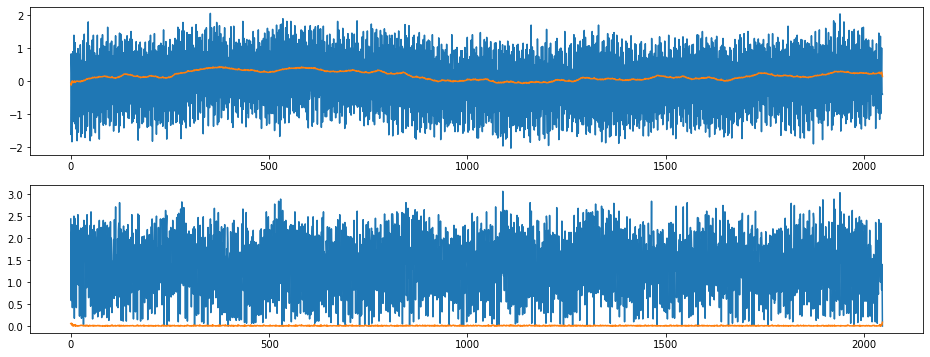

index:  288373
MAE:  0.8858731452753897
n_bunches        648
bunch_index     1833
bunch_number     338
Name: 10007, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7446/instability_data/07446_Inst_B1H_Q7_20181116_02h46m18s.h5


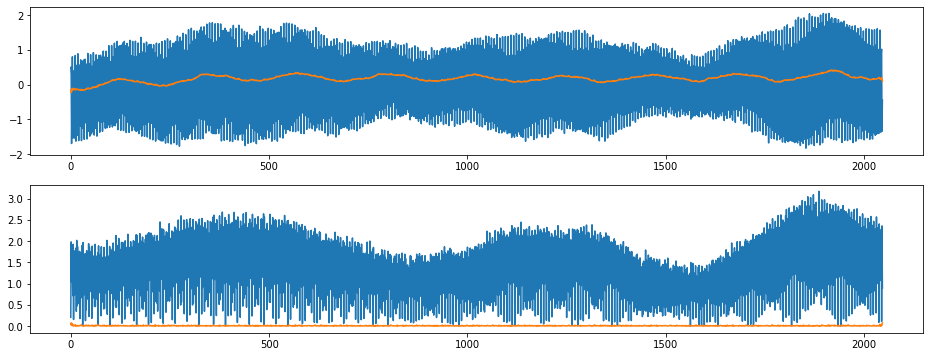

index:  49758
MAE:  0.8857397851101048
n_bunches        733
bunch_index     2509
bunch_number     532
Name: 1717, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


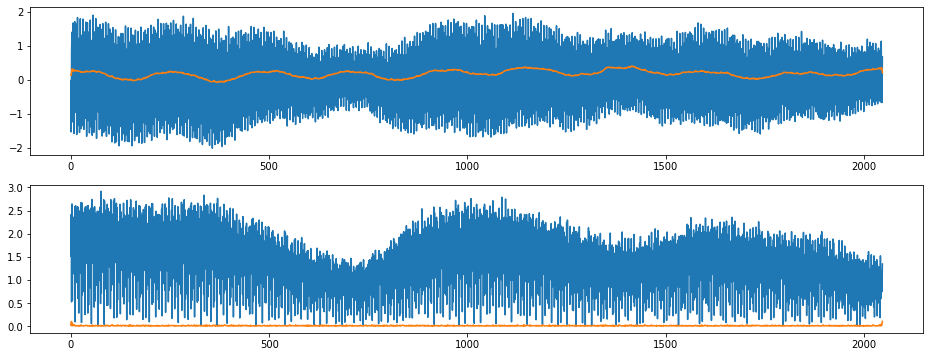

index:  176652
MAE:  0.8855411538557124
n_bunches       1227
bunch_index      236
bunch_number     105
Name: 6103, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_11h45m14s.h5


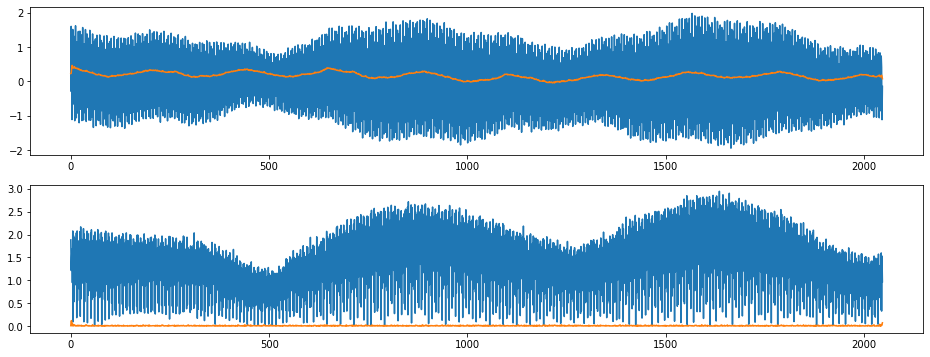

index:  27268
MAE:  0.8855083561824773
n_bunches        972
bunch_index     1367
bunch_number     722
Name: 935, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6272/instability_data/06272_Inst_B1H_Q7_20171005_01h30m07s.h5


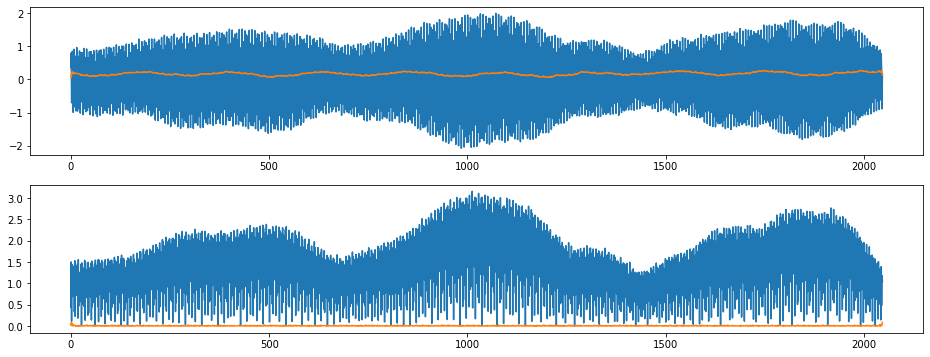

index:  97907
MAE:  0.8854685889422655
n_bunches        418
bunch_index     1451
bunch_number     308
Name: 3378, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7481/instability_data/07481_Inst_B1H_Q7_20181128_09h48m56s.h5


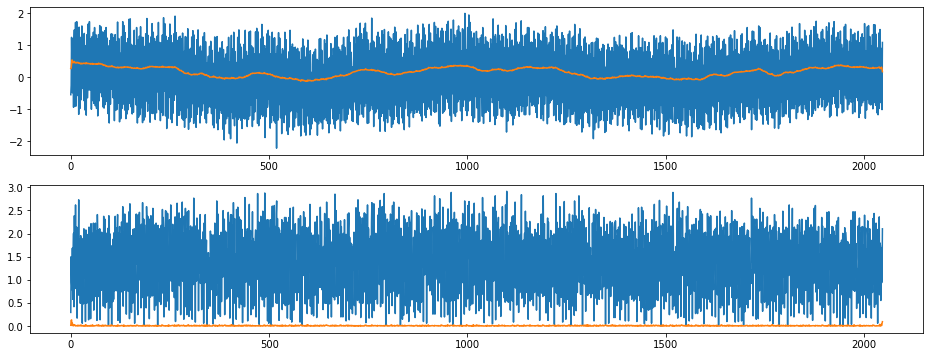

index:  254019
MAE:  0.8854051326402922
n_bunches       12
bunch_index      6
bunch_number     6
Name: 8800, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6571/instability_data/06571_Inst_B1H_Q7_20180417_21h45m14s.h5


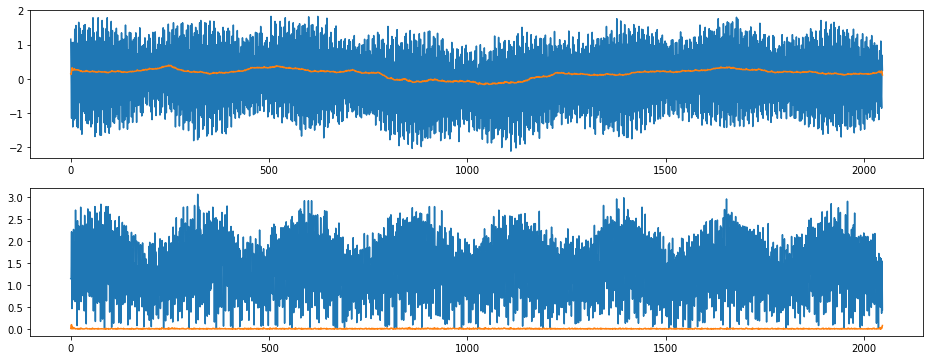

index:  90868
MAE:  0.8853359121809135
n_bunches       418
bunch_index     333
bunch_number     69
Name: 3139, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7481/instability_data/07481_Inst_B1H_Q7_20181128_09h48m56s.h5


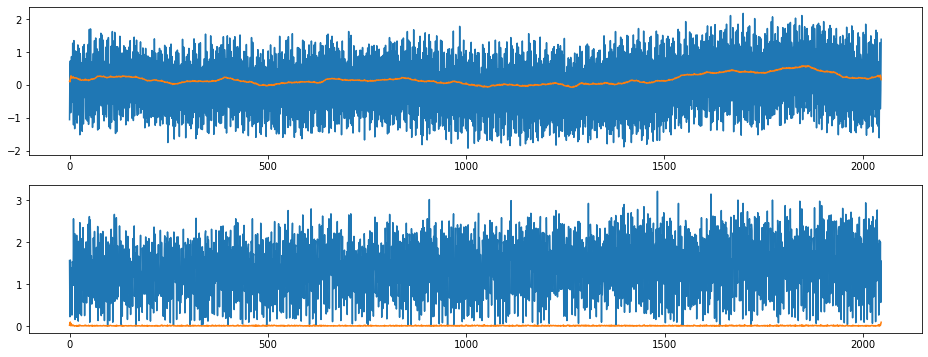

index:  145843
MAE:  0.8851750365388431
n_bunches       572
bunch_index     561
bunch_number    296
Name: 5038, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6246/instability_data/06246_Inst_B1H_Q7_20170927_04h56m36s.h5


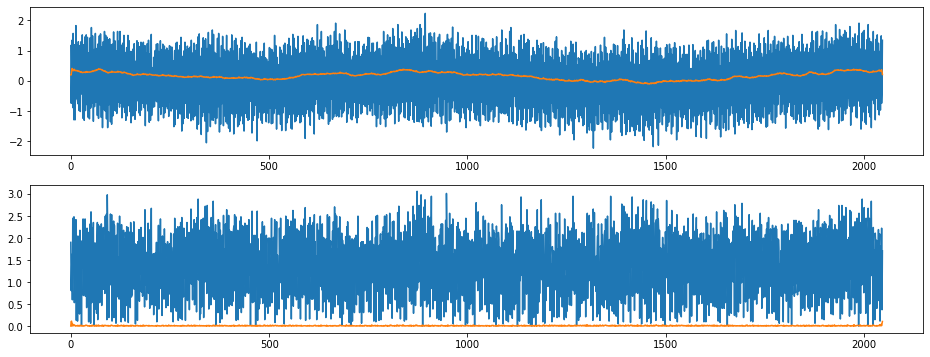

index:  391321
MAE:  0.8851334111576761
n_bunches       396
bunch_index     119
bunch_number     63
Name: 13573, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7122/instability_data/07122_Inst_B1H_Q7_20180903_07h29m11s.h5


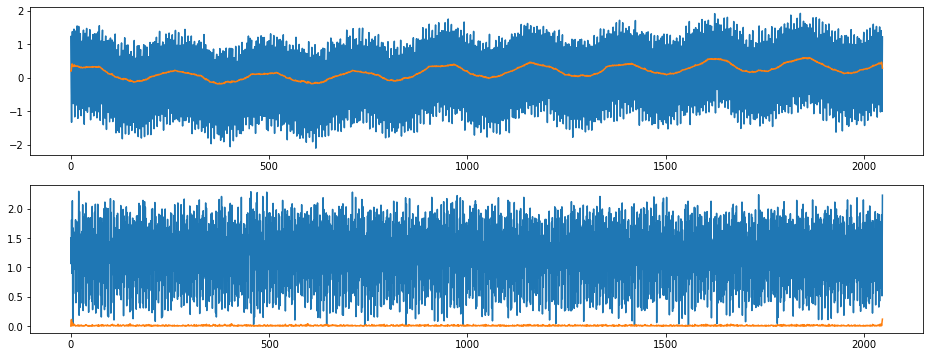

index:  145598
MAE:  0.8848212532305776
n_bunches       572
bunch_index     521
bunch_number    287
Name: 5029, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6246/instability_data/06246_Inst_B1H_Q7_20170927_04h56m36s.h5


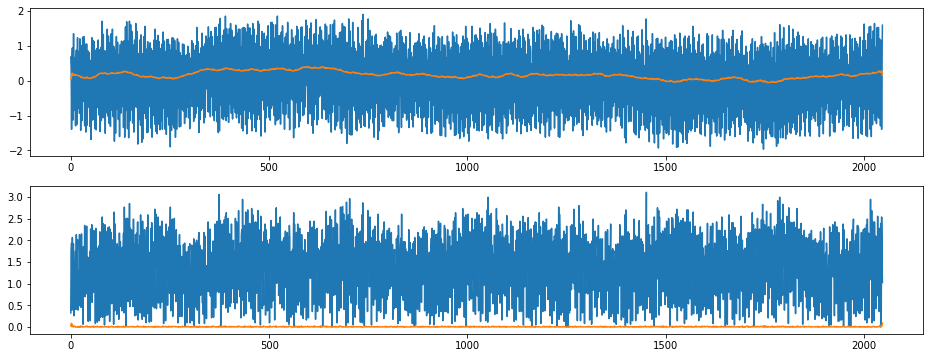

index:  361673
MAE:  0.8847962005976728
n_bunches       376
bunch_index     267
bunch_number     52
Name: 12550, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7468/instability_data/07468_Inst_B1H_Q7_20181123_19h34m32s.h5


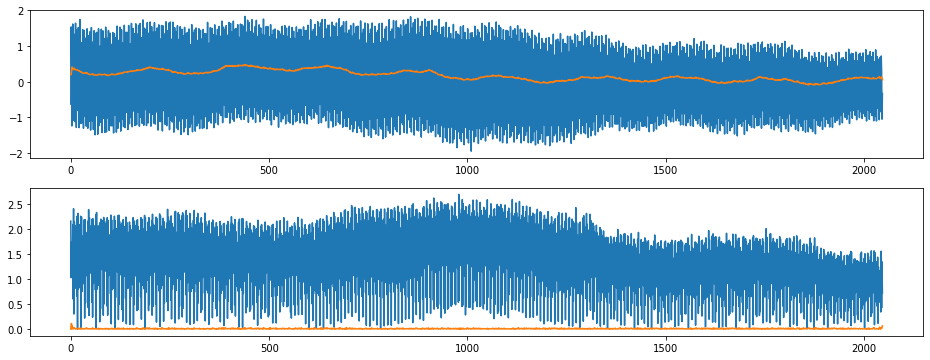

index:  143274
MAE:  0.8845008570583693
n_bunches       572
bunch_index     401
bunch_number    210
Name: 4952, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6246/instability_data/06246_Inst_B1H_Q7_20170927_04h56m36s.h5


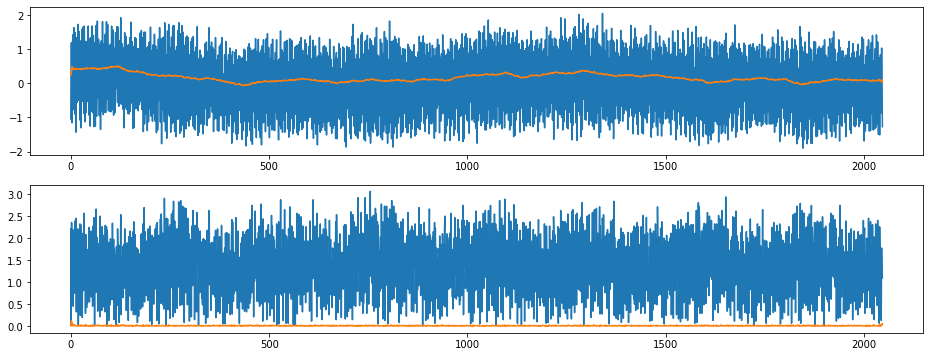

index:  259540
MAE:  0.8844395308526856
n_bunches        372
bunch_index     1014
bunch_number     186
Name: 8992, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7448/instability_data/07448_Inst_B1H_Q7_20181116_07h25m20s.h5


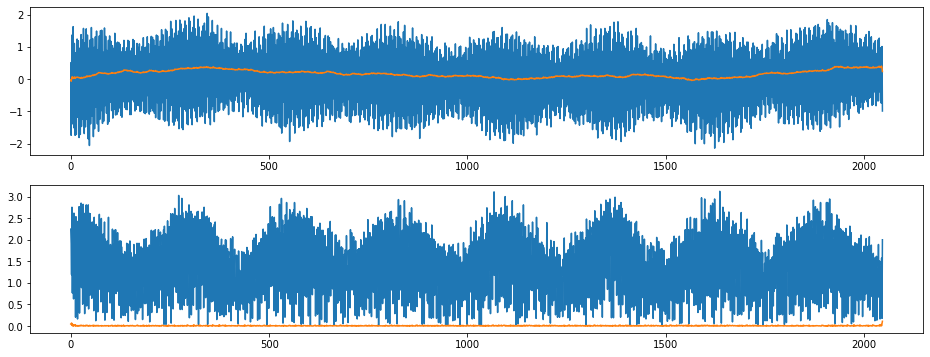

index:  49646
MAE:  0.8842233629494358
n_bunches        733
bunch_index     2491
bunch_number     528
Name: 1713, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


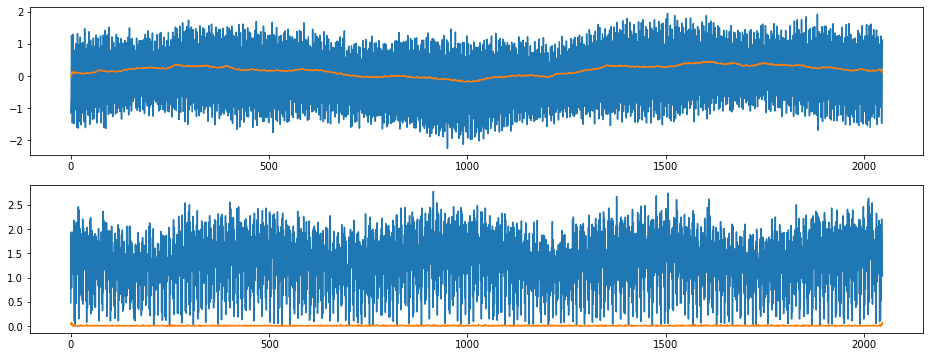

index:  259528
MAE:  0.8839174472598712
n_bunches        372
bunch_index     1014
bunch_number     186
Name: 8992, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7448/instability_data/07448_Inst_B1H_Q7_20181116_07h25m20s.h5


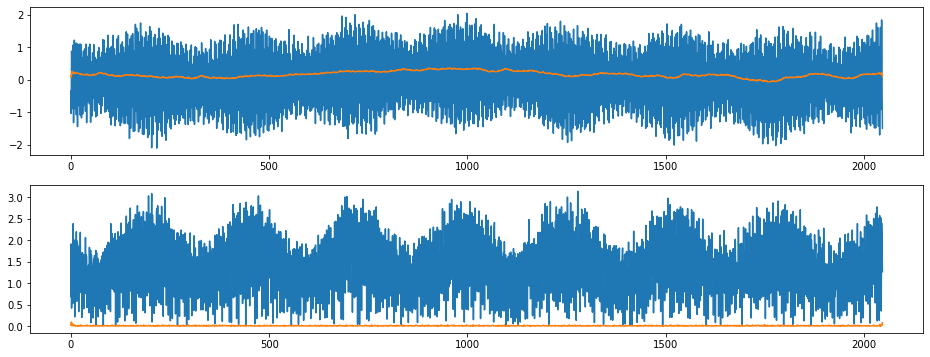

index:  50371
MAE:  0.8838757782616153
n_bunches        733
bunch_index     2630
bunch_number     555
Name: 1740, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


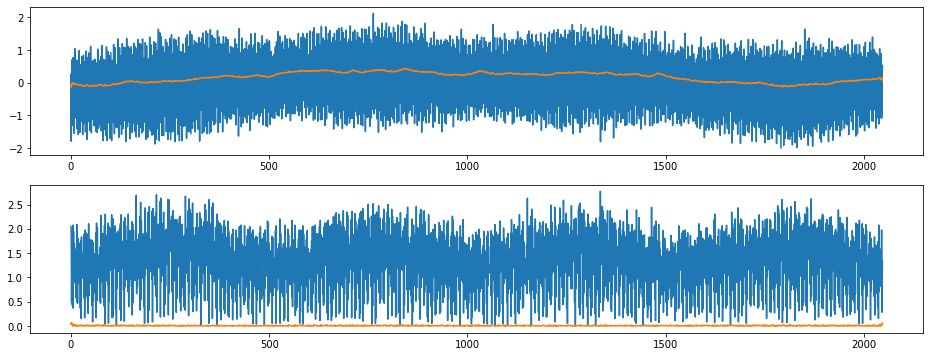

index:  141500
MAE:  0.8837965202833054
n_bunches       572
bunch_index     288
bunch_number    152
Name: 4894, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6246/instability_data/06246_Inst_B1H_Q7_20170927_04h56m36s.h5


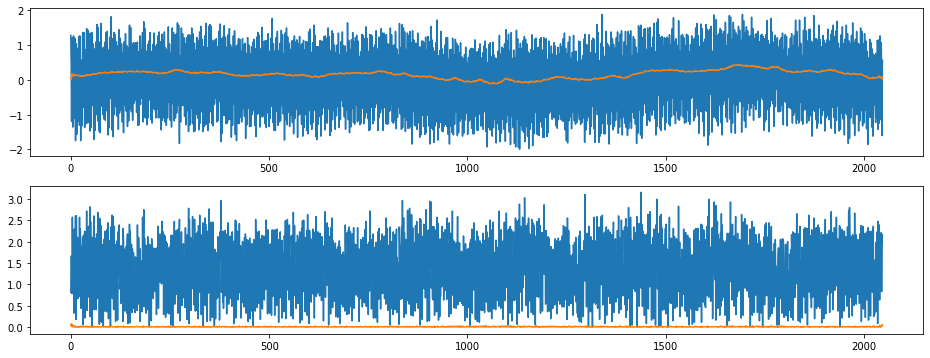

index:  141292
MAE:  0.8837259826498475
n_bunches       572
bunch_index     278
bunch_number    146
Name: 4888, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6246/instability_data/06246_Inst_B1H_Q7_20170927_04h56m36s.h5


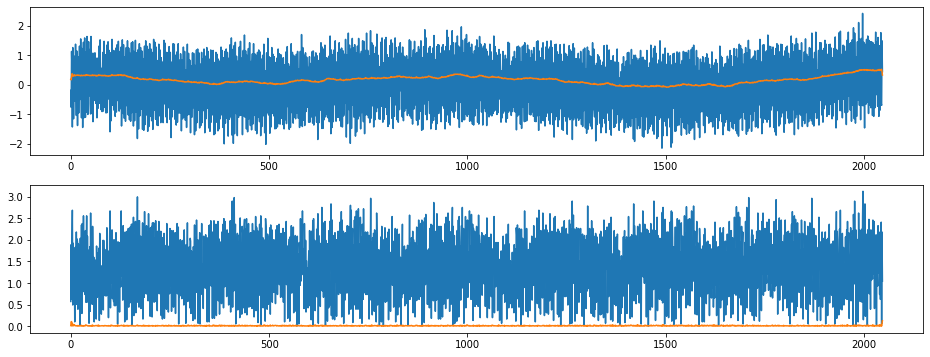

index:  96689
MAE:  0.8836668187453449
n_bunches        418
bunch_index     1269
bunch_number     269
Name: 3339, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7481/instability_data/07481_Inst_B1H_Q7_20181128_09h48m56s.h5


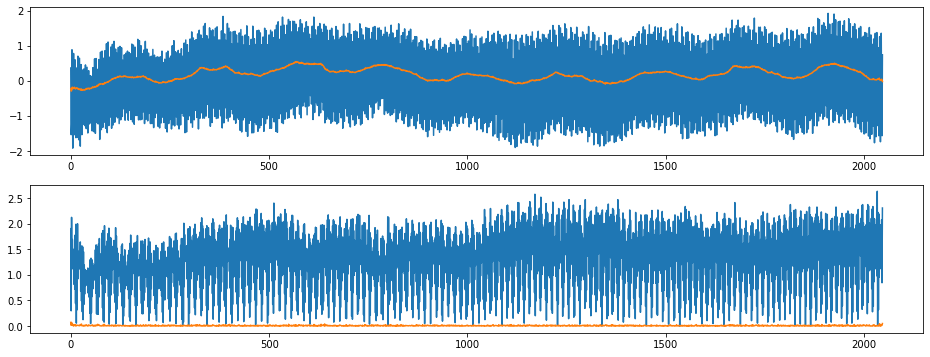

index:  145395
MAE:  0.8836292006293448
n_bunches       572
bunch_index     511
bunch_number    281
Name: 5023, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6246/instability_data/06246_Inst_B1H_Q7_20170927_04h56m36s.h5


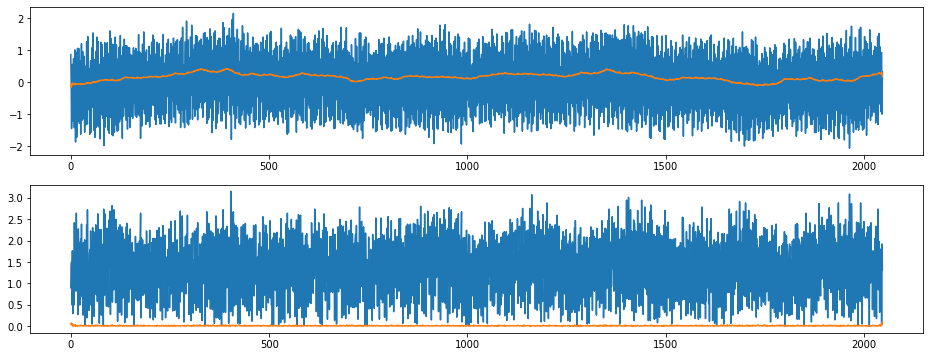

index:  50907
MAE:  0.8834363545514677
n_bunches        733
bunch_index     2728
bunch_number     573
Name: 1758, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


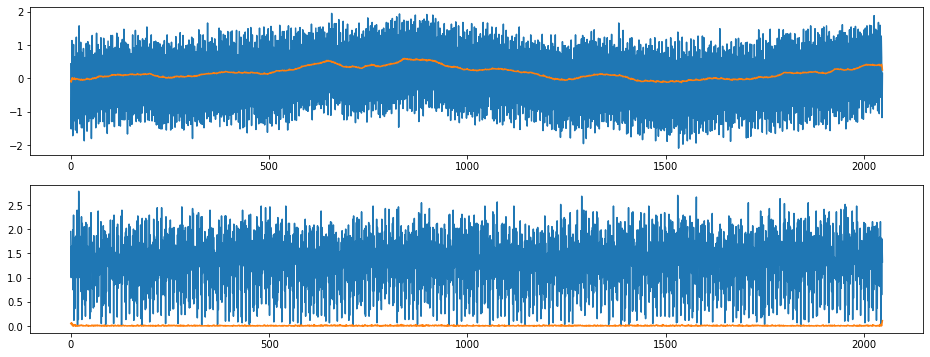

index:  140113
MAE:  0.8833980109910737
n_bunches       572
bunch_index     221
bunch_number    108
Name: 4850, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6246/instability_data/06246_Inst_B1H_Q7_20170927_04h56m36s.h5


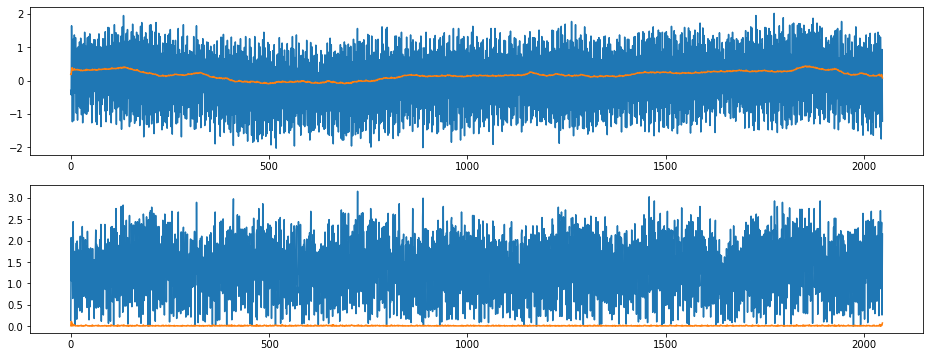

index:  41985
MAE:  0.8832833605401129
n_bunches        733
bunch_index     1221
bunch_number     257
Name: 1442, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


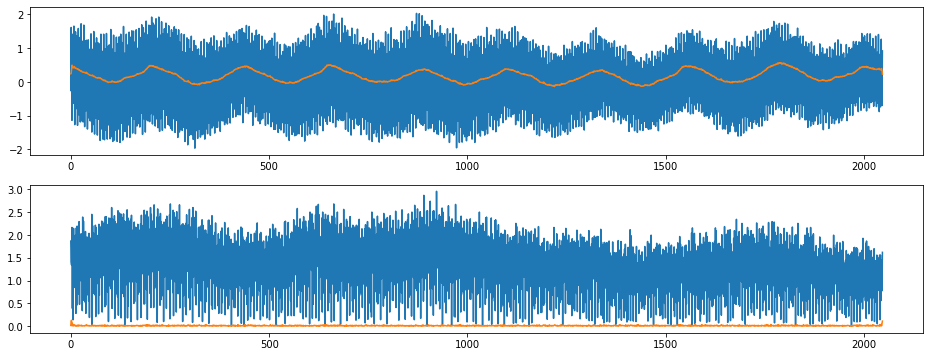

index:  256798
MAE:  0.8832763939871341
n_bunches       372
bunch_index     509
bunch_number     92
Name: 8898, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7448/instability_data/07448_Inst_B1H_Q7_20181116_07h25m20s.h5


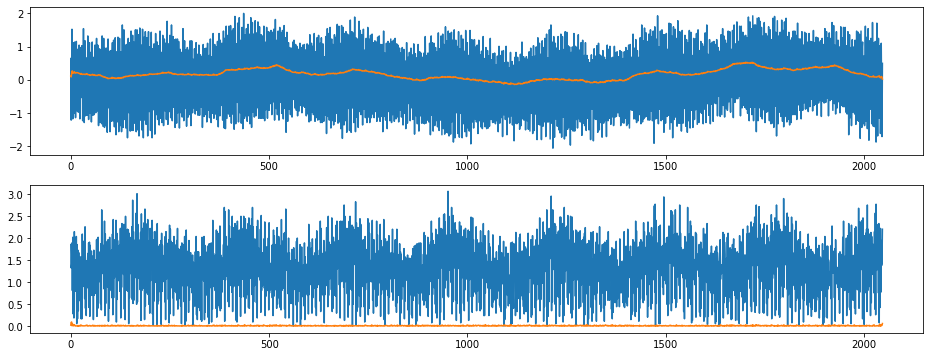

index:  91502
MAE:  0.8832269481105235
n_bunches       418
bunch_index     449
bunch_number     91
Name: 3161, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7481/instability_data/07481_Inst_B1H_Q7_20181128_09h48m56s.h5


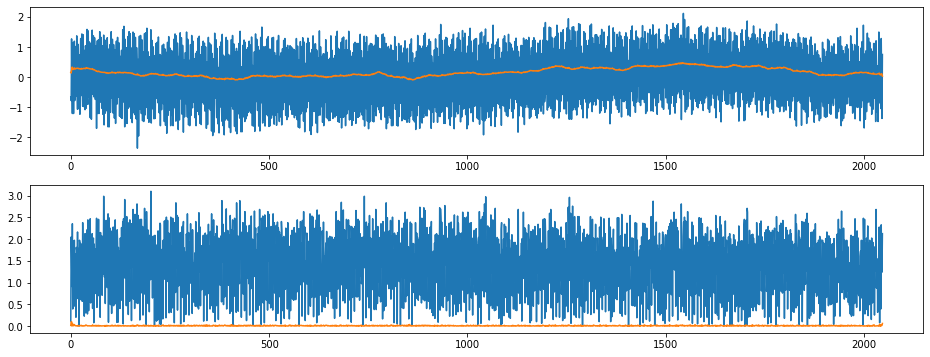

index:  51050
MAE:  0.8831957815336984
n_bunches        733
bunch_index     2749
bunch_number     578
Name: 1763, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


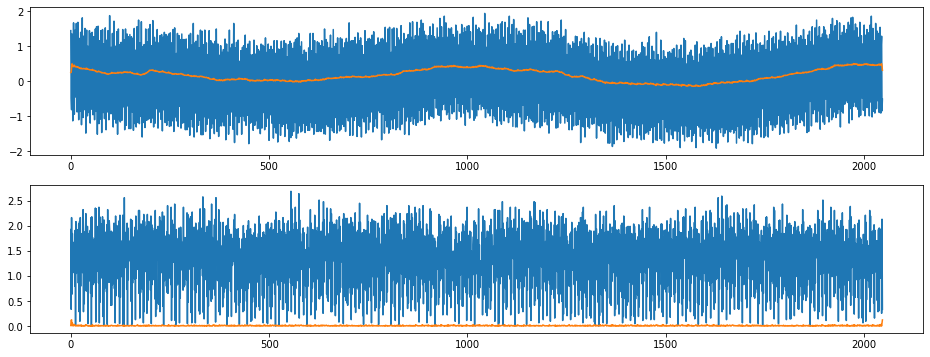

In [20]:
for i in range(200):
    anomalous = i
    anomalous_index = max_MAE_indices[anomalous]

    print('index: ', anomalous_index)
    print("MAE: ", MAE_train[anomalous_index])
    # I'm not sure this row is correct
    metadata_row = train_generator.metadata.iloc[anomalous_index // 32]
    print(metadata_row[['n_bunches', 'bunch_index', 'bunch_number']])
    print(metadata_row['file'])

    true_signal = train_dataset[anomalous_index].squeeze()
    pred_signal = train_pred[anomalous_index].squeeze()

    plot_true_pred(true_signal, pred_signal)
    plt.show()

# Top leftmost signals

index:  190484
MAE:  0.1808497986190896
n_bunches       1227
bunch_index     1486
bunch_number     593
Name: 6591, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_11h45m14s.h5


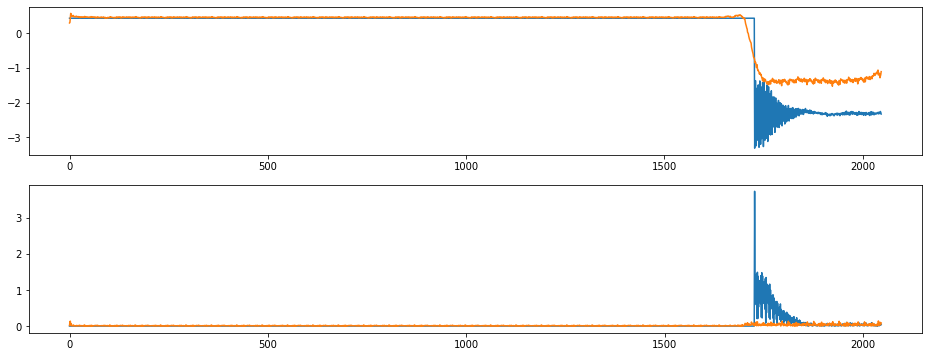

index:  12298
MAE:  0.18578387999596022
n_bunches       972
bunch_index     428
bunch_number    212
Name: 425, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6272/instability_data/06272_Inst_B1H_Q7_20171005_01h30m07s.h5


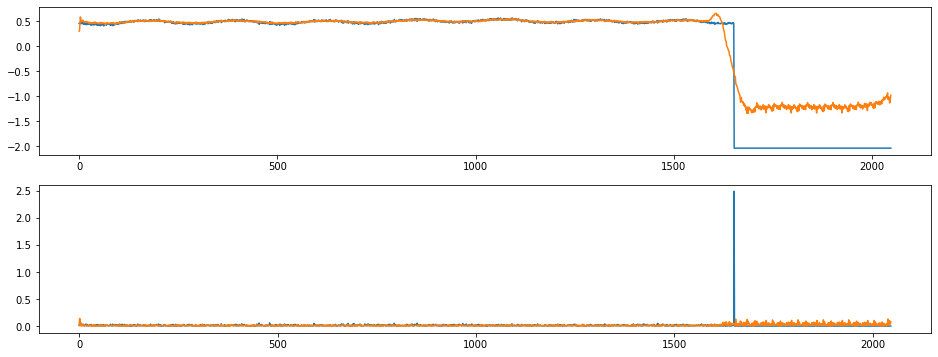

index:  91872
MAE:  0.19677268751205257
n_bunches       418
bunch_index     497
bunch_number    103
Name: 3173, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7481/instability_data/07481_Inst_B1H_Q7_20181128_09h48m56s.h5


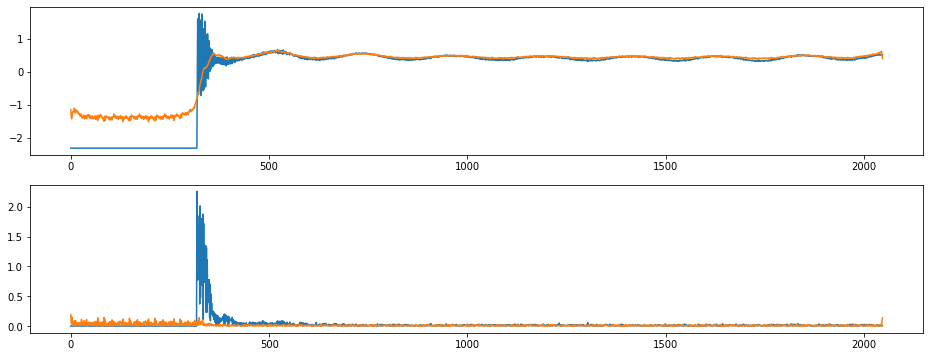

index:  331780
MAE:  0.1978164203168859
n_bunches       1358
bunch_index     1109
bunch_number     389
Name: 11512, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6239/instability_data/06239_Inst_B1H_Q7_20170924_06h23m14s.h5


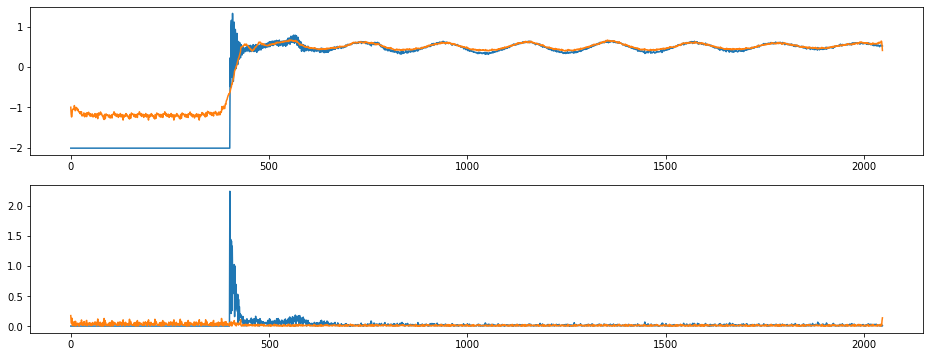

index:  129435
MAE:  0.2017520095272313
n_bunches       796
bunch_index     993
bunch_number    541
Name: 4475, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6192/instability_data/06192_Inst_B1H_Q7_20170912_17h19m38s.h5


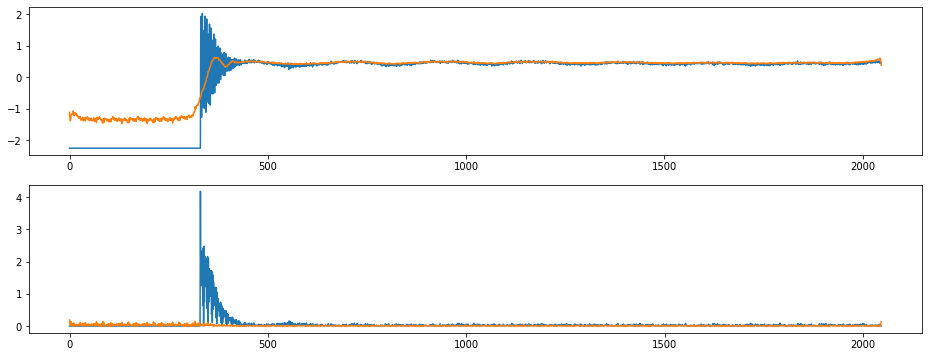

index:  294397
MAE:  0.20254952677422144
n_bunches        648
bunch_index     2922
bunch_number     544
Name: 10213, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7446/instability_data/07446_Inst_B1H_Q7_20181116_02h46m18s.h5


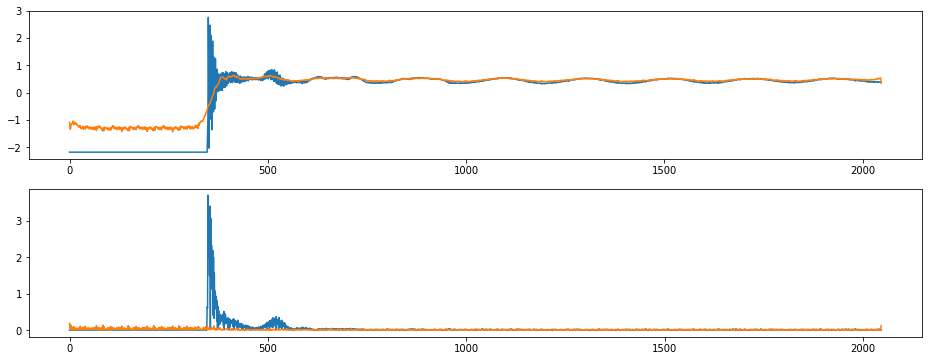

index:  386171
MAE:  0.21145894390052344
n_bunches       636
bunch_index     714
bunch_number    523
Name: 13397, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7037/instability_data/07037_Inst_B1H_Q7_20180808_02h43m34s.h5


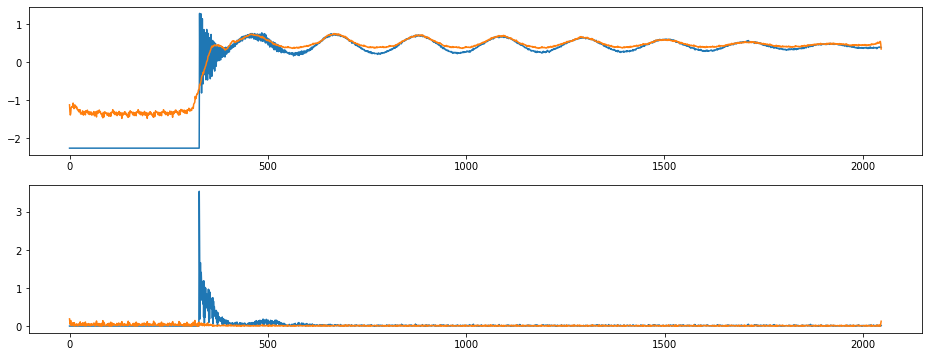

index:  152583
MAE:  0.21221618960157515
n_bunches       572
bunch_index     982
bunch_number    534
Name: 5276, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6246/instability_data/06246_Inst_B1H_Q7_20170927_04h56m36s.h5


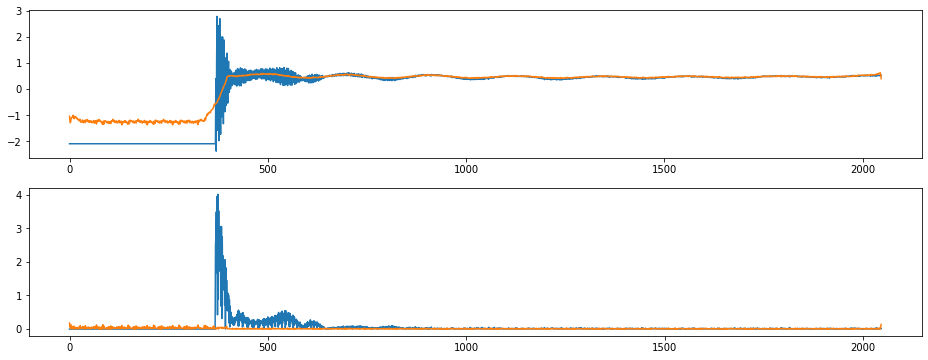

index:  358683
MAE:  0.21275221524000382
n_bunches       1358
bunch_index     3344
bunch_number    1318
Name: 12441, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6239/instability_data/06239_Inst_B1H_Q7_20170924_06h23m14s.h5


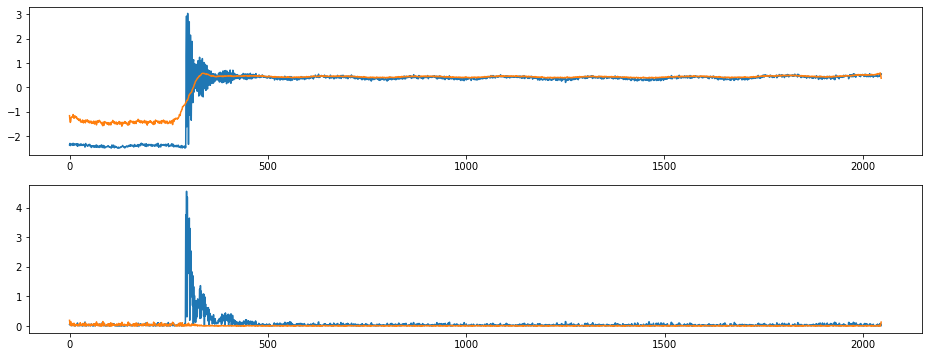

index:  24123
MAE:  0.21693911147683492
n_bunches        972
bunch_index     1164
bunch_number     611
Name: 824, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6272/instability_data/06272_Inst_B1H_Q7_20171005_01h30m07s.h5


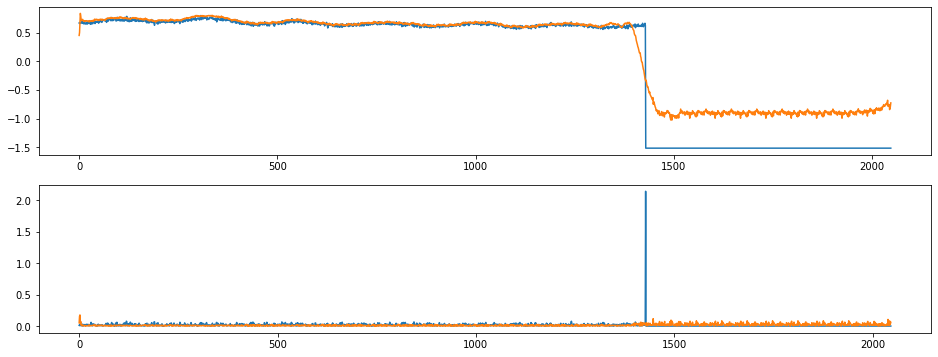

index:  266007
MAE:  0.220940656578724
n_bunches       140
bunch_index     149
bunch_number     40
Name: 9228, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6395/instability_data/06395_Inst_B1H_Q7_20171116_20h01m35s.h5


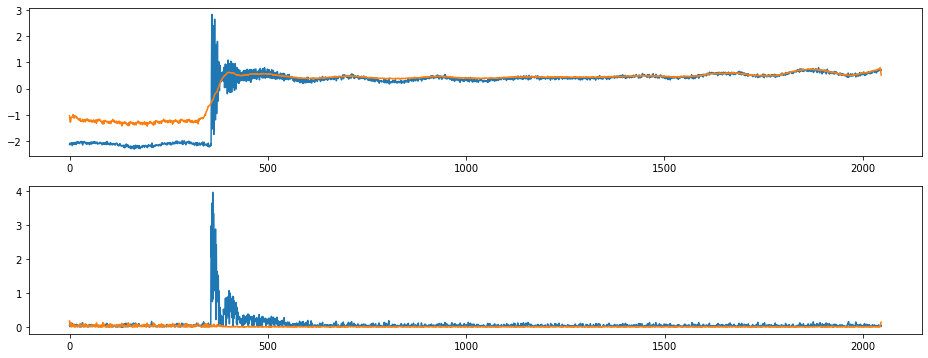

index:  140254
MAE:  0.22197766597410135
n_bunches       572
bunch_index     226
bunch_number    113
Name: 4855, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6246/instability_data/06246_Inst_B1H_Q7_20170927_04h56m36s.h5


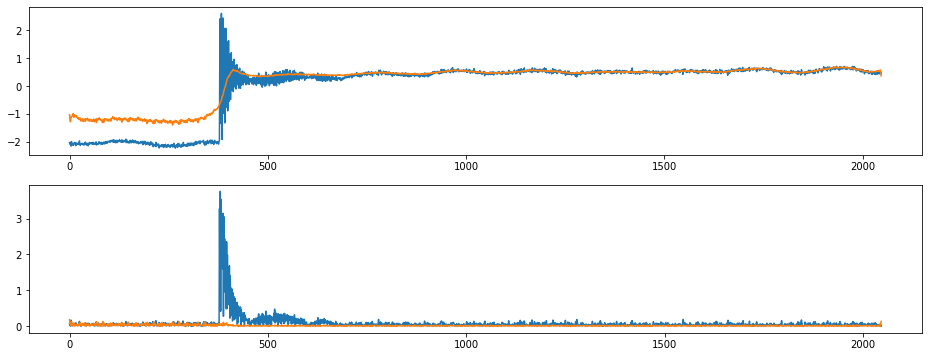

index:  19979
MAE:  0.22246234051583078
n_bunches       972
bunch_index     897
bunch_number    472
Name: 685, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6272/instability_data/06272_Inst_B1H_Q7_20171005_01h30m07s.h5


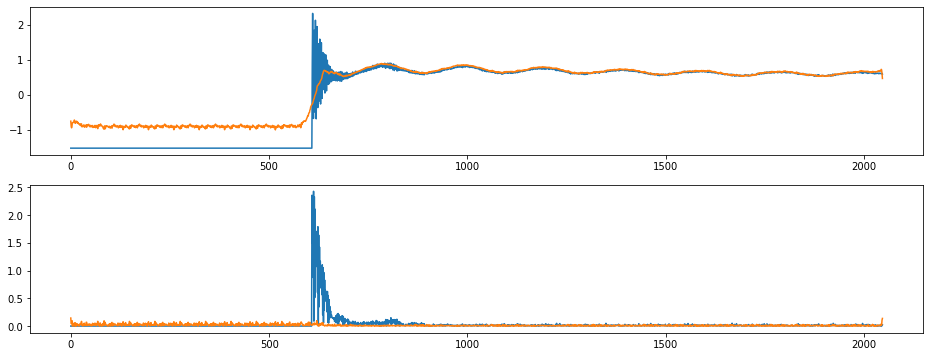

index:  332960
MAE:  0.22553386226492292
n_bunches       1358
bunch_index     1177
bunch_number     434
Name: 11557, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6239/instability_data/06239_Inst_B1H_Q7_20170924_06h23m14s.h5


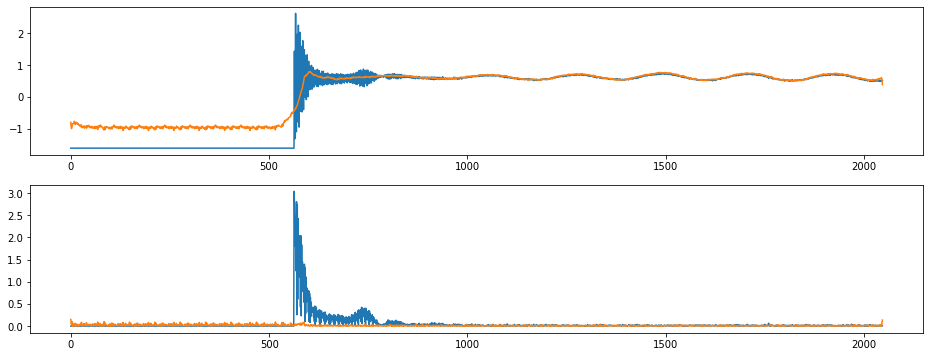

index:  141006
MAE:  0.2257064275375012
n_bunches       572
bunch_index     265
bunch_number    137
Name: 4879, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6246/instability_data/06246_Inst_B1H_Q7_20170927_04h56m36s.h5


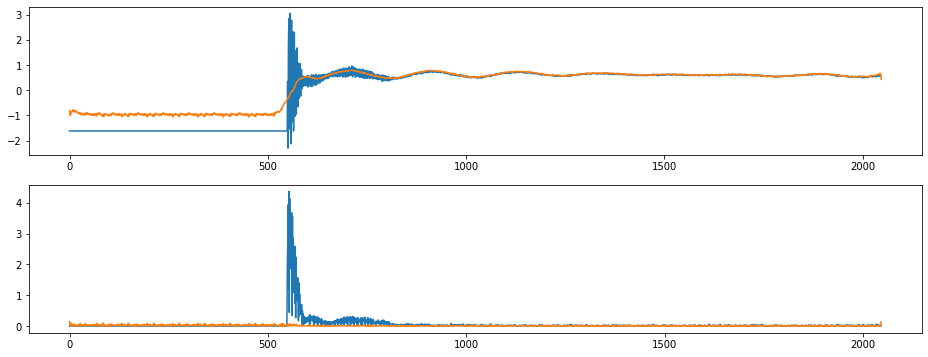

index:  83953
MAE:  0.2261877073760843
n_bunches        456
bunch_index     1219
bunch_number     284
Name: 2898, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7378/instability_data/07378_Inst_B1H_Q7_20181028_22h46m14s.h5


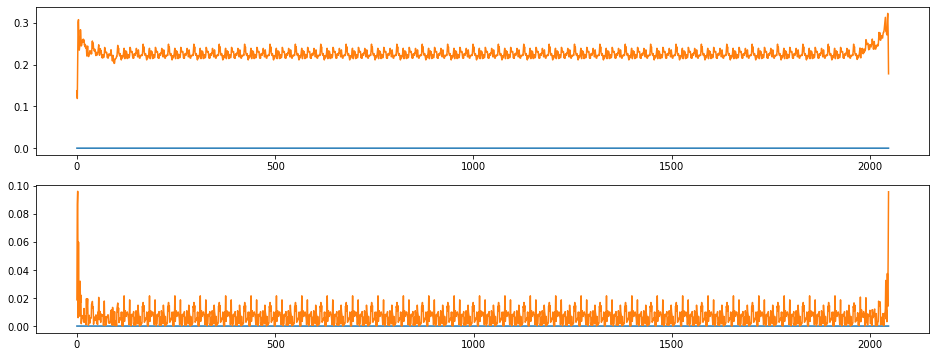

index:  85343
MAE:  0.2261877073760843
n_bunches        456
bunch_index     1297
bunch_number     331
Name: 2945, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7378/instability_data/07378_Inst_B1H_Q7_20181028_22h46m14s.h5


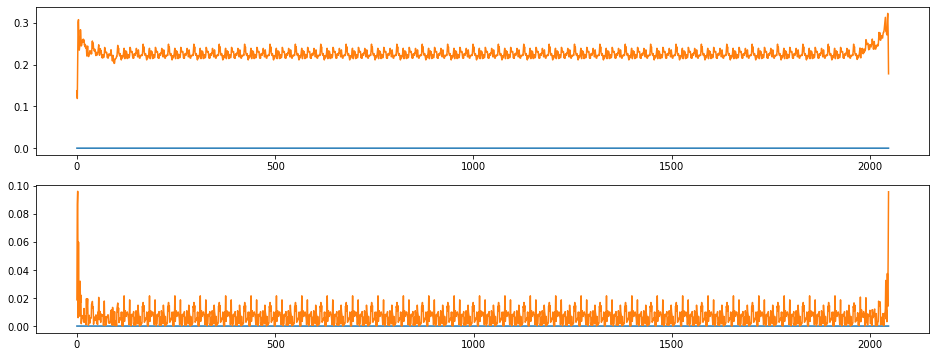

index:  48900
MAE:  0.2261877073760843
n_bunches        733
bunch_index     2357
bunch_number     501
Name: 1686, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


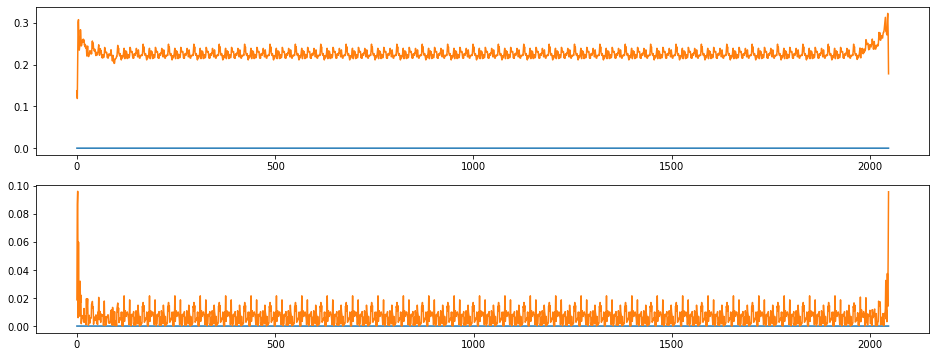

index:  87906
MAE:  0.2261877073760843
n_bunches        456
bunch_index     1402
bunch_number     422
Name: 3036, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7378/instability_data/07378_Inst_B1H_Q7_20181028_22h46m14s.h5


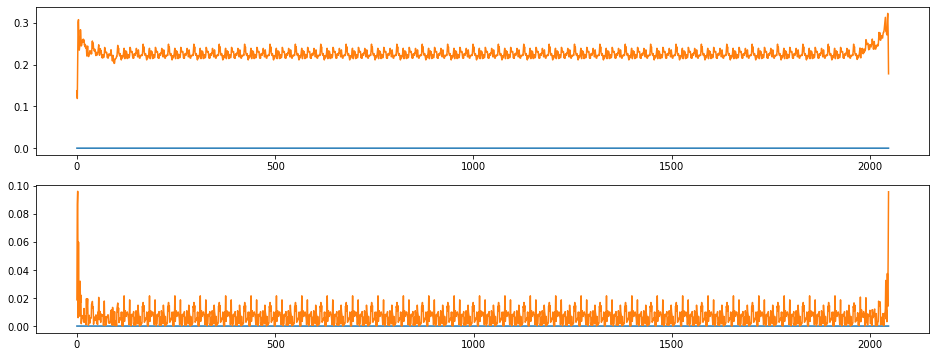

index:  360804
MAE:  0.2261877073760843
n_bunches       376
bunch_index     121
bunch_number     22
Name: 12520, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7468/instability_data/07468_Inst_B1H_Q7_20181123_19h34m32s.h5


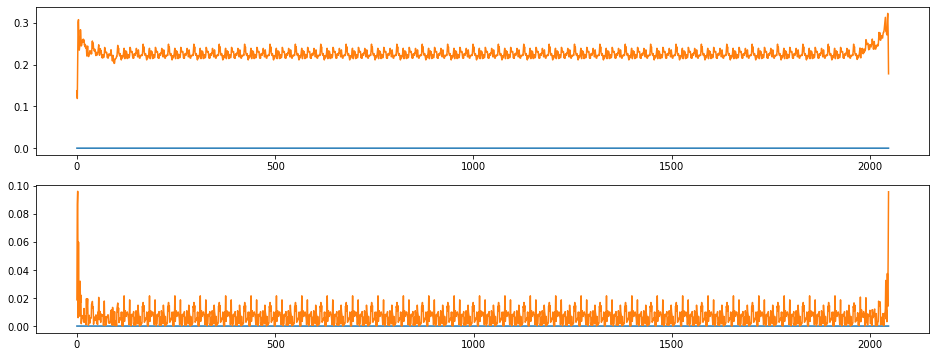

index:  393227
MAE:  0.2261877073760843
n_bunches       396
bunch_index     221
bunch_number    134
Name: 13644, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7122/instability_data/07122_Inst_B1H_Q7_20180903_07h29m11s.h5


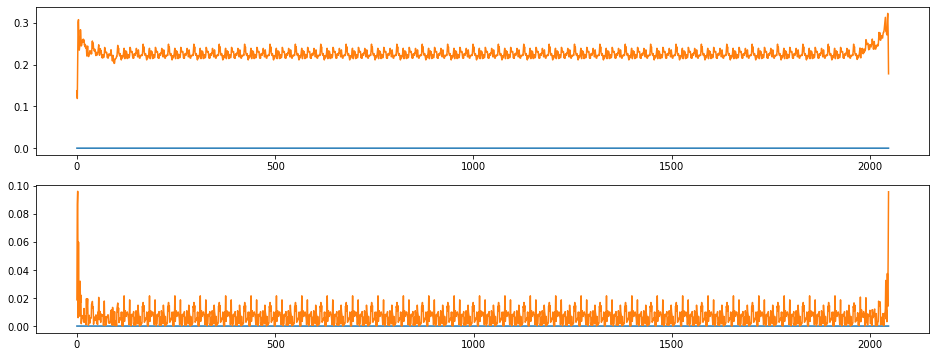

index:  13304
MAE:  0.2261877073760843
n_bunches       972
bunch_index     481
bunch_number    246
Name: 459, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6272/instability_data/06272_Inst_B1H_Q7_20171005_01h30m07s.h5


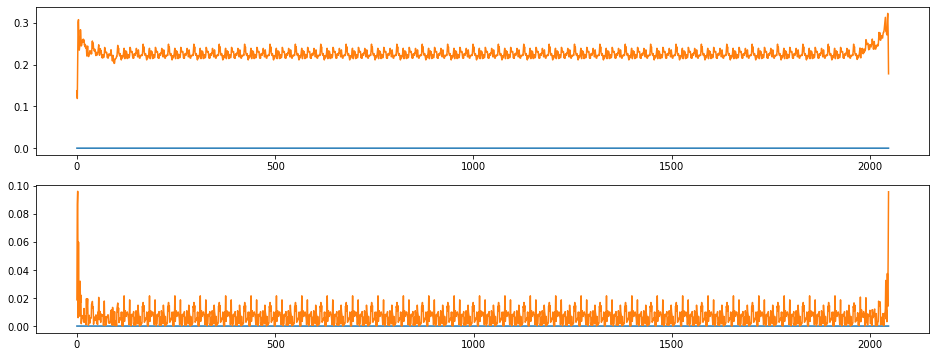

index:  190879
MAE:  0.2261877073760843
n_bunches       1227
bunch_index     1637
bunch_number     608
Name: 6606, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_11h45m14s.h5


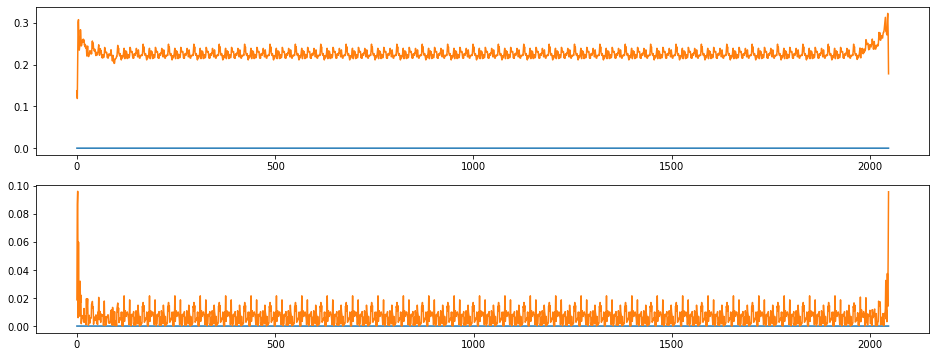

index:  224290
MAE:  0.2261877073760843
n_bunches        987
bunch_index     1991
bunch_number     533
Name: 7761, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6706/instability_data/06706_Inst_B1H_Q7_20180520_12h23m14s.h5


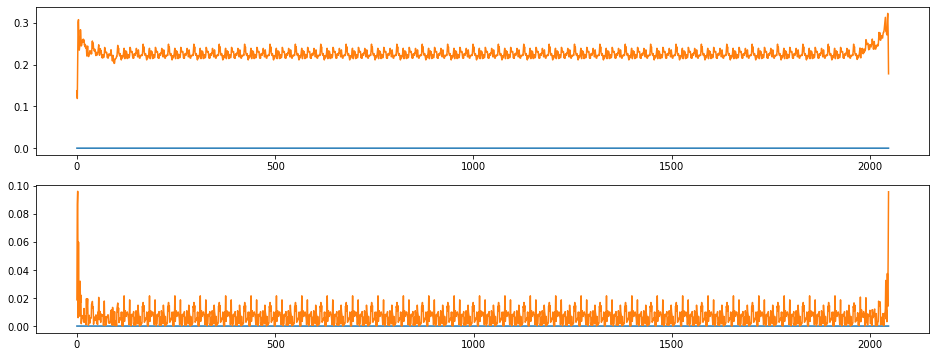

index:  43143
MAE:  0.2261877073760843
n_bunches        733
bunch_index     1400
bunch_number     295
Name: 1480, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


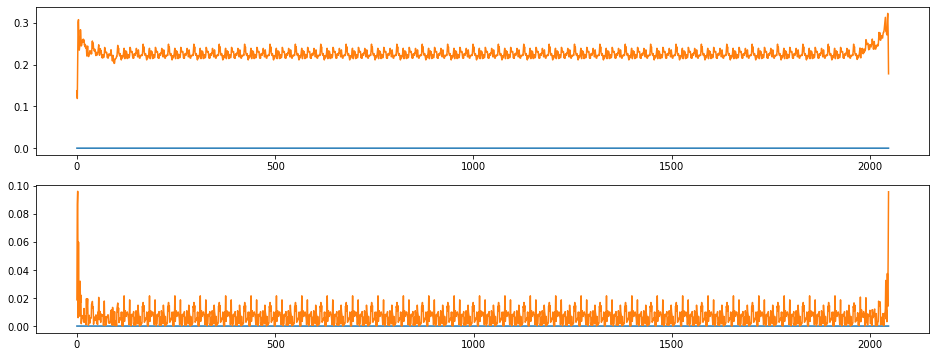

index:  318876
MAE:  0.2261877073760843
n_bunches        648
bunch_index     3150
bunch_number     589
Name: 11064, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7444/instability_data/07444_Inst_B1H_Q7_20181115_07h56m14s.h5


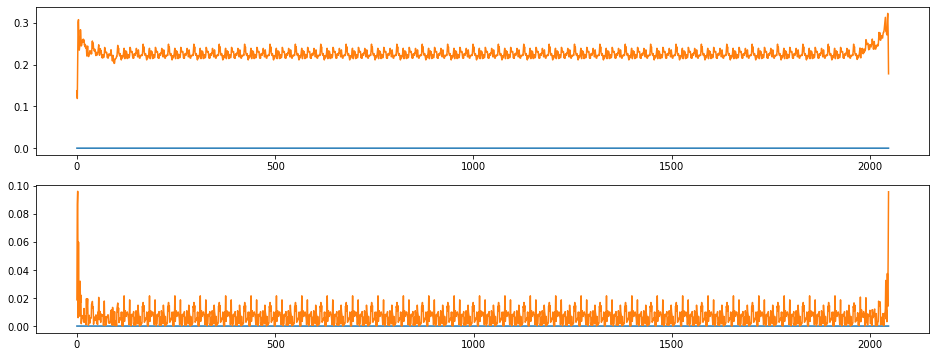

index:  221424
MAE:  0.2261877073760843
n_bunches        987
bunch_index     1409
bunch_number     427
Name: 7655, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6706/instability_data/06706_Inst_B1H_Q7_20180520_12h23m14s.h5


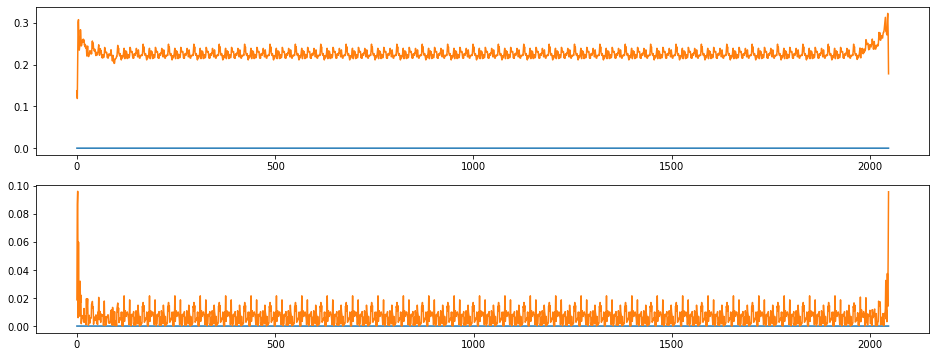

index:  314262
MAE:  0.2261877073760843
n_bunches        648
bunch_index     2291
bunch_number     428
Name: 10903, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7444/instability_data/07444_Inst_B1H_Q7_20181115_07h56m14s.h5


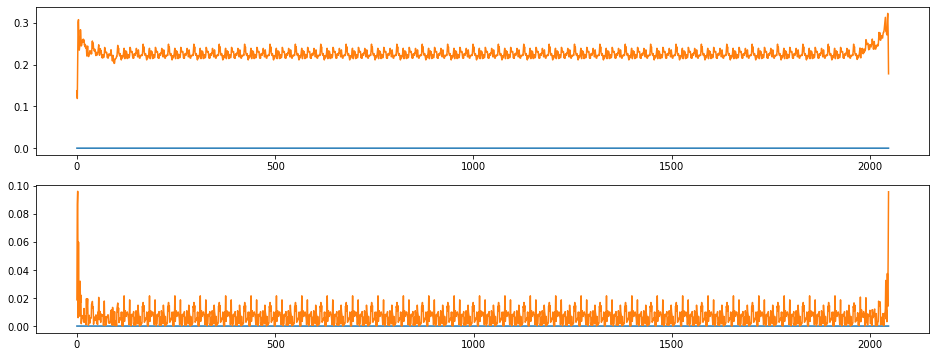

index:  162883
MAE:  0.2261877073760843
n_bunches       684
bunch_index     595
bunch_number    318
Name: 5632, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6247/instability_data/06247_Inst_B1H_Q7_20170927_07h40m43s.h5


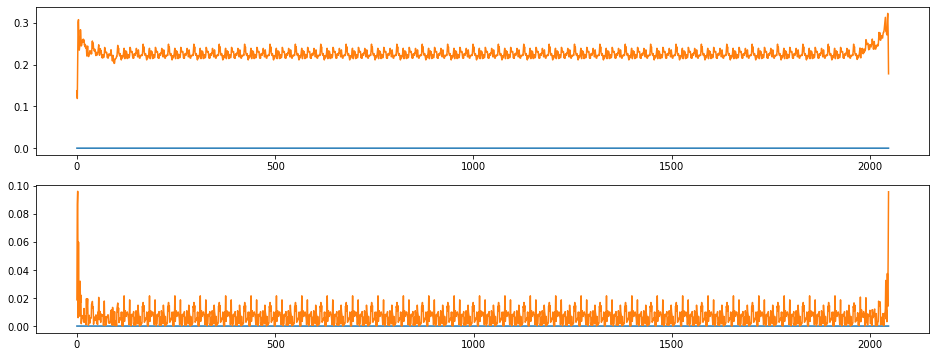

index:  48860
MAE:  0.2261877073760843
n_bunches        733
bunch_index     2351
bunch_number     499
Name: 1684, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


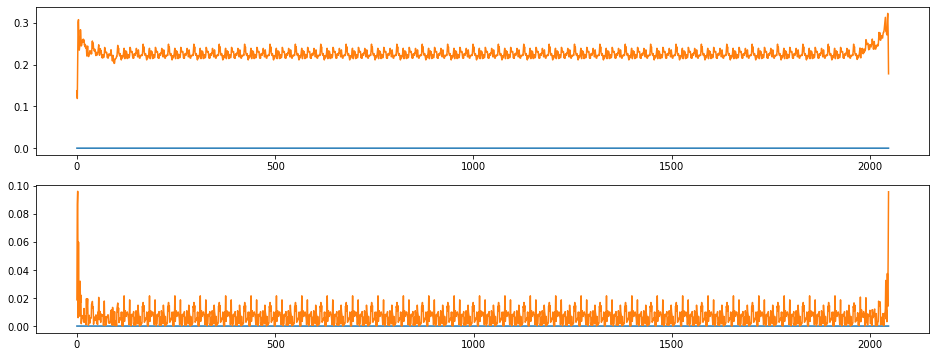

index:  235524
MAE:  0.2261877073760843
n_bunches        987
bunch_index     3235
bunch_number     940
Name: 8168, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6706/instability_data/06706_Inst_B1H_Q7_20180520_12h23m14s.h5


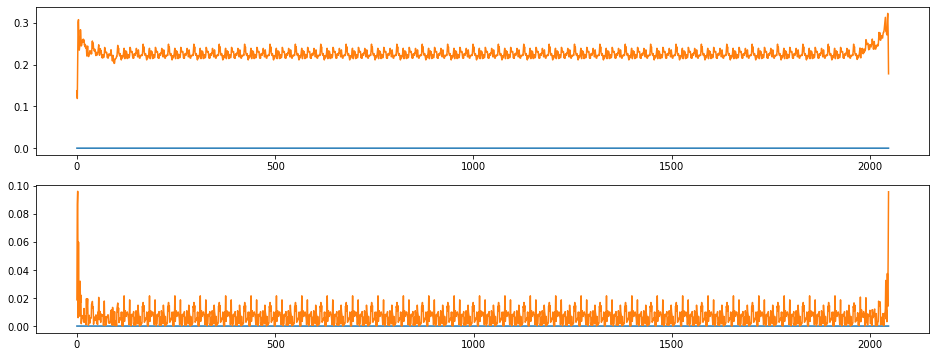

index:  400741
MAE:  0.2261877073760843
n_bunches       396
bunch_index     534
bunch_number    388
Name: 13898, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7122/instability_data/07122_Inst_B1H_Q7_20180903_07h29m11s.h5


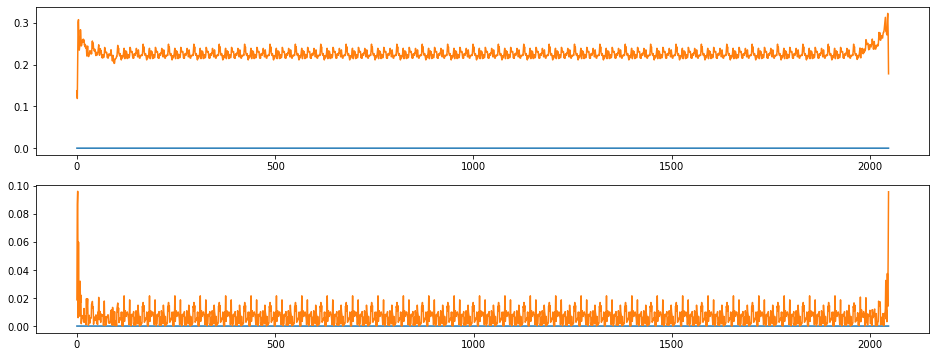

index:  402882
MAE:  0.2261877073760843
n_bunches       502
bunch_index     291
bunch_number     58
Name: 13972, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_08h31m15s.h5


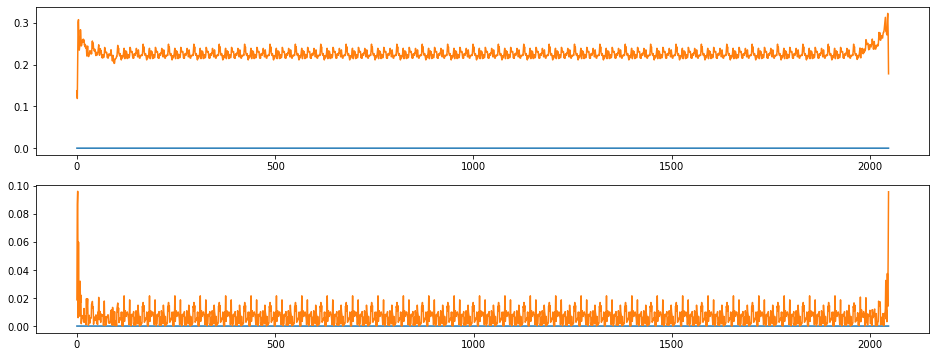

index:  131725
MAE:  0.2261877073760843
n_bunches        796
bunch_index     1132
bunch_number     617
Name: 4551, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6192/instability_data/06192_Inst_B1H_Q7_20170912_17h19m38s.h5


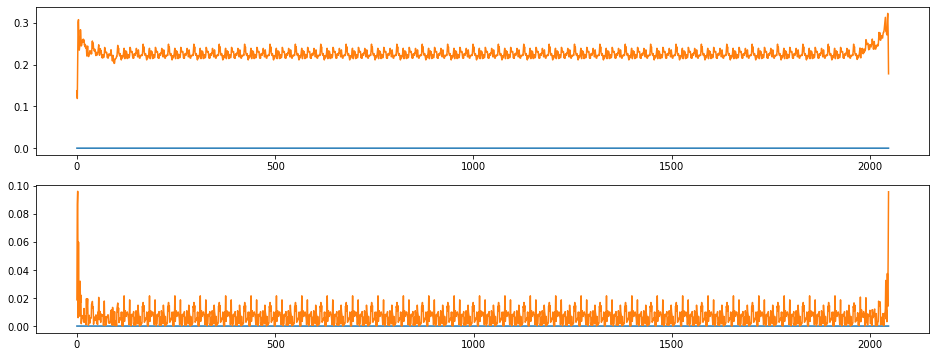

index:  46751
MAE:  0.2261877073760843
n_bunches        733
bunch_index     2016
bunch_number     422
Name: 1607, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


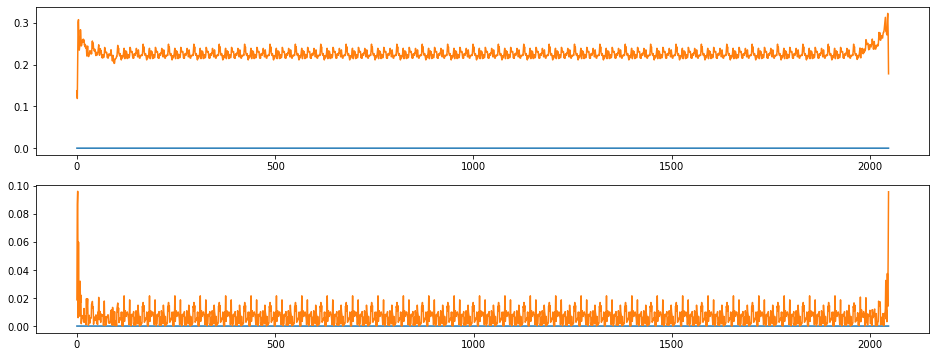

index:  278739
MAE:  0.2261877073760843
n_bunches       648
bunch_index      61
bunch_number      4
Name: 9673, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7446/instability_data/07446_Inst_B1H_Q7_20181116_02h46m18s.h5


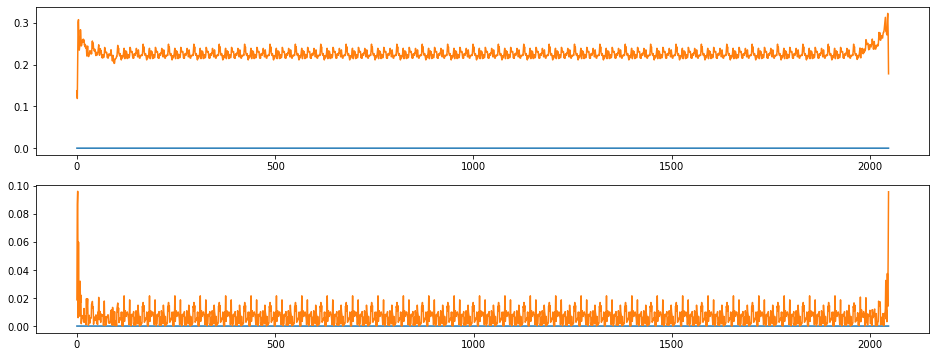

index:  299268
MAE:  0.2261877073760843
n_bunches        158
bunch_index     1820
bunch_number      66
Name: 10383, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7343/instability_data/07343_Inst_B1H_Q7_20181025_05h31m18s.h5


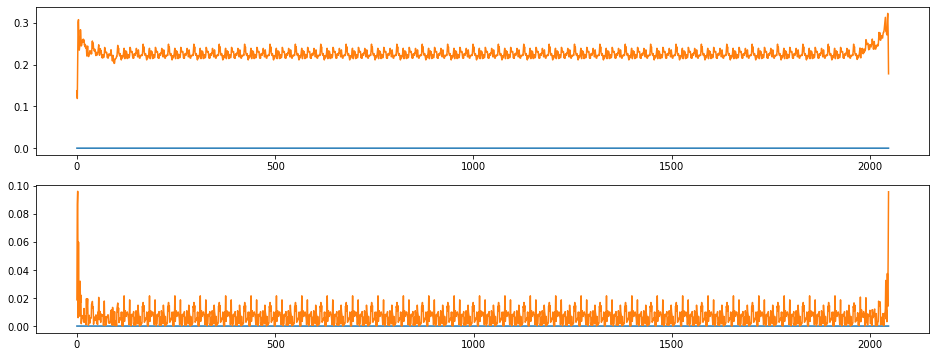

index:  131552
MAE:  0.2261877073760843
n_bunches        796
bunch_index     1122
bunch_number     611
Name: 4545, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6192/instability_data/06192_Inst_B1H_Q7_20170912_17h19m38s.h5


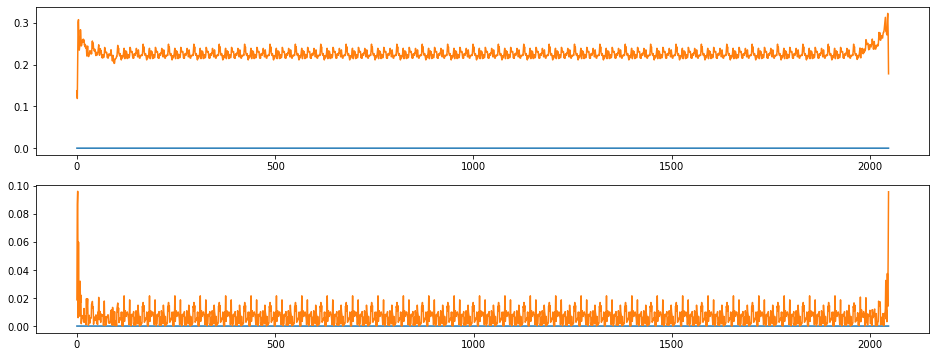

index:  273975
MAE:  0.2261877073760843
n_bunches       252
bunch_index     270
bunch_number    176
Name: 9505, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7123/instability_data/07123_Inst_B1H_Q7_20180903_17h34m19s.h5


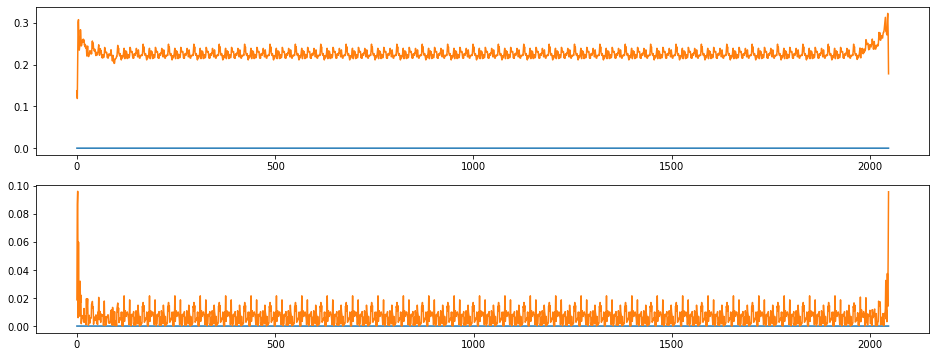

index:  369447
MAE:  0.2261877073760843
n_bunches        376
bunch_index     1522
bunch_number     319
Name: 12817, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7468/instability_data/07468_Inst_B1H_Q7_20181123_19h34m32s.h5


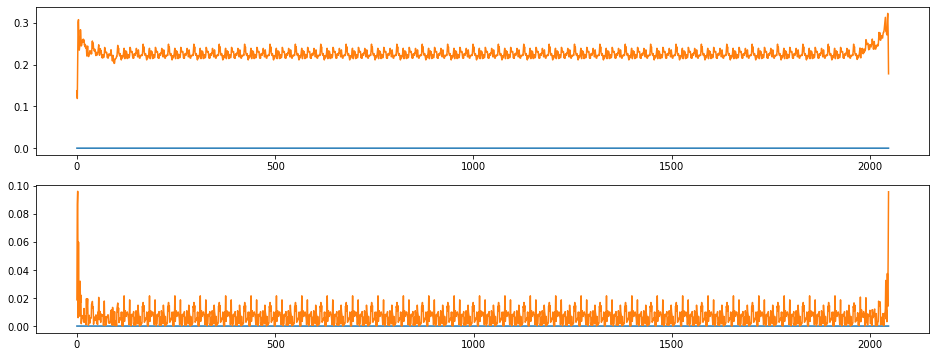

index:  53606
MAE:  0.2261877073760843
n_bunches        733
bunch_index     3170
bunch_number     670
Name: 1855, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


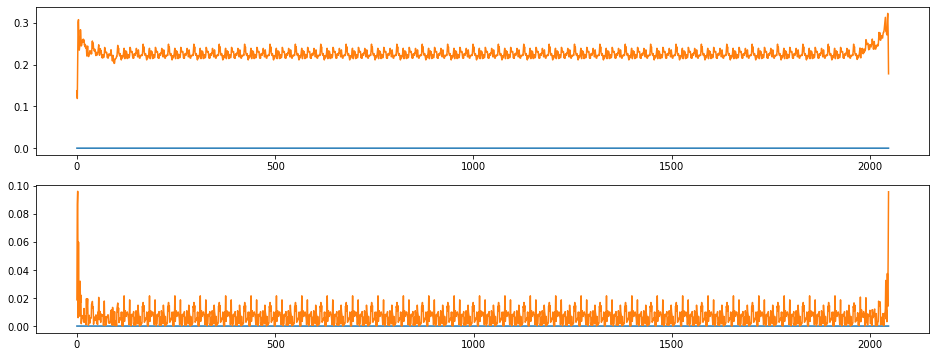

index:  297946
MAE:  0.2261877073760843
n_bunches       158
bunch_index     631
bunch_number     17
Name: 10334, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7343/instability_data/07343_Inst_B1H_Q7_20181025_05h31m18s.h5


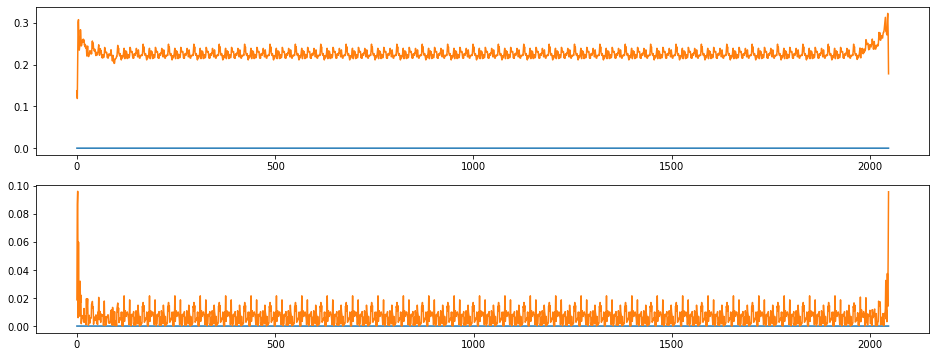

index:  43223
MAE:  0.2261877073760843
n_bunches        733
bunch_index     1406
bunch_number     297
Name: 1482, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


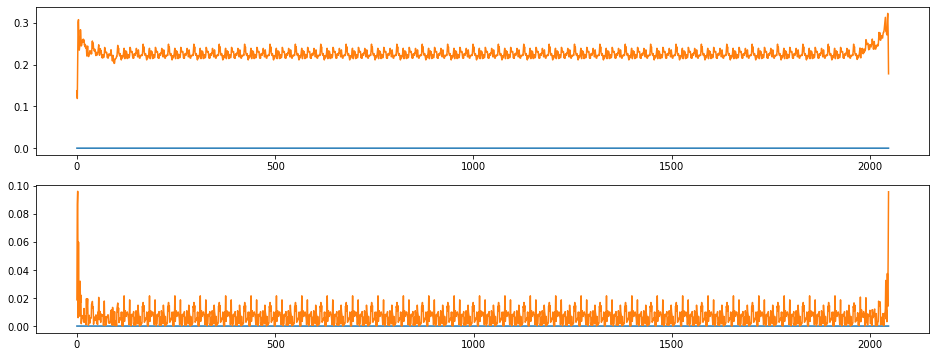

index:  361792
MAE:  0.2261877073760843
n_bunches       376
bunch_index     282
bunch_number     56
Name: 12554, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7468/instability_data/07468_Inst_B1H_Q7_20181123_19h34m32s.h5


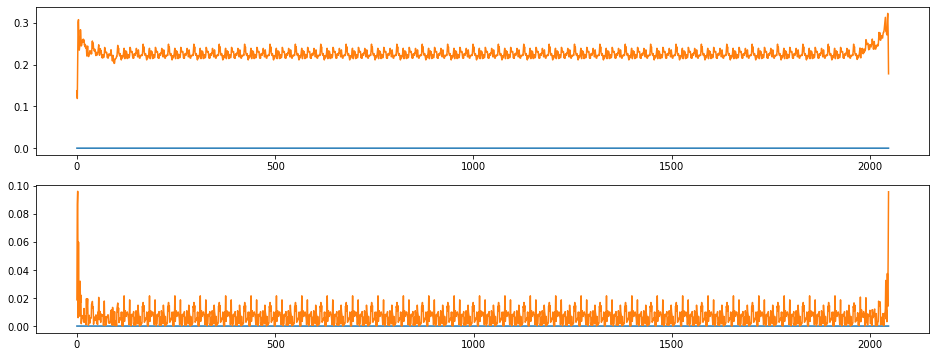

index:  200832
MAE:  0.2261877073760843
n_bunches       1227
bunch_index     2842
bunch_number     951
Name: 6949, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_11h45m14s.h5


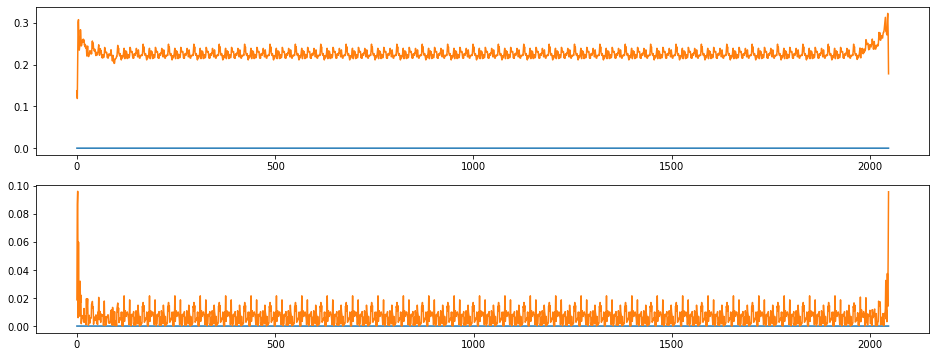

index:  260992
MAE:  0.2261877073760843
n_bunches        372
bunch_index     1274
bunch_number     238
Name: 9044, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7448/instability_data/07448_Inst_B1H_Q7_20181116_07h25m20s.h5


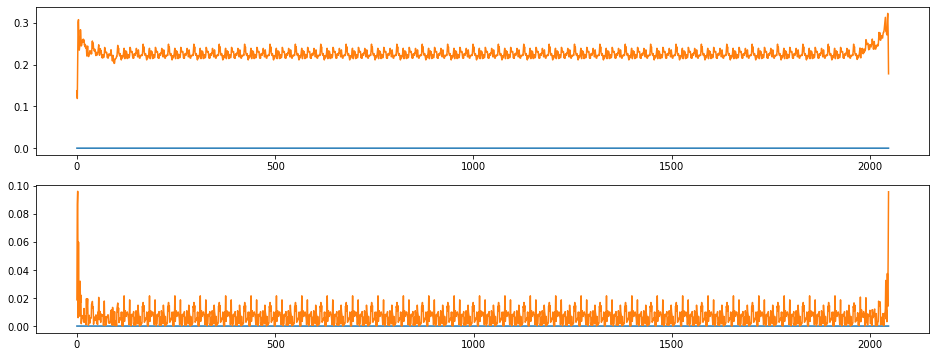

index:  315583
MAE:  0.2261877073760843
n_bunches        648
bunch_index     2537
bunch_number     477
Name: 10952, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7444/instability_data/07444_Inst_B1H_Q7_20181115_07h56m14s.h5


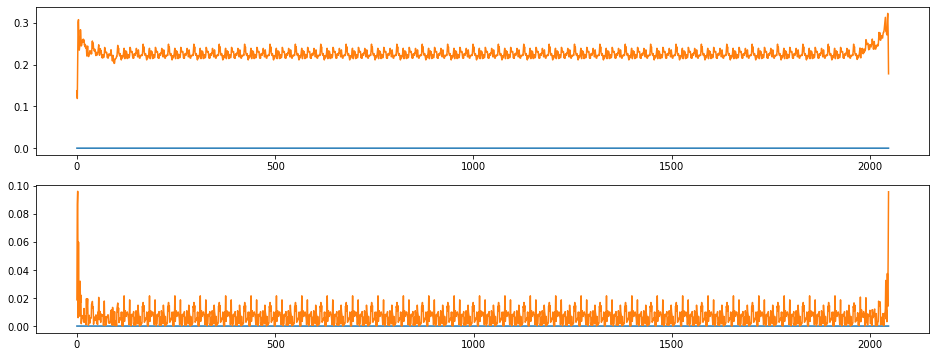

index:  396332
MAE:  0.2261877073760843
n_bunches       396
bunch_index     338
bunch_number    237
Name: 13747, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7122/instability_data/07122_Inst_B1H_Q7_20180903_07h29m11s.h5


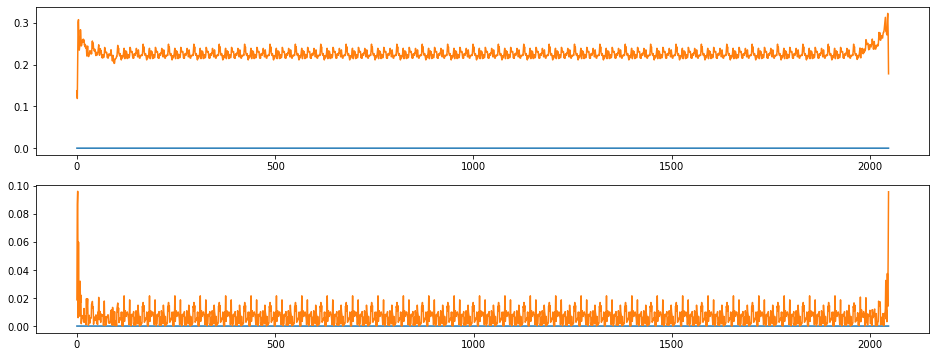

index:  403137
MAE:  0.2261877073760843
n_bunches       502
bunch_index     327
bunch_number     67
Name: 13981, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_08h31m15s.h5


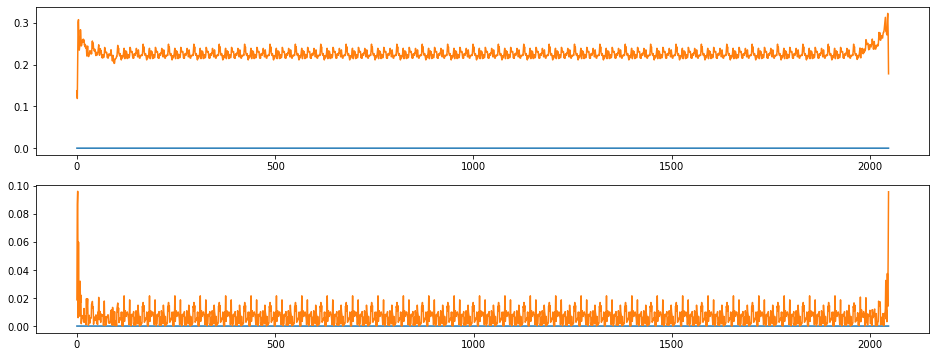

index:  12914
MAE:  0.2261877073760843
n_bunches       972
bunch_index     457
bunch_number    233
Name: 446, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6272/instability_data/06272_Inst_B1H_Q7_20171005_01h30m07s.h5


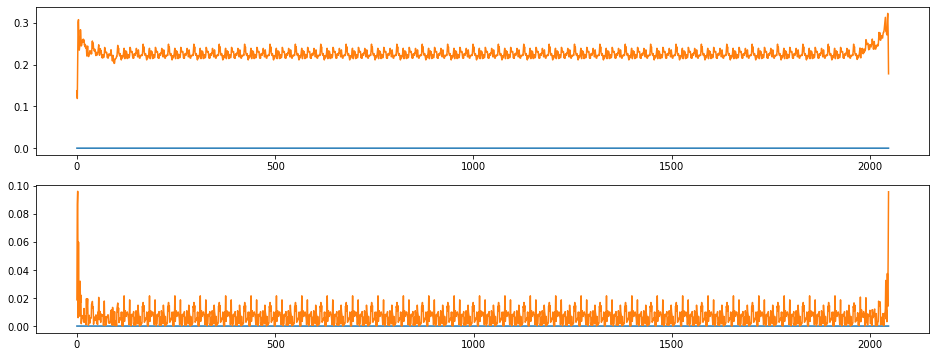

index:  87776
MAE:  0.2261877073760843
n_bunches        456
bunch_index     1398
bunch_number     418
Name: 3032, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7378/instability_data/07378_Inst_B1H_Q7_20181028_22h46m14s.h5


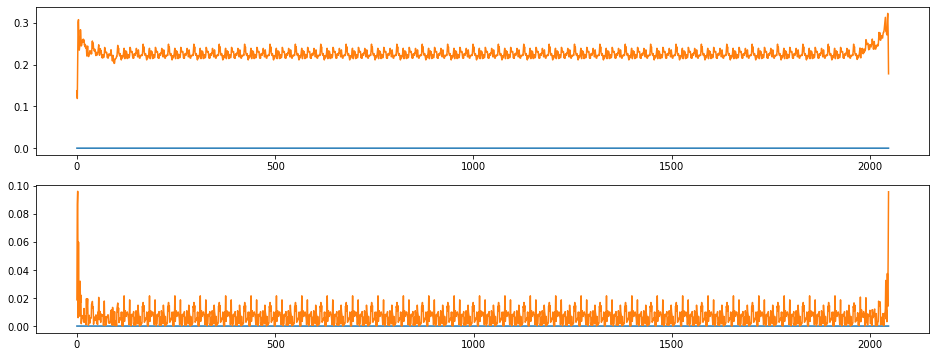

index:  334820
MAE:  0.2261877073760843
n_bunches       1358
bunch_index     1300
bunch_number     498
Name: 11621, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6239/instability_data/06239_Inst_B1H_Q7_20170924_06h23m14s.h5


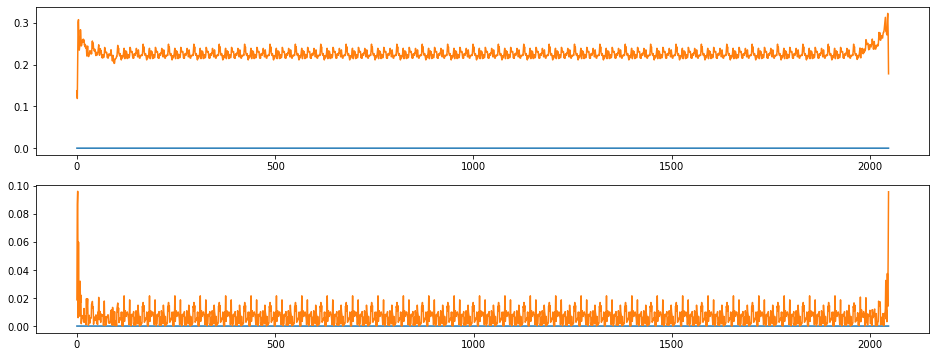

index:  354199
MAE:  0.2261877073760843
n_bunches       1358
bunch_index     3072
bunch_number    1159
Name: 12282, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6239/instability_data/06239_Inst_B1H_Q7_20170924_06h23m14s.h5


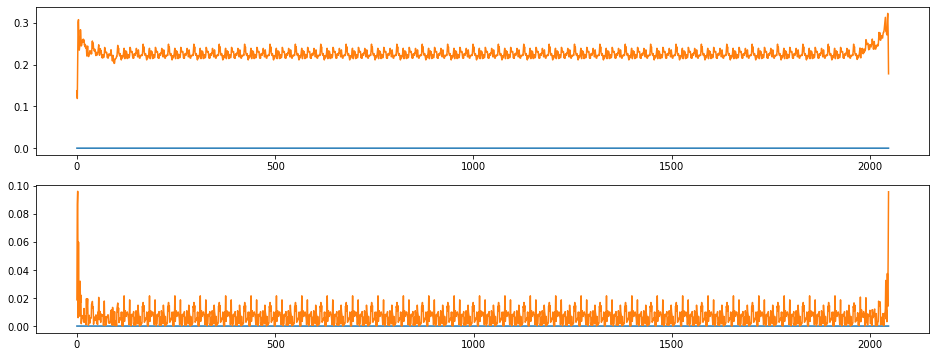

index:  245080
MAE:  0.2261877073760843
n_bunches       300
bunch_index     494
bunch_number    252
Name: 8493, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6989/instability_data/06989_Inst_B1H_Q7_20180727_06h58m14s.h5


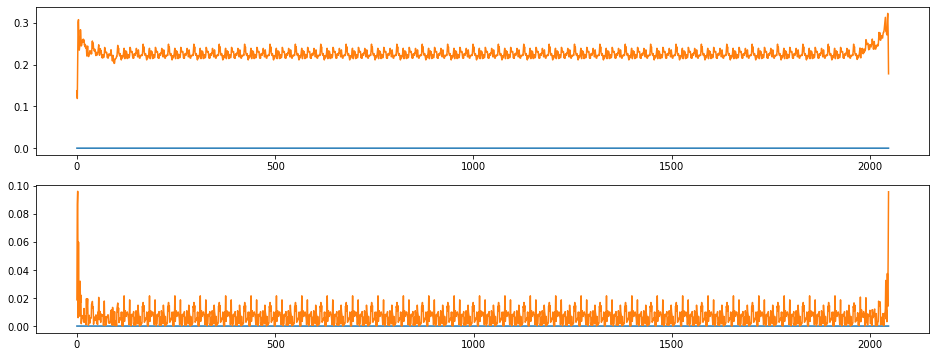

index:  177168
MAE:  0.2261877073760843
n_bunches       1227
bunch_index      263
bunch_number     125
Name: 6123, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_11h45m14s.h5


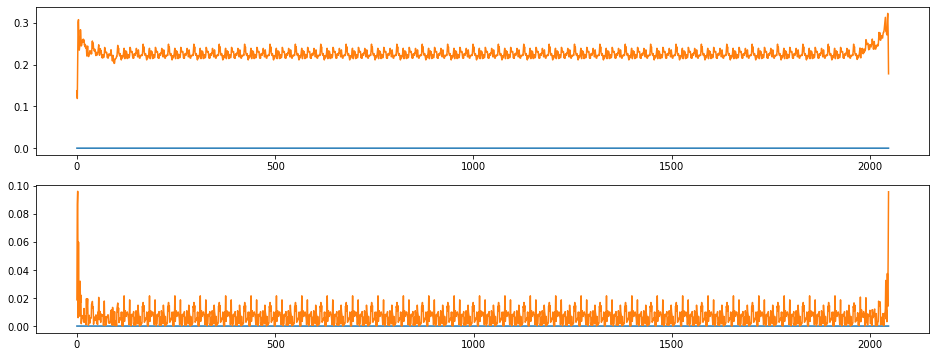

index:  302496
MAE:  0.2261877073760843
n_bunches       648
bunch_index     133
bunch_number     20
Name: 10495, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7444/instability_data/07444_Inst_B1H_Q7_20181115_07h56m14s.h5


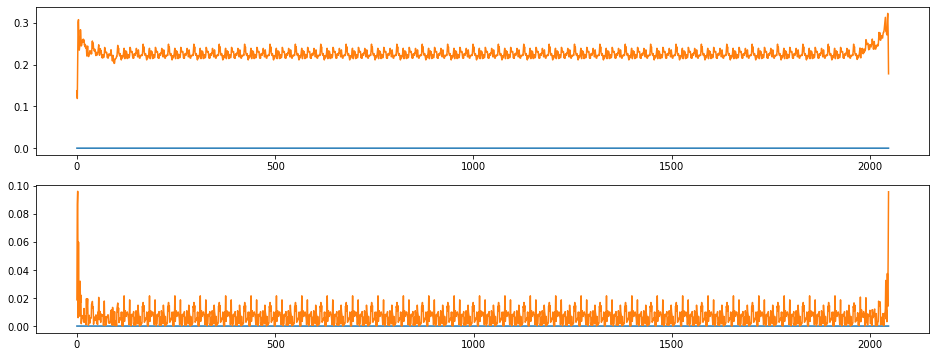

index:  201033
MAE:  0.2261877073760843
n_bunches       1227
bunch_index     2850
bunch_number     959
Name: 6957, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_11h45m14s.h5


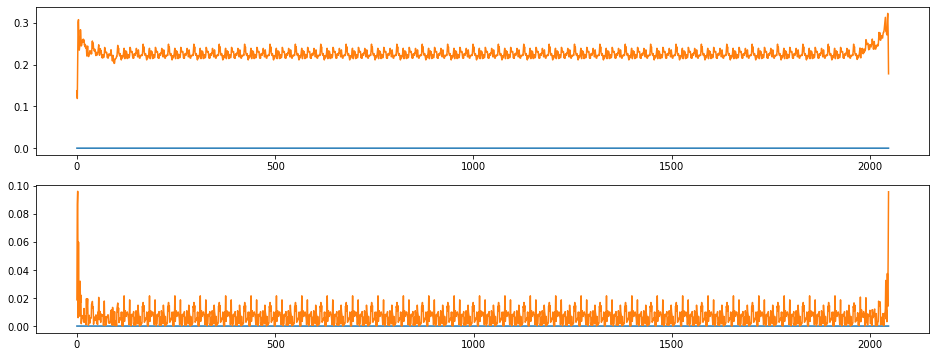

index:  244930
MAE:  0.2261877073760843
n_bunches       300
bunch_index     483
bunch_number    248
Name: 8489, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6989/instability_data/06989_Inst_B1H_Q7_20180727_06h58m14s.h5


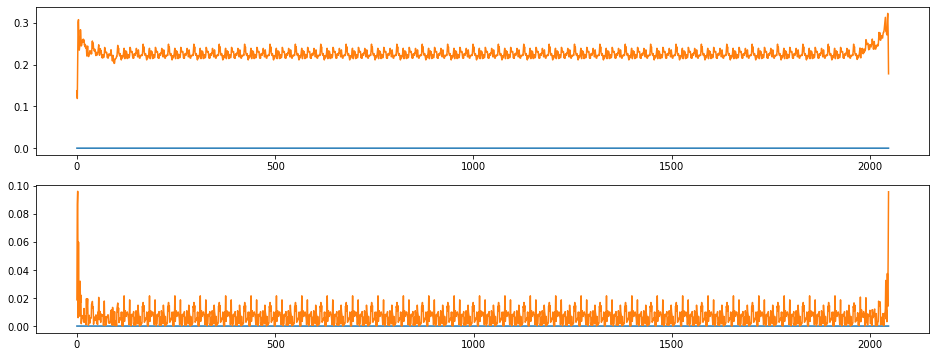

index:  292742
MAE:  0.2261877073760843
n_bunches        648
bunch_index     2616
bunch_number     488
Name: 10157, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7446/instability_data/07446_Inst_B1H_Q7_20181116_02h46m18s.h5


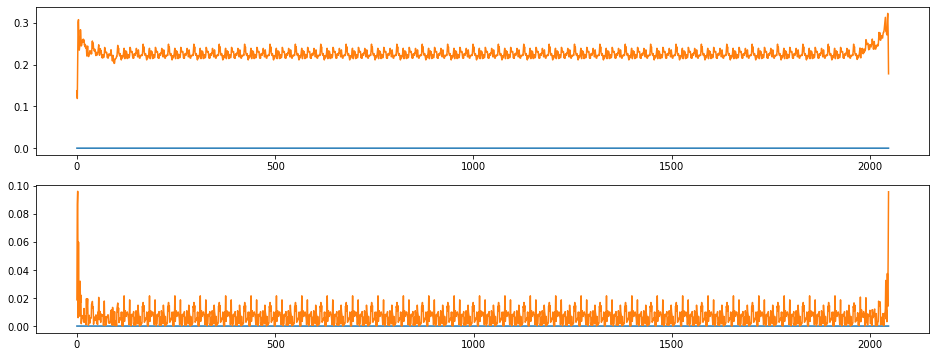

index:  87799
MAE:  0.2261877073760843
n_bunches        456
bunch_index     1398
bunch_number     418
Name: 3032, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7378/instability_data/07378_Inst_B1H_Q7_20181028_22h46m14s.h5


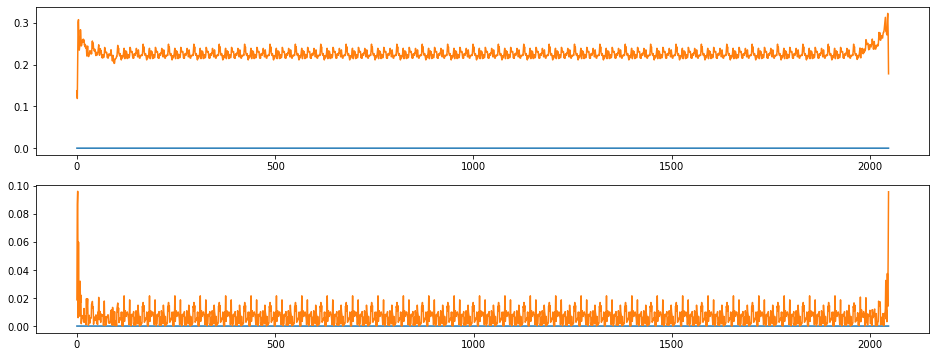

index:  366166
MAE:  0.2261877073760843
n_bunches       376
bunch_index     991
bunch_number    206
Name: 12704, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7468/instability_data/07468_Inst_B1H_Q7_20181123_19h34m32s.h5


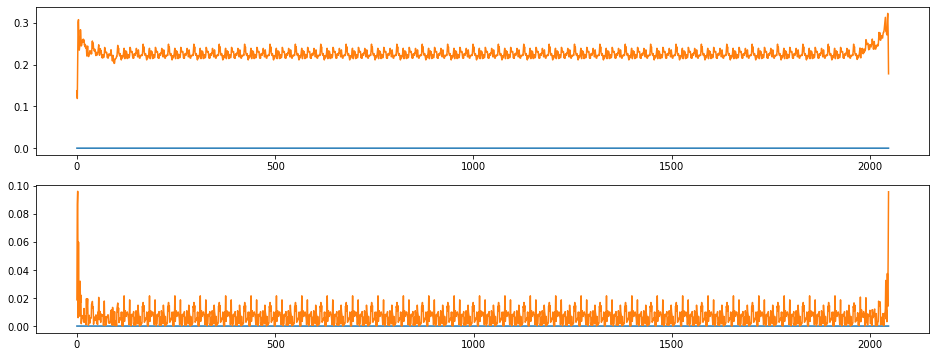

index:  87821
MAE:  0.2261877073760843
n_bunches        456
bunch_index     1399
bunch_number     419
Name: 3033, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7378/instability_data/07378_Inst_B1H_Q7_20181028_22h46m14s.h5


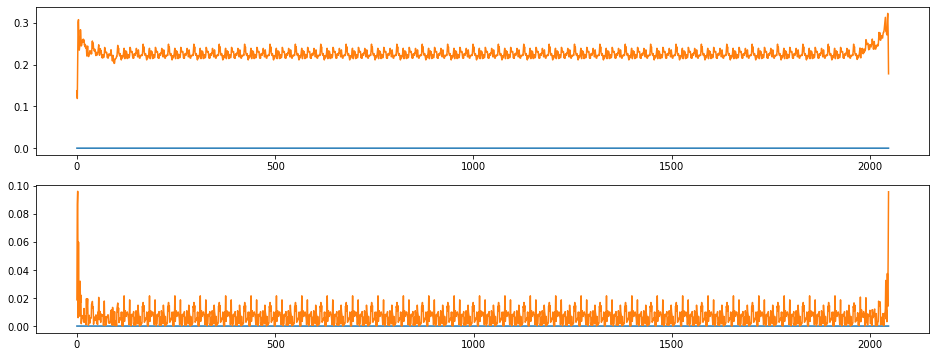

index:  362555
MAE:  0.2261877073760843
n_bunches       376
bunch_index     413
bunch_number     82
Name: 12580, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7468/instability_data/07468_Inst_B1H_Q7_20181123_19h34m32s.h5


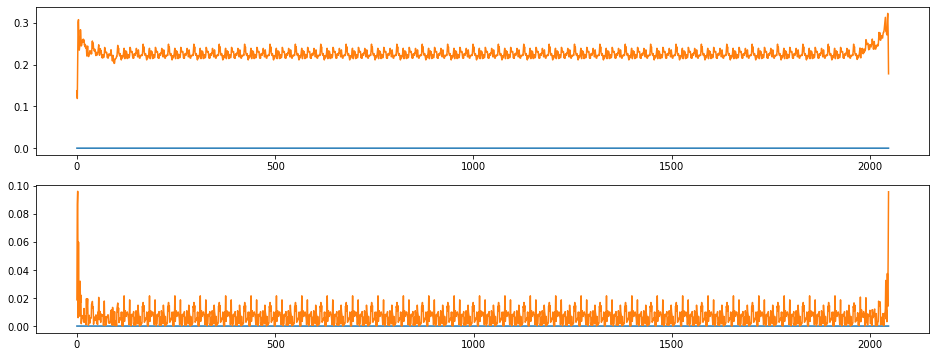

index:  94591
MAE:  0.2261877073760843
n_bunches       418
bunch_index     946
bunch_number    195
Name: 3265, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7481/instability_data/07481_Inst_B1H_Q7_20181128_09h48m56s.h5


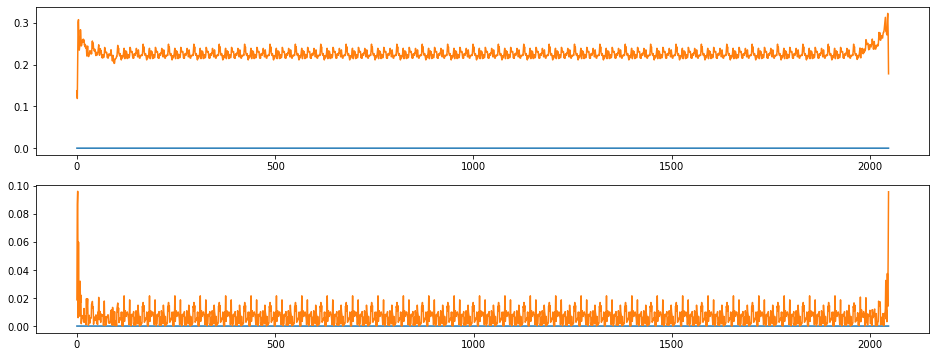

index:  244770
MAE:  0.2261877073760843
n_bunches       300
bunch_index     478
bunch_number    243
Name: 8484, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6989/instability_data/06989_Inst_B1H_Q7_20180727_06h58m14s.h5


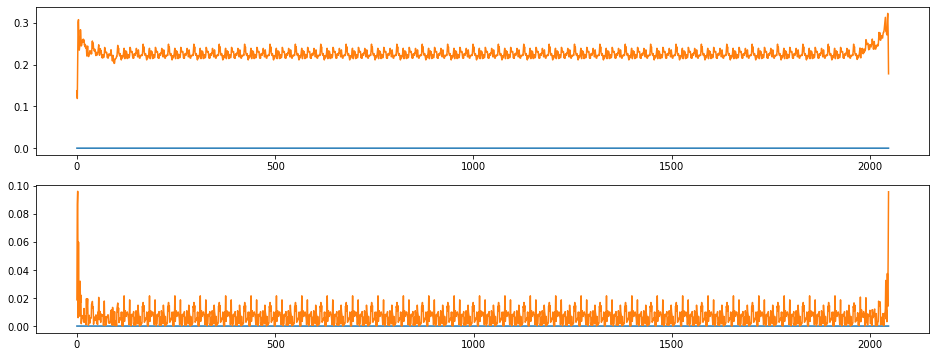

index:  244717
MAE:  0.2261877073760843
n_bunches       300
bunch_index     476
bunch_number    241
Name: 8482, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6989/instability_data/06989_Inst_B1H_Q7_20180727_06h58m14s.h5


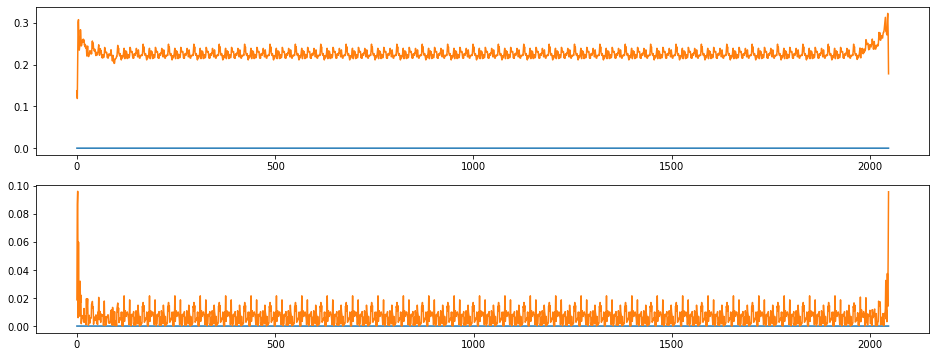

index:  287620
MAE:  0.2261877073760843
n_bunches        648
bunch_index     1650
bunch_number     310
Name: 9979, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7446/instability_data/07446_Inst_B1H_Q7_20181116_02h46m18s.h5


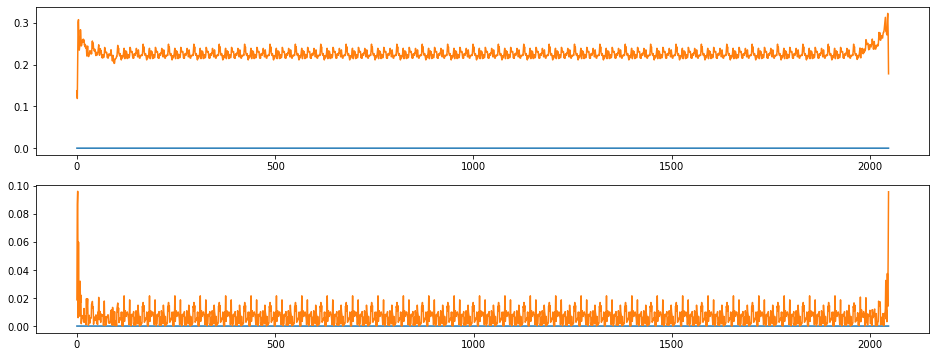

index:  162778
MAE:  0.2261877073760843
n_bunches       684
bunch_index     586
bunch_number    313
Name: 5627, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6247/instability_data/06247_Inst_B1H_Q7_20170927_07h40m43s.h5


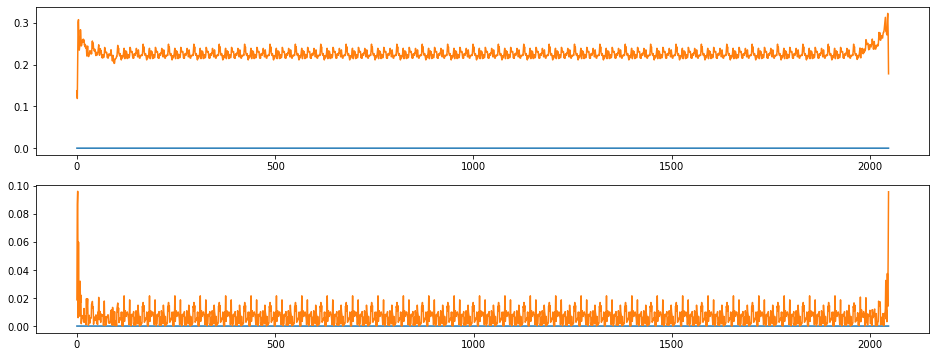

index:  343749
MAE:  0.2261877073760843
n_bunches       1358
bunch_index     2108
bunch_number     796
Name: 11919, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6239/instability_data/06239_Inst_B1H_Q7_20170924_06h23m14s.h5


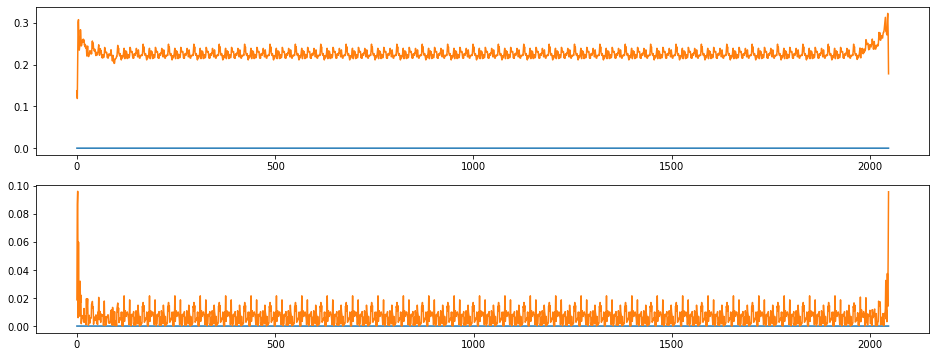

index:  12976
MAE:  0.2261877073760843
n_bunches       972
bunch_index     467
bunch_number    236
Name: 449, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6272/instability_data/06272_Inst_B1H_Q7_20171005_01h30m07s.h5


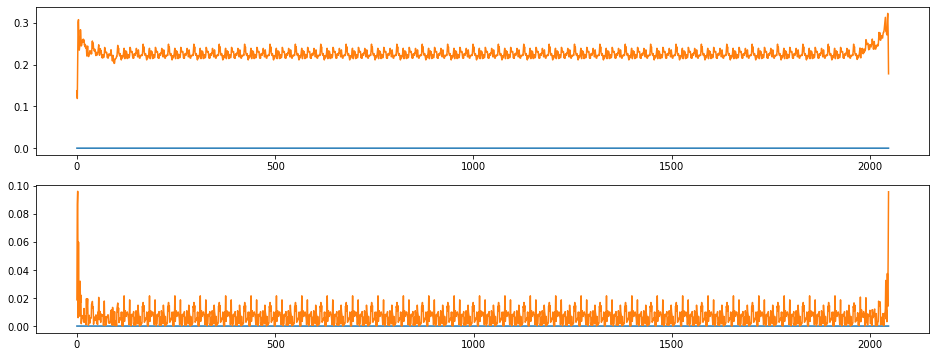

index:  325295
MAE:  0.2261877073760843
n_bunches       1358
bunch_index      403
bunch_number     159
Name: 11282, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6239/instability_data/06239_Inst_B1H_Q7_20170924_06h23m14s.h5


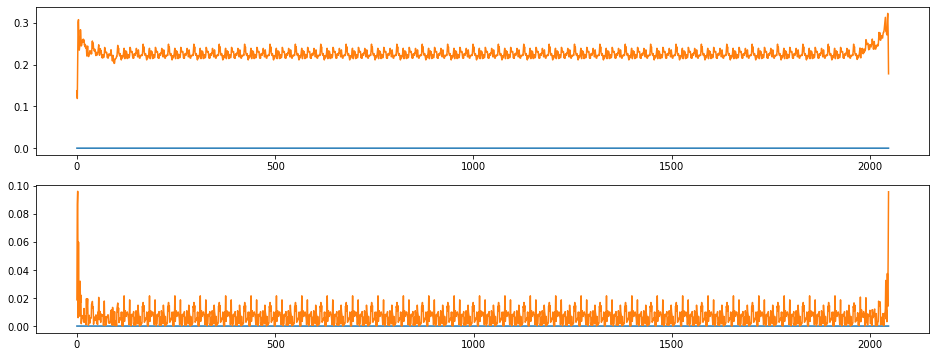

index:  303026
MAE:  0.2261877073760843
n_bunches       648
bunch_index     239
bunch_number     38
Name: 10513, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7444/instability_data/07444_Inst_B1H_Q7_20181115_07h56m14s.h5


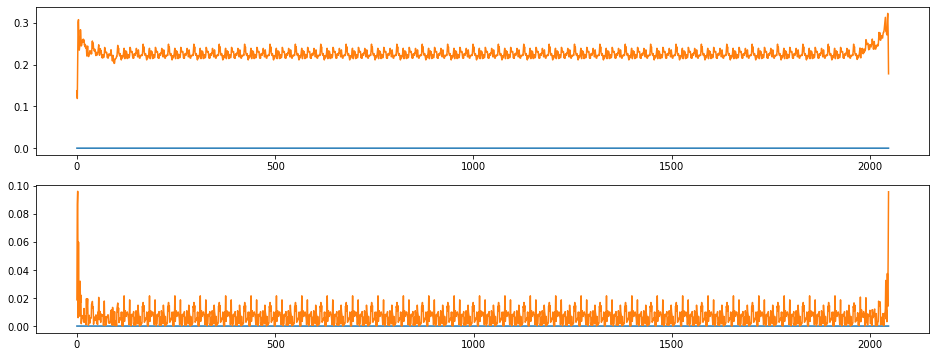

index:  365219
MAE:  0.2261877073760843
n_bunches       376
bunch_index     833
bunch_number    173
Name: 12671, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7468/instability_data/07468_Inst_B1H_Q7_20181123_19h34m32s.h5


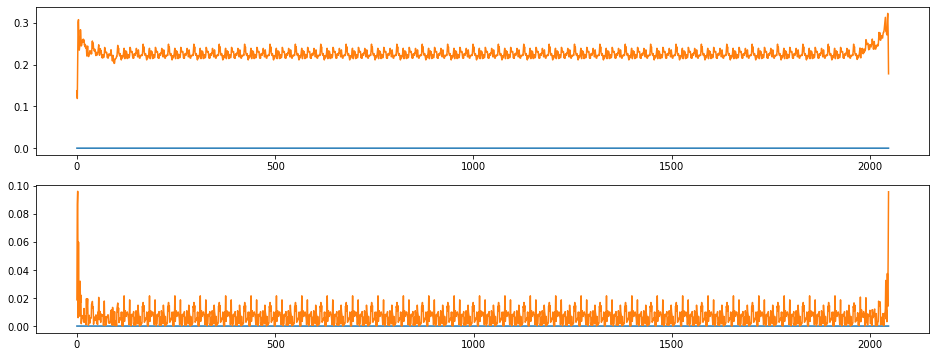

index:  343242
MAE:  0.2261877073760843
n_bunches       1358
bunch_index     2082
bunch_number     778
Name: 11901, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6239/instability_data/06239_Inst_B1H_Q7_20170924_06h23m14s.h5


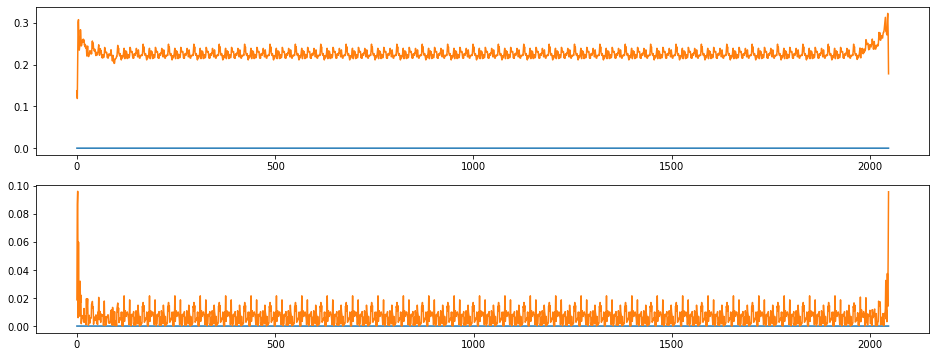

index:  278537
MAE:  0.2261877073760843
n_bunches         88
bunch_index     1967
bunch_number      86
Name: 9667, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7300/instability_data/07300_Inst_B1H_Q7_20181014_09h23m14s.h5


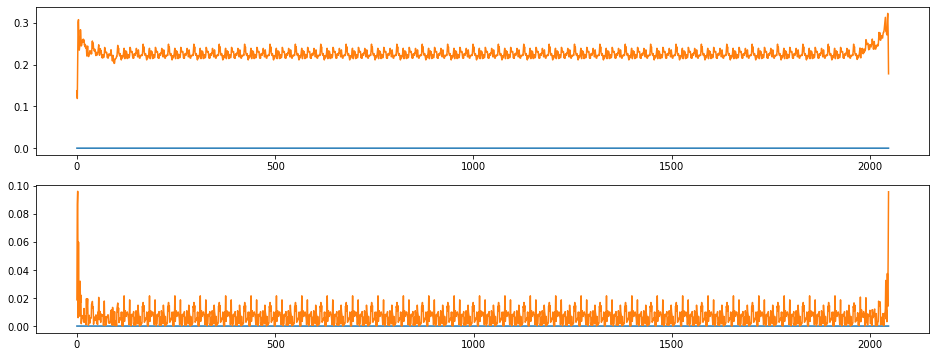

index:  88122
MAE:  0.2261877073760843
n_bunches        456
bunch_index     1411
bunch_number     431
Name: 3045, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7378/instability_data/07378_Inst_B1H_Q7_20181028_22h46m14s.h5


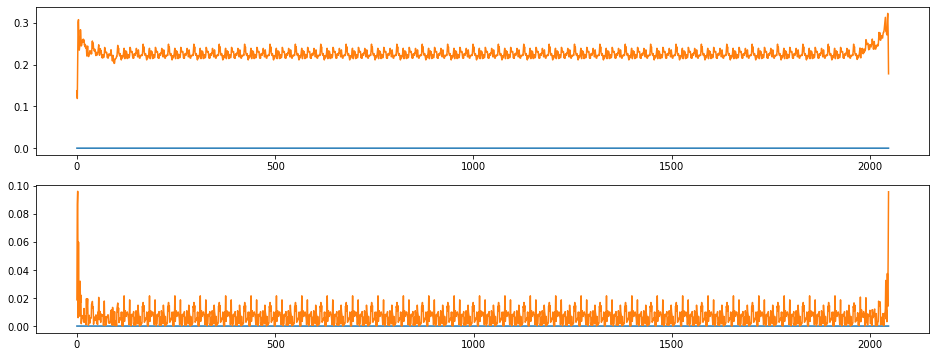

index:  278536
MAE:  0.2261877073760843
n_bunches         88
bunch_index     1967
bunch_number      86
Name: 9667, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7300/instability_data/07300_Inst_B1H_Q7_20181014_09h23m14s.h5


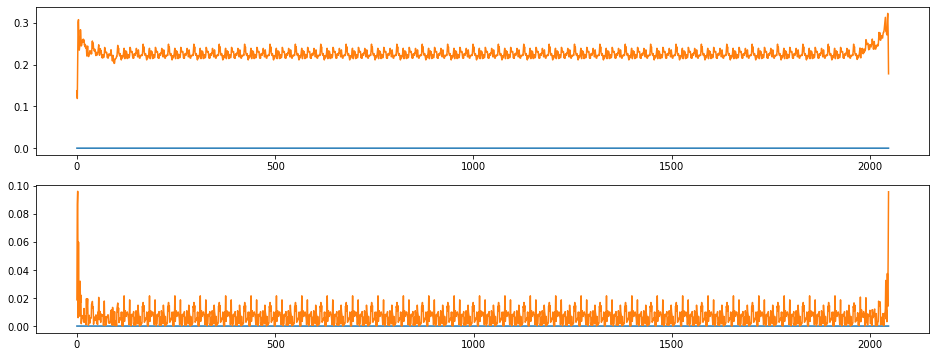

index:  265593
MAE:  0.2261877073760843
n_bunches       140
bunch_index     127
bunch_number     26
Name: 9214, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6395/instability_data/06395_Inst_B1H_Q7_20171116_20h01m35s.h5


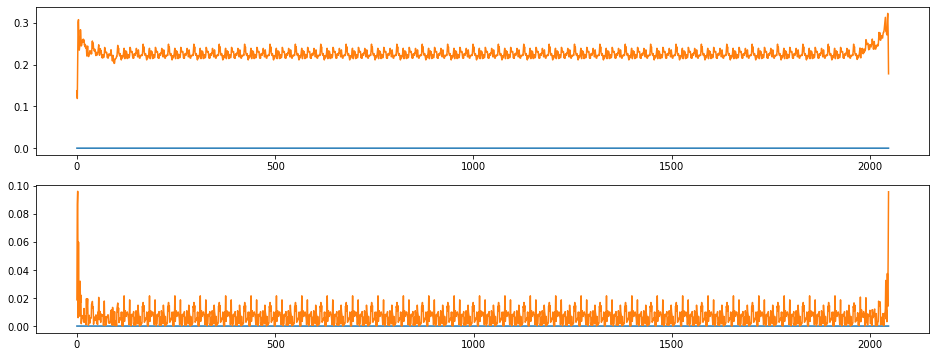

index:  132378
MAE:  0.2261877073760843
n_bunches        796
bunch_index     1168
bunch_number     638
Name: 4572, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6192/instability_data/06192_Inst_B1H_Q7_20170912_17h19m38s.h5


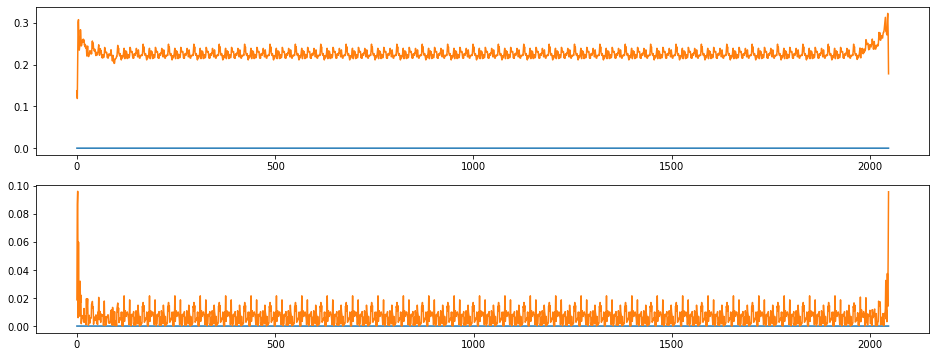

index:  42266
MAE:  0.2261877073760843
n_bunches        733
bunch_index     1257
bunch_number     266
Name: 1451, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


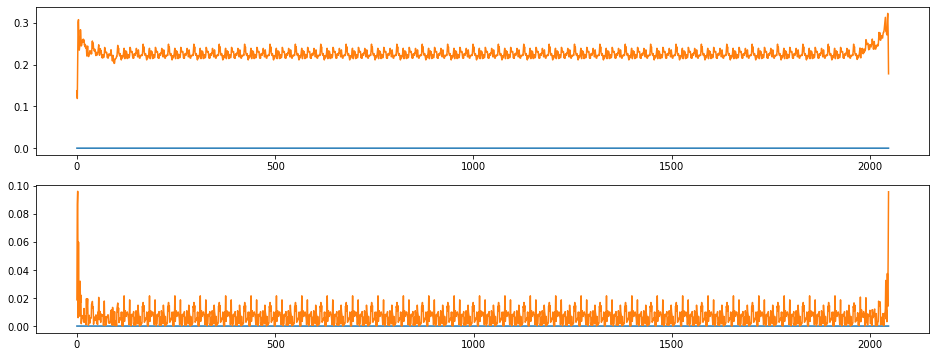

index:  357298
MAE:  0.2261877073760843
n_bunches       1358
bunch_index     3263
bunch_number    1268
Name: 12391, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6239/instability_data/06239_Inst_B1H_Q7_20170924_06h23m14s.h5


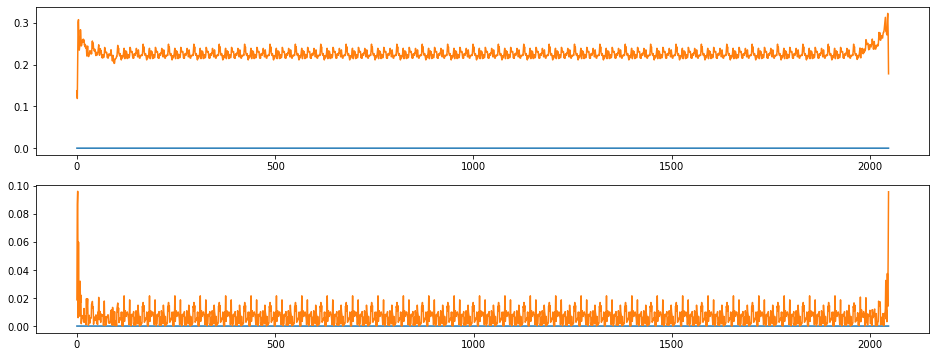

index:  53744
MAE:  0.2261877073760843
n_bunches        733
bunch_index     3188
bunch_number     675
Name: 1860, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


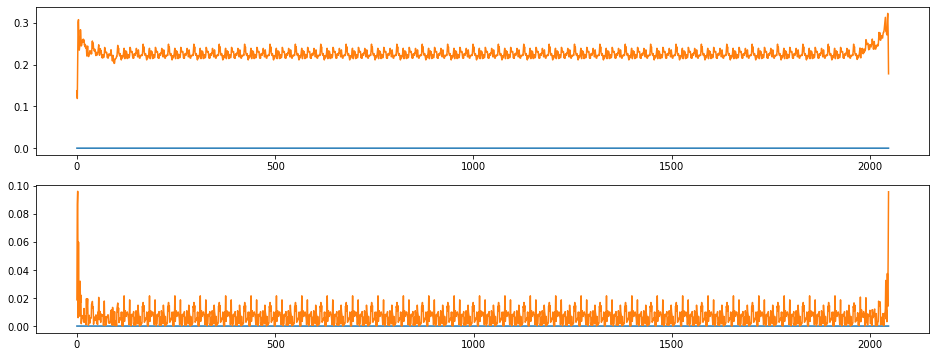

index:  394414
MAE:  0.2261877073760843
n_bunches       396
bunch_index     267
bunch_number    173
Name: 13683, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7122/instability_data/07122_Inst_B1H_Q7_20180903_07h29m11s.h5


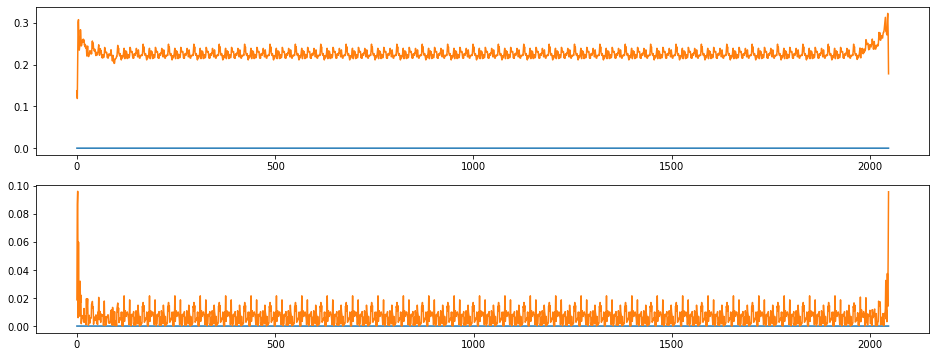

index:  202026
MAE:  0.2261877073760843
n_bunches       1227
bunch_index     2890
bunch_number     992
Name: 6990, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_11h45m14s.h5


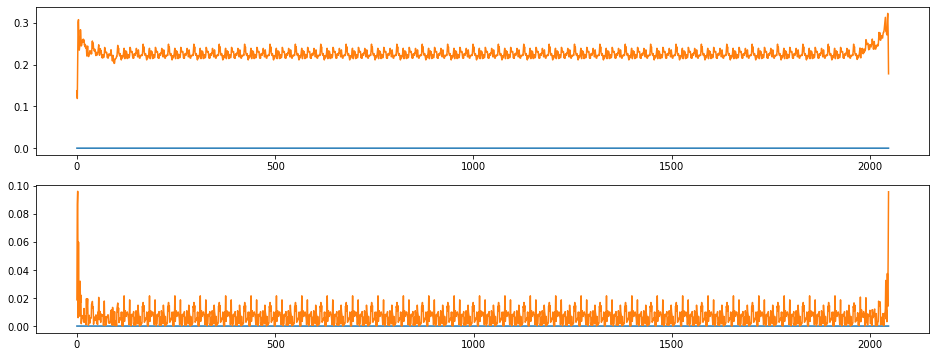

index:  46968
MAE:  0.2261877073760843
n_bunches        733
bunch_index     2052
bunch_number     431
Name: 1616, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


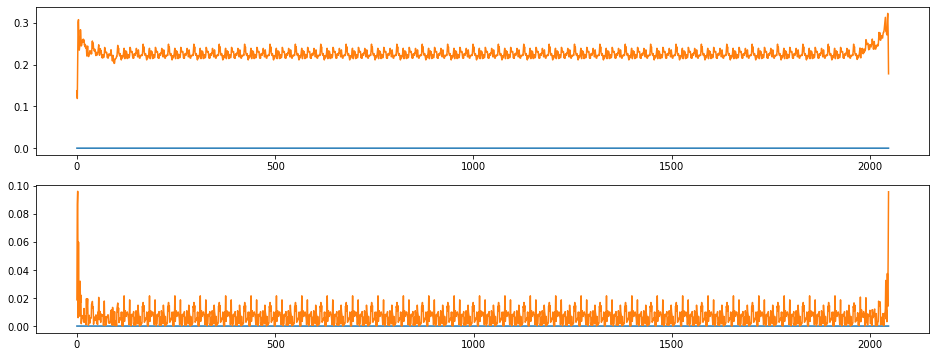

index:  46977
MAE:  0.2261877073760843
n_bunches        733
bunch_index     2055
bunch_number     432
Name: 1617, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


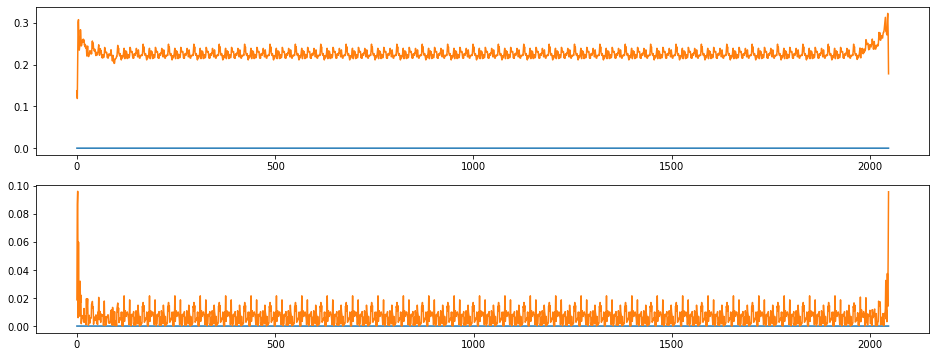

index:  278560
MAE:  0.2261877073760843
n_bunches         88
bunch_index     1988
bunch_number      87
Name: 9668, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7300/instability_data/07300_Inst_B1H_Q7_20181014_09h23m14s.h5


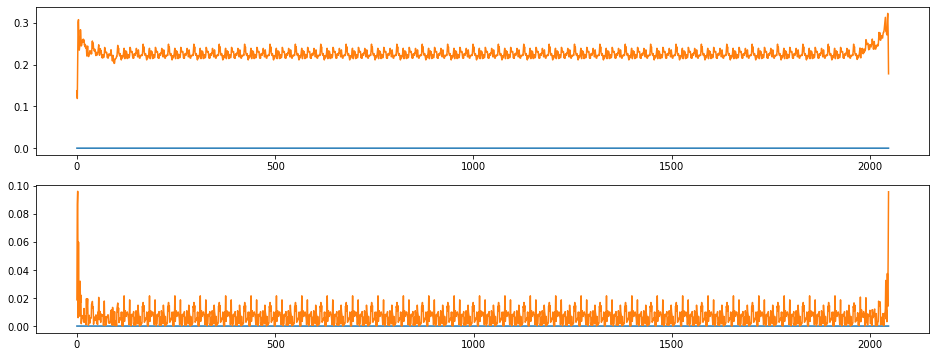

index:  117827
MAE:  0.2261877073760843
n_bunches       796
bunch_index     255
bunch_number    131
Name: 4065, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6192/instability_data/06192_Inst_B1H_Q7_20170912_17h19m38s.h5


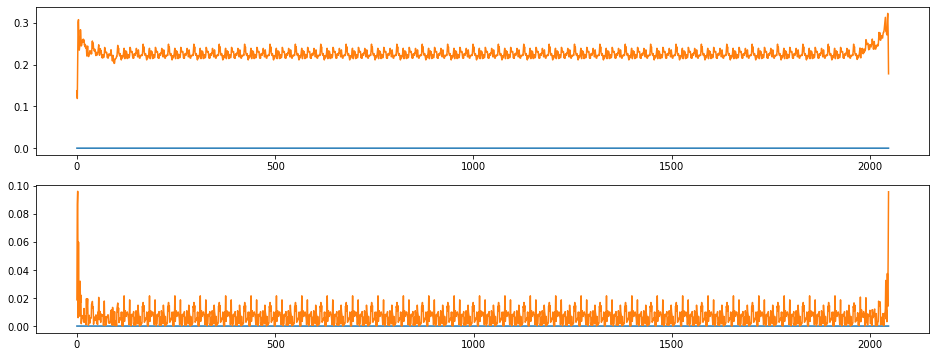

index:  132502
MAE:  0.2261877073760843
n_bunches        796
bunch_index     1173
bunch_number     643
Name: 4577, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6192/instability_data/06192_Inst_B1H_Q7_20170912_17h19m38s.h5


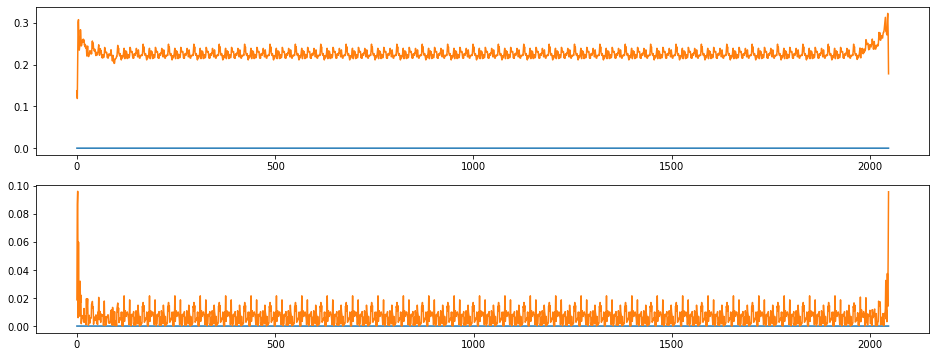

index:  51746
MAE:  0.2261877073760843
n_bunches        733
bunch_index     2848
bunch_number     603
Name: 1788, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


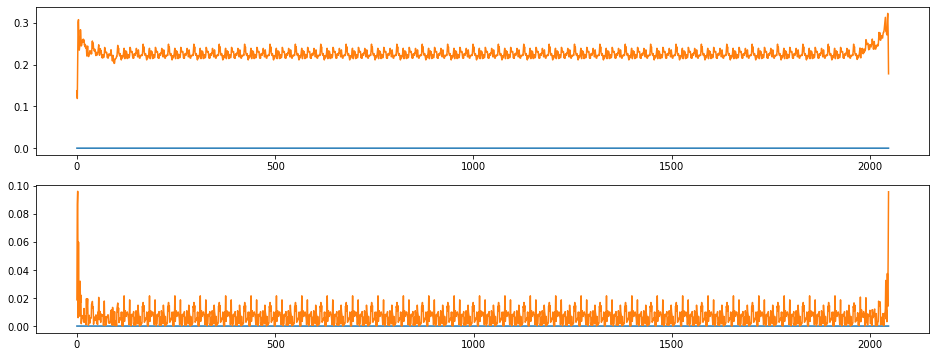

index:  177563
MAE:  0.2261877073760843
n_bunches       1227
bunch_index      278
bunch_number     140
Name: 6138, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_11h45m14s.h5


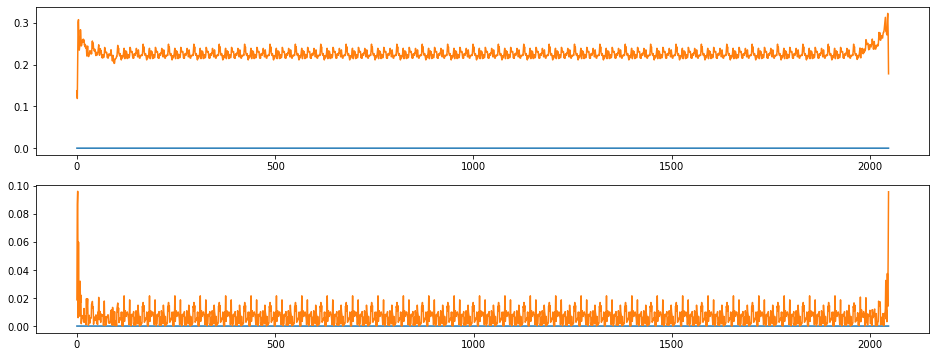

index:  61667
MAE:  0.2261877073760843
n_bunches       444
bunch_index     444
bunch_number    209
Name: 2127, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6990/instability_data/06990_Inst_B1H_Q7_20180727_09h47m15s.h5


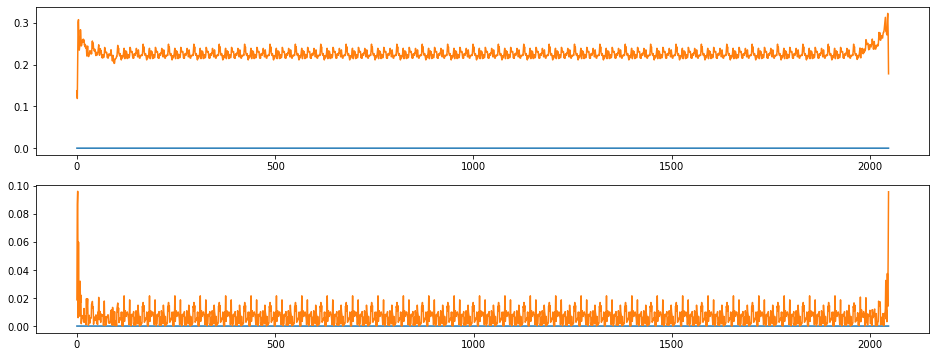

index:  13855
MAE:  0.2261877073760843
n_bunches       972
bunch_index     506
bunch_number    263
Name: 476, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6272/instability_data/06272_Inst_B1H_Q7_20171005_01h30m07s.h5


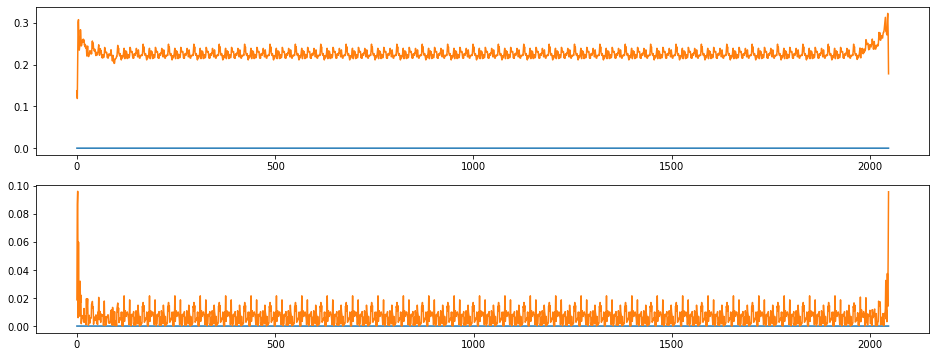

index:  396234
MAE:  0.2261877073760843
n_bunches       396
bunch_index     334
bunch_number    233
Name: 13743, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7122/instability_data/07122_Inst_B1H_Q7_20180903_07h29m11s.h5


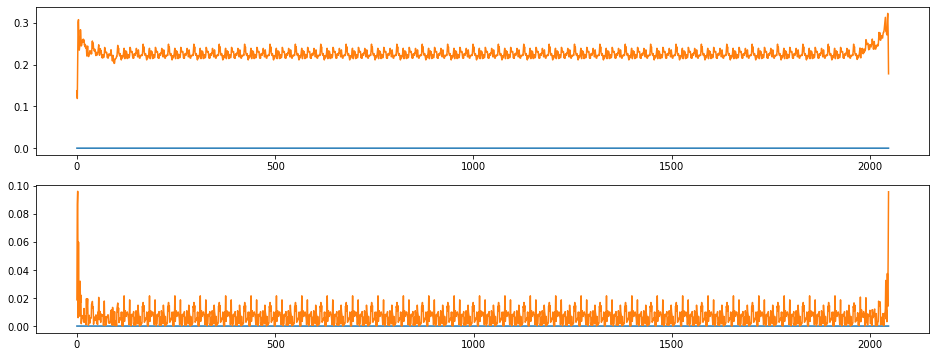

index:  88167
MAE:  0.2261877073760843
n_bunches        456
bunch_index     1414
bunch_number     434
Name: 3048, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7378/instability_data/07378_Inst_B1H_Q7_20181028_22h46m14s.h5


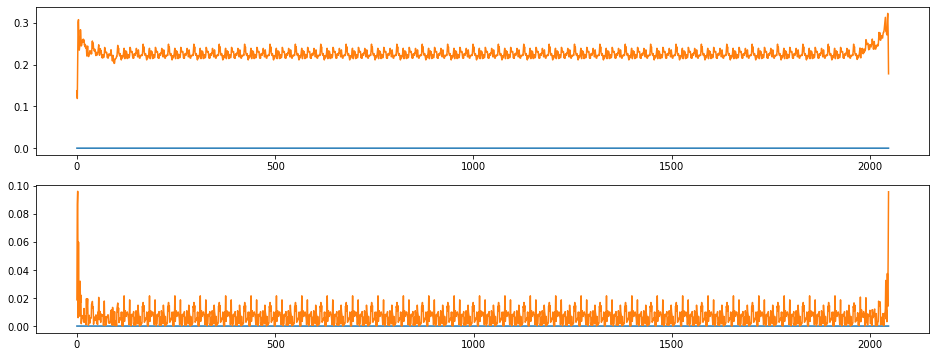

index:  215864
MAE:  0.2261877073760843
n_bunches       987
bunch_index     583
bunch_number    235
Name: 7463, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6706/instability_data/06706_Inst_B1H_Q7_20180520_12h23m14s.h5


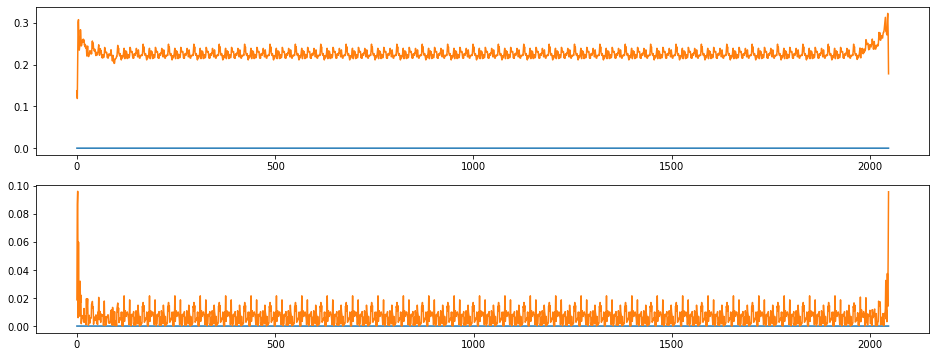

index:  202121
MAE:  0.2261877073760843
n_bunches       1227
bunch_index     2894
bunch_number     996
Name: 6994, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_11h45m14s.h5


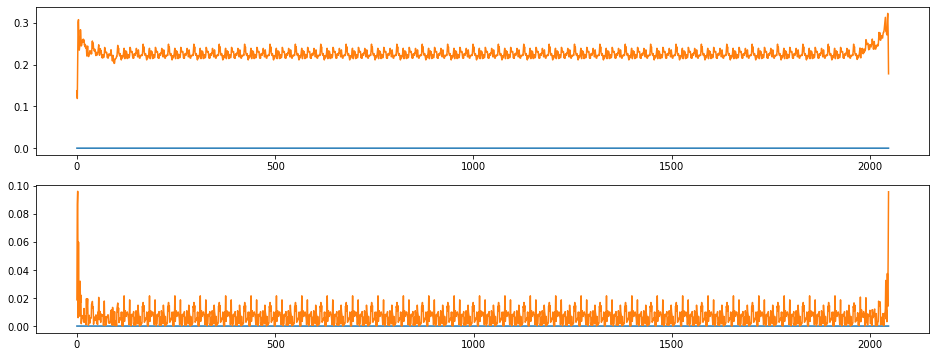

index:  96097
MAE:  0.2261877073760843
n_bunches        418
bunch_index     1188
bunch_number     249
Name: 3319, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7481/instability_data/07481_Inst_B1H_Q7_20181128_09h48m56s.h5


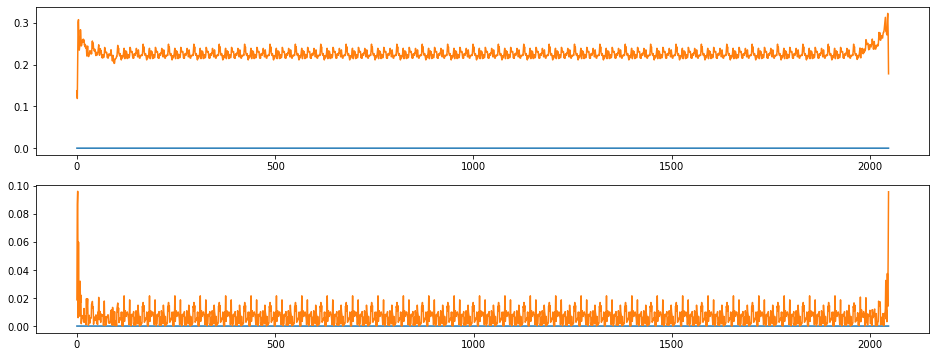

index:  91289
MAE:  0.2261877073760843
n_bunches       418
bunch_index     419
bunch_number     84
Name: 3154, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7481/instability_data/07481_Inst_B1H_Q7_20181128_09h48m56s.h5


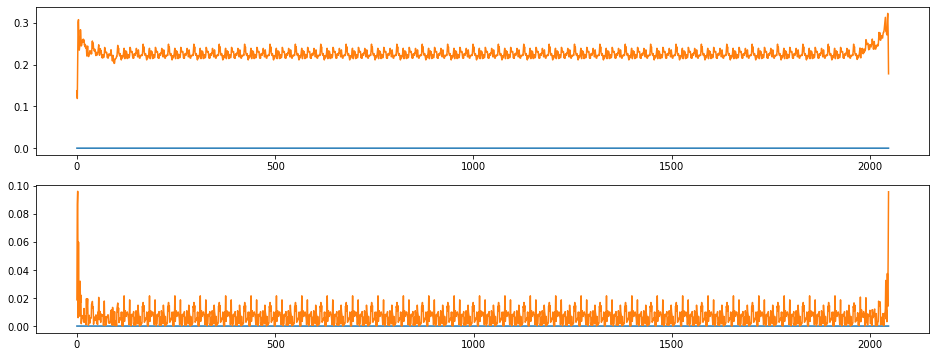

index:  215850
MAE:  0.2261877073760843
n_bunches       987
bunch_index     583
bunch_number    235
Name: 7463, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6706/instability_data/06706_Inst_B1H_Q7_20180520_12h23m14s.h5


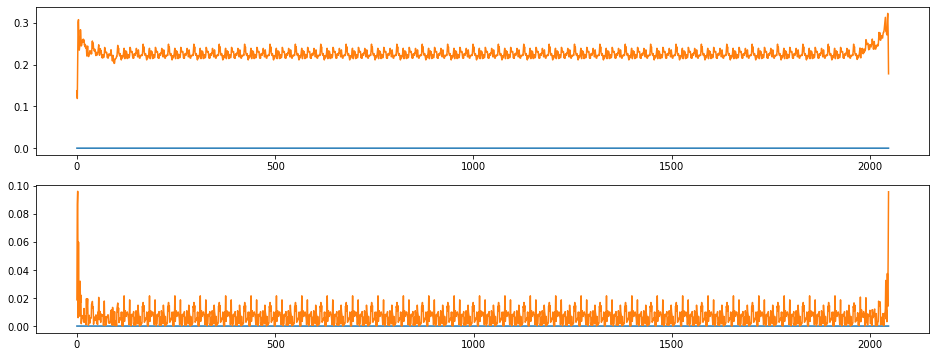

In [21]:
for i in range(1, 101):
    left_most = -i
    left_most_index = max_MAE_indices[left_most]

    print('index: ', left_most_index)
    print("MAE: ", MAE_train[left_most_index])
    # I'm not sure this row is correct
    metadata_row = train_generator.metadata.iloc[left_most_index // 32]
    print(metadata_row[['n_bunches', 'bunch_index', 'bunch_number']])
    print(metadata_row['file'])


    true_signal = train_dataset[left_most_index].squeeze()
    pred_signal = train_pred[left_most_index].squeeze()

    plot_true_pred(true_signal, pred_signal)
    plt.show()

# Signals around the peak

In [22]:
around_peak_indices = np.argsort(np.abs(MAE_train - hist_peak_train))

index:  17935
MAE:  0.3984109969306443
n_bunches       972
bunch_index     786
bunch_number    403
Name: 616, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6272/instability_data/06272_Inst_B1H_Q7_20171005_01h30m07s.h5


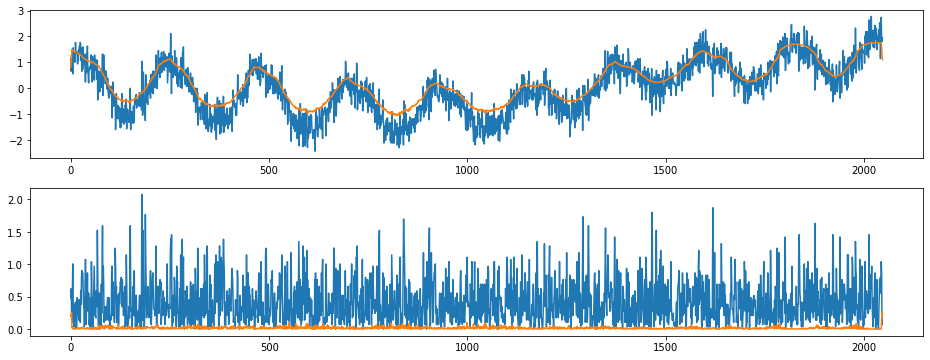

index:  89603
MAE:  0.3984102872689874
n_bunches       418
bunch_index     136
bunch_number     26
Name: 3096, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7481/instability_data/07481_Inst_B1H_Q7_20181128_09h48m56s.h5


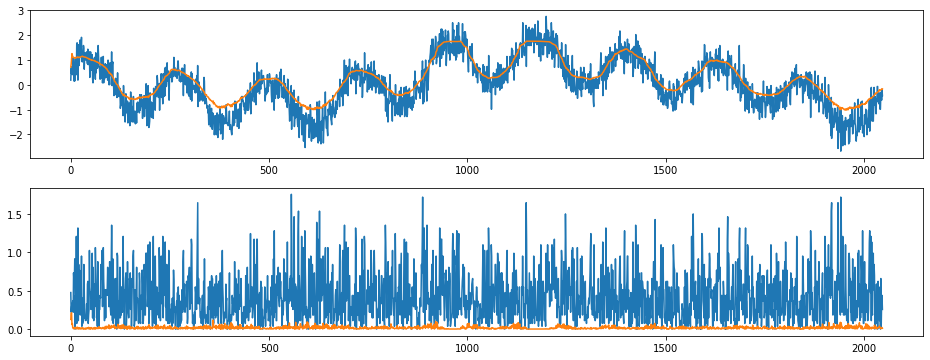

index:  158712
MAE:  0.3984096624385009
n_bunches       684
bunch_index     315
bunch_number    171
Name: 5485, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6247/instability_data/06247_Inst_B1H_Q7_20170927_07h40m43s.h5


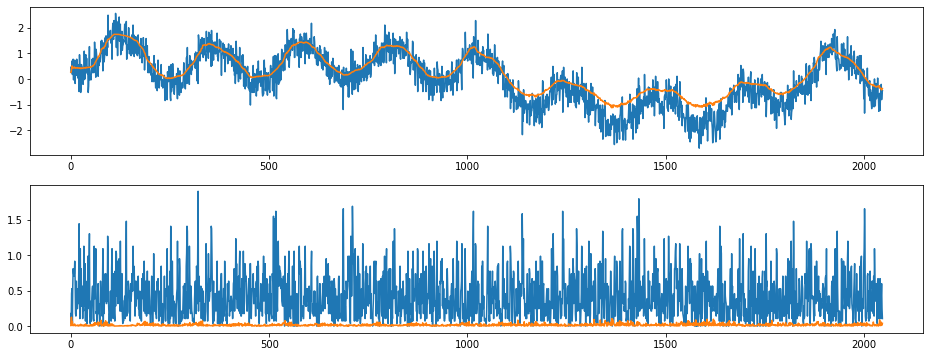

index:  231746
MAE:  0.3984096460663883
n_bunches        987
bunch_index     2922
bunch_number     804
Name: 8032, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6706/instability_data/06706_Inst_B1H_Q7_20180520_12h23m14s.h5


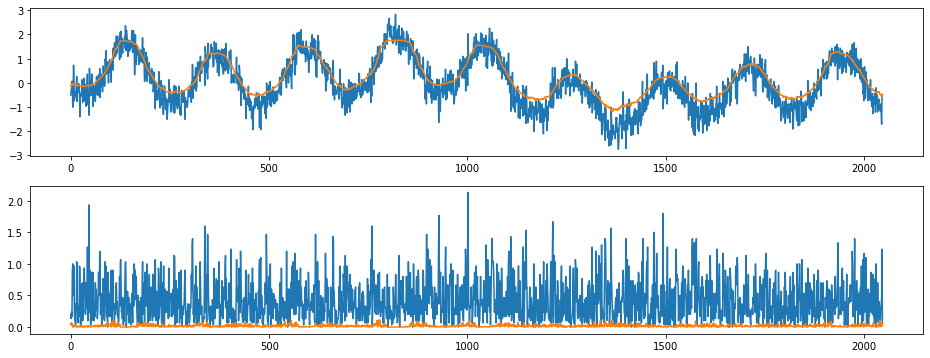

index:  232495
MAE:  0.3984123404204019
n_bunches        987
bunch_index     2948
bunch_number     830
Name: 8058, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6706/instability_data/06706_Inst_B1H_Q7_20180520_12h23m14s.h5


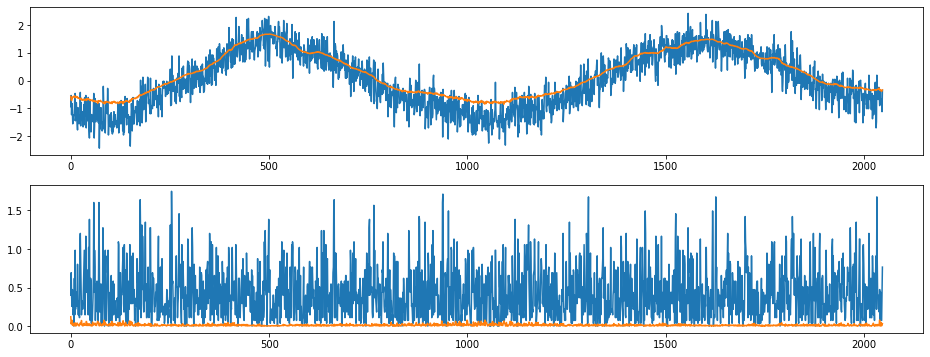

index:  397431
MAE:  0.3984085972213585
n_bunches       396
bunch_index     404
bunch_number    272
Name: 13782, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7122/instability_data/07122_Inst_B1H_Q7_20180903_07h29m11s.h5


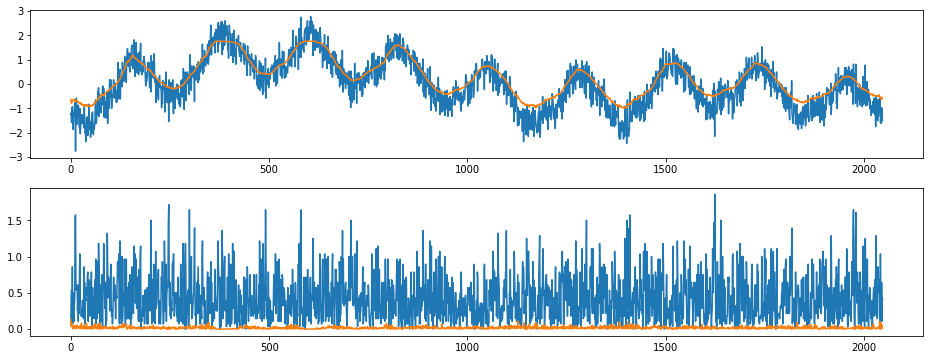

index:  326514
MAE:  0.39840796157206154
n_bunches       1358
bunch_index      478
bunch_number     207
Name: 11330, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6239/instability_data/06239_Inst_B1H_Q7_20170924_06h23m14s.h5


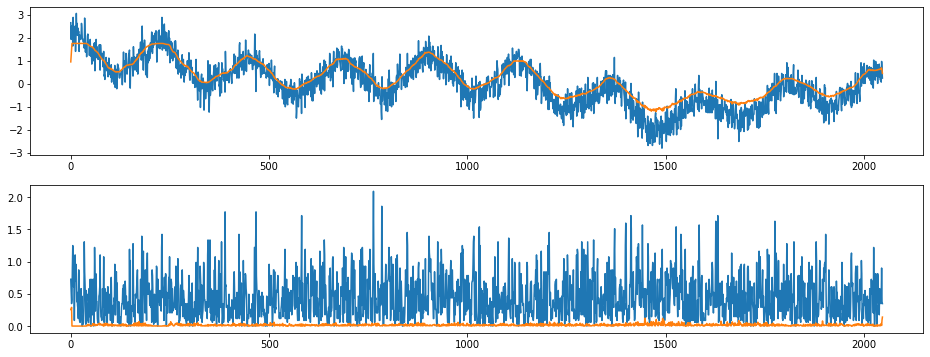

index:  203531
MAE:  0.39841415743287956
n_bunches       1227
bunch_index     2950
bunch_number    1045
Name: 7043, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_11h45m14s.h5


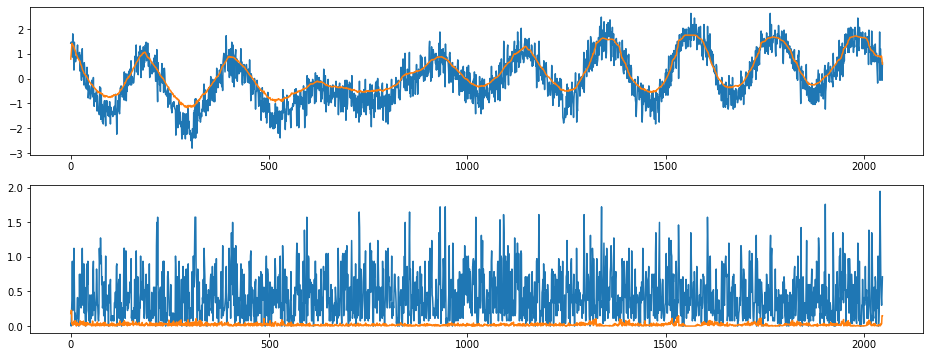

index:  86380
MAE:  0.3984075631226345
n_bunches        456
bunch_index     1341
bunch_number     368
Name: 2982, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7378/instability_data/07378_Inst_B1H_Q7_20181028_22h46m14s.h5


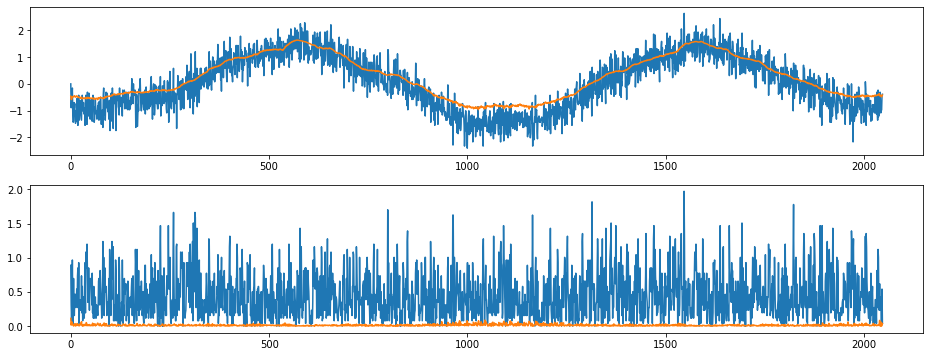

index:  289232
MAE:  0.398414385922309
n_bunches        648
bunch_index     1969
bunch_number     368
Name: 10037, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7446/instability_data/07446_Inst_B1H_Q7_20181116_02h46m18s.h5


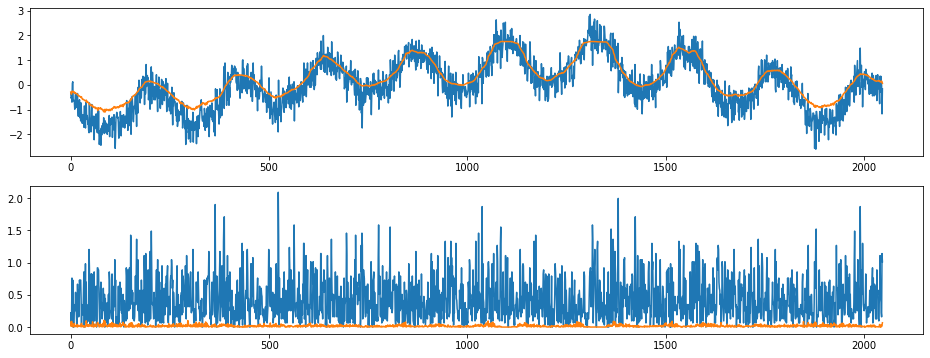

In [23]:
for i in range(10):
    around_peak_index = around_peak_indices[i]

    print('index: ', around_peak_index)
    print("MAE: ", MAE_train[around_peak_index])
    # I'm not sure this row is correct
    metadata_row = train_generator.metadata.iloc[around_peak_index // 32]
    print(metadata_row[['n_bunches', 'bunch_index', 'bunch_number']])
    print(metadata_row['file'])

    true_signal = train_dataset[around_peak_index].squeeze()
    pred_signal = train_pred[around_peak_index].squeeze()

    plot_true_pred(true_signal, pred_signal)
    plt.show()

# around a point

In [26]:
around_point_indices = np.argsort(np.abs(MAE_train - 0.27))

index:  84400
MAE:  0.26993071857050743
n_bunches        456
bunch_index     1234
bunch_number     299
Name: 2913, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7378/instability_data/07378_Inst_B1H_Q7_20181028_22h46m14s.h5


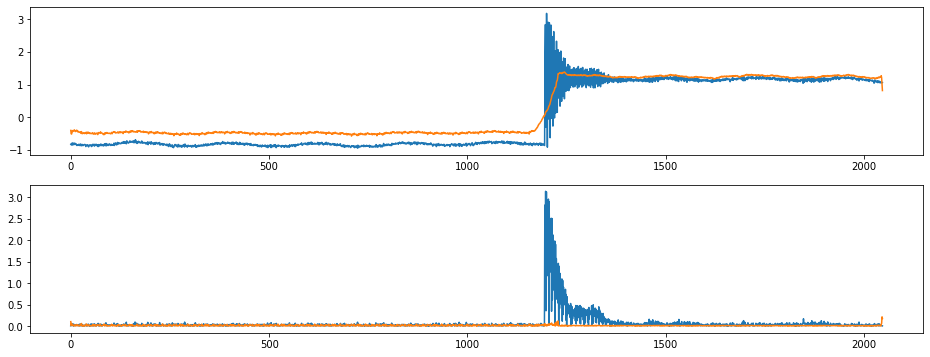

index:  290889
MAE:  0.27008249962304726
n_bunches        648
bunch_index     2281
bunch_number     426
Name: 10095, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7446/instability_data/07446_Inst_B1H_Q7_20181116_02h46m18s.h5


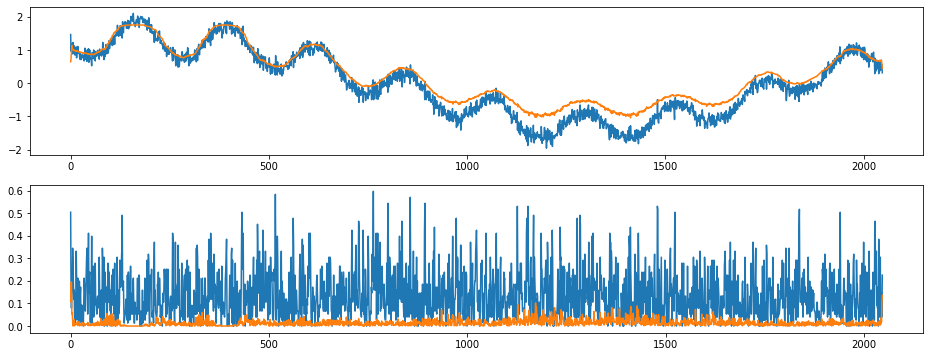

index:  205927
MAE:  0.2701499627968802
n_bunches       1227
bunch_index     3170
bunch_number    1129
Name: 7127, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6690/instability_data/06690_Inst_B1H_Q7_20180516_11h45m14s.h5


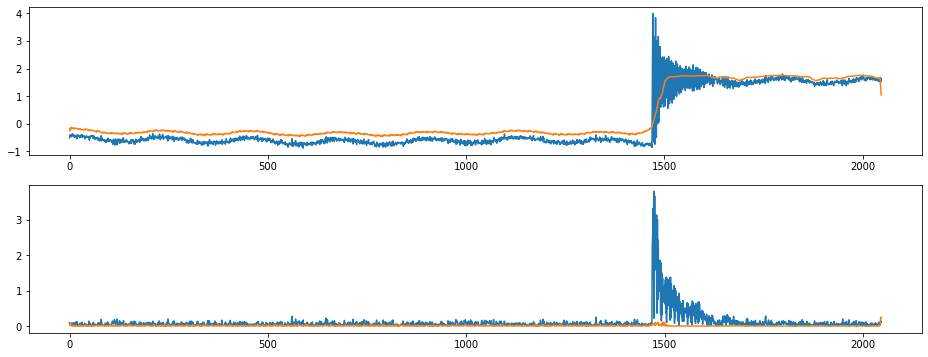

index:  85249
MAE:  0.2701615570201461
n_bunches        456
bunch_index     1295
bunch_number     329
Name: 2943, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7378/instability_data/07378_Inst_B1H_Q7_20181028_22h46m14s.h5


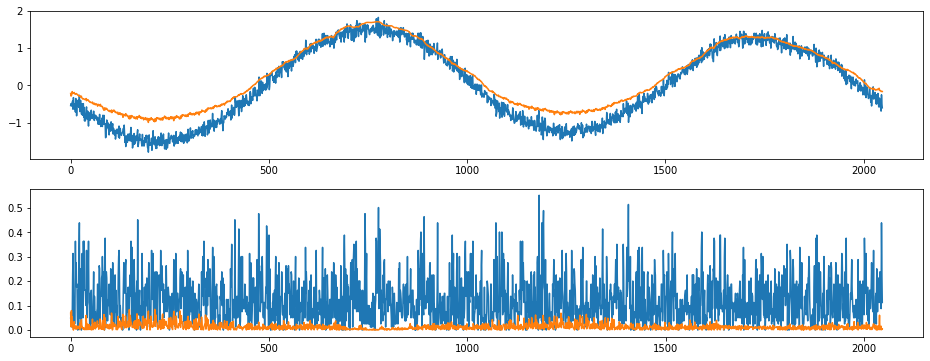

index:  107796
MAE:  0.2702103842337987
n_bunches       324
bunch_index     463
bunch_number    106
Name: 3716, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7229/instability_data/07229_Inst_B1H_Q7_20180928_08h38m14s.h5


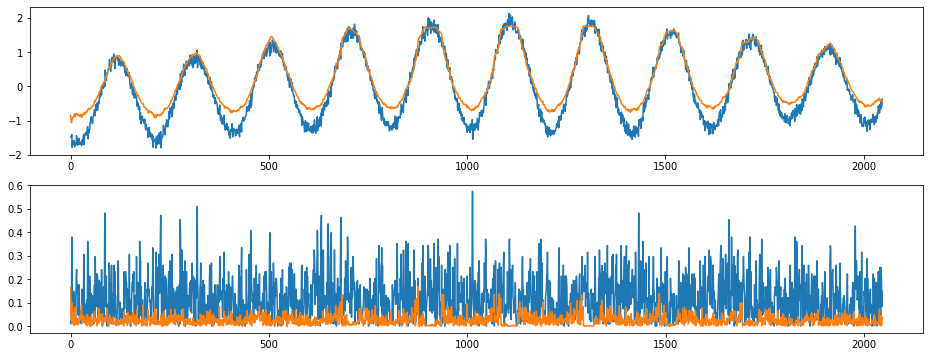

index:  39609
MAE:  0.27023463299692596
n_bunches       733
bunch_index     845
bunch_number    176
Name: 1361, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7486/instability_data/07486_Inst_B1H_Q7_20181130_09h54m15s.h5


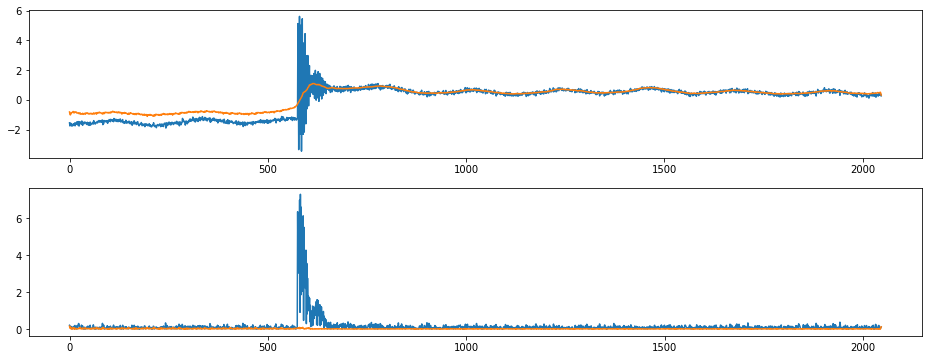

index:  210015
MAE:  0.2702668579582663
n_bunches       987
bunch_index     203
bunch_number     39
Name: 7267, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6706/instability_data/06706_Inst_B1H_Q7_20180520_12h23m14s.h5


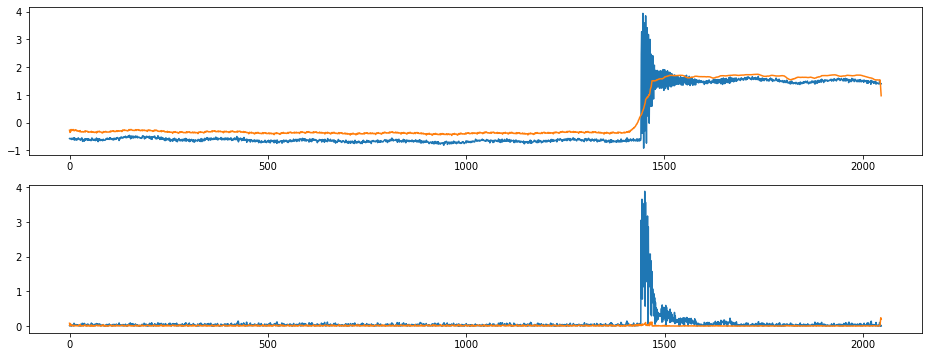

index:  298340
MAE:  0.2697286897287912
n_bunches       158
bunch_index     645
bunch_number     31
Name: 10348, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7343/instability_data/07343_Inst_B1H_Q7_20181025_05h31m18s.h5


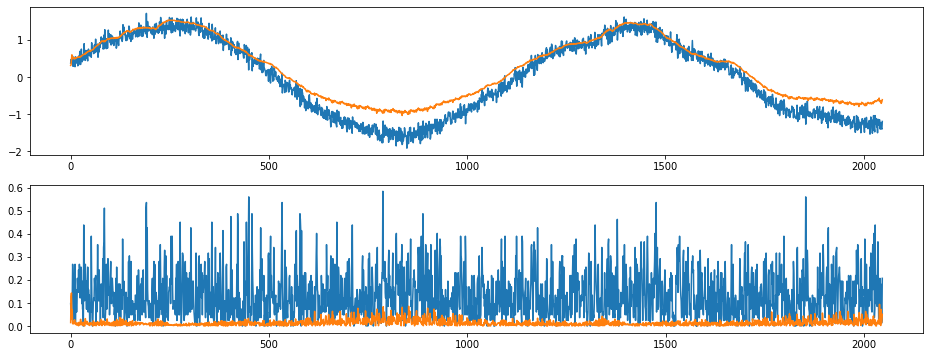

index:  170143
MAE:  0.2697048985750328
n_bunches        684
bunch_index     1031
bunch_number     567
Name: 5881, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/6247/instability_data/06247_Inst_B1H_Q7_20170927_07h40m43s.h5


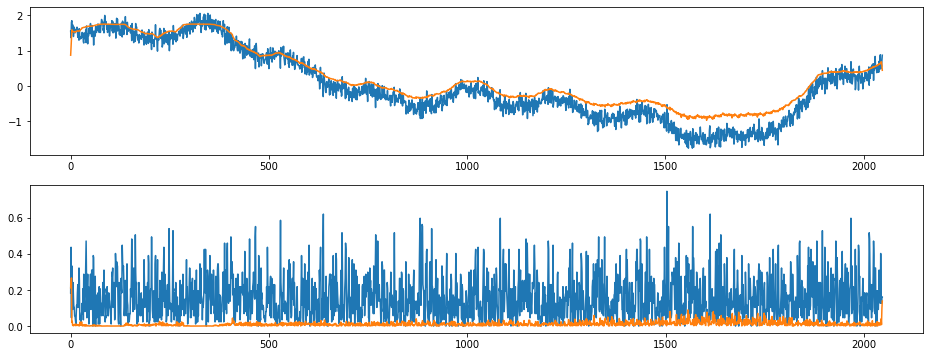

index:  280893
MAE:  0.269594544918113
n_bunches       648
bunch_index     449
bunch_number     79
Name: 9748, dtype: object
/nfs/cs-ccr-adtobsnfs/lhc_adtobsbox_data/7446/instability_data/07446_Inst_B1H_Q7_20181116_02h46m18s.h5


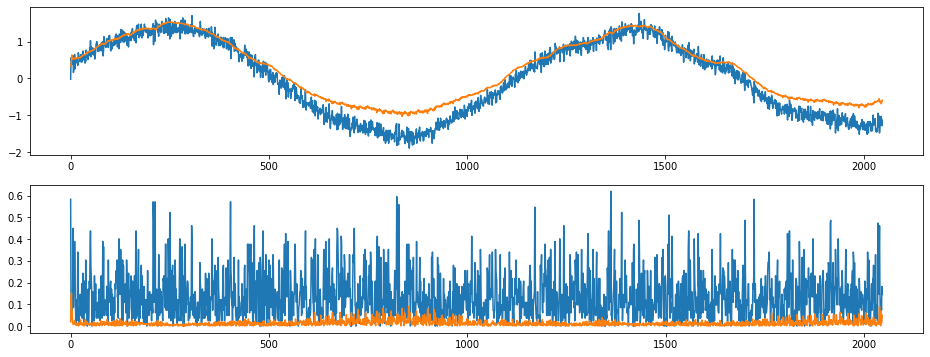

In [27]:
for i in range(10):
    around_point_index = around_point_indices[i]

    print('index: ', around_point_index)
    print("MAE: ", MAE_train[around_point_index])
    # I'm not sure this row is correct
    metadata_row = train_generator.metadata.iloc[around_point_index // 32]
    print(metadata_row[['n_bunches', 'bunch_index', 'bunch_number']])
    print(metadata_row['file'])

    true_signal = train_dataset[around_point_index].squeeze()
    pred_signal = train_pred[around_point_index].squeeze()

    plot_true_pred(true_signal, pred_signal)
    plt.show()